## 작업환경 설정
* 모듈설정
* 변수설정
* 함수설정

### 모듈설정

In [1]:
!pip install pandas
!pip install matplotlib
!pip install seaborn
!pip install sklearn
!pip install xlrd

In [2]:
import warnings
warnings.filterwarnings(action='ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
import os, random, datetime, time
import seaborn as sns

from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler

from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
#기본 모듈 설정

plt.style.use('fivethirtyeight')
font_path = "./font/nanum.TTF"

from matplotlib import font_manager, rc
font_name = font_manager.FontProperties(fname=font_path).get_name()
rc('font', family=font_name)
import matplotlib
matplotlib.rcParams['axes.unicode_minus'] = False

sns.set(font=font_name,
        rc={"axes.unicode_minus":False})
rc('xtick', labelsize = 8)
#그래프 한글 허용 및 기본 설정

plt.rcParams['font.family'] = 'STIXSizeTwoSym'
plt.rc('axes', unicode_minus=False) # 마이너스 폰트 설정

# 글씨 선명하게 출력하는 설정
%config InlineBackend.figure_format = 'retina'

pd.set_option('display.max_row', 500)

### 변수설정

In [3]:
Mcop_dic = {}
m_path = './sample/Mcorporation/상품 카테고리 데이터_KDX 시각화 경진대회 Only/'
Mcop_data_list = os.listdir(m_path)
Mcop_data_list = list(map(lambda i : i[:-5], Mcop_data_list))

for i in Mcop_data_list :
    print('\r', round(Mcop_data_list.index(i)/ len(Mcop_data_list) * 100, 2), '%', end = '')
    Mcop_dic[i] = pd.read_excel(m_path + i + '.xlsx')
print('\r', 100, '%', end = '')
ori_mcop = pd.concat([Mcop_dic[i] for i in Mcop_data_list[1:]])
del Mcop_dic; del Mcop_data_list;

ori_mcop = ori_mcop[~(ori_mcop['고객나이'] < 0)]
ori_mcop = ori_mcop[~(ori_mcop['구매금액'] < 0)]
ori_mcop['고객나이'] = ori_mcop['고객나이'].apply(lambda i : 60 if i > 60 else i)
ori_mcop = ori_mcop.groupby(['구매날짜', '카테고리명', '고객성별', '고객나이', 'OS유형'], as_index = False).sum().copy()

if not os.path.exists('./data'):
    os.makedirs('./data')
ori_mcop.to_csv('./data/M_corper.csv')

print('\rM_Corper 설정 완료', end = '')

M_Corper 설정 완료

In [4]:
samsung = pd.read_excel('./sample/Samsungcard.xlsx')
shinhan = pd.read_excel('./sample/Shinhancard.xlsx')

samsung['성별'] = samsung['성별'].apply(lambda x : 1 if x == '남성' else 0).copy()
samsung['연령대'] = samsung['연령대'].apply(lambda x : int(x[:2]))
samsung['소비건수'] = round(samsung['소비건수'] / 1000, 1)
samsung.columns = list(samsung.columns[:-1]) + ['소비건수(삼성)']

shinhan.columns = ['소비일자', '성별', '연령대', '소비업종', '소비건수(신한)',1, 2, 3]
shinhan = shinhan.drop([1,2,3], axis = 'columns').copy()
shinhan['성별'] = shinhan['성별'].apply(lambda x : 1 if x == 'M' else 0).copy()
shinhan['연령대'] = shinhan['연령대'].apply(lambda x : int(x[:2])).copy()
shinhan['연령대'] = shinhan['연령대'].apply(lambda x : 60 if x > 60 else x).copy()

cat_dic = {'M001_한식': '요식/유흥',
           'M002_일식/중식/양식': '요식/유흥',
           'M003_제과/커피/패스트푸드': '요식/유흥',
           'M004_기타요식': '요식/유흥',
           'M005_유흥': '요식/유흥',
           'M006_백화점': '백화점/상품권/아울렛',
           'M007_할인점/슈퍼마켓': '할인점/마트',
           'M008_편의점': '편의점',
           'M009_기타유통': '가정생활/서비스',
           'M010_음/식료품': '할인점/마트',
           'M011_의복/의류': '패션/잡화',
           'M012_패션/잡화': '패션/잡화',
           'M013_스포츠/문화/레저': '스포츠/문화/레저',
           'M014_스포츠/문화/레저용품': '스포츠/문화/레저',
           'M015_숙박': '여행/교통',
           'M016_여행': '여행/교통',
           'M017_미용서비스': '미용',
           'M018_화장품': '미용',
           'M019_서비스': '가정생활/서비스',
           'M020_인테리어': '가정생활/서비스',
           'M021_학원': '교육/학원',
           'M022_유아교육': '교육/학원',
           'M023_교육용품': '교육/학원',
           'M024_병원': '의료',
           'M025_약국': '의료',
           'M026_기타의료': '의료',
           'M027_가전/가구': '가전/가구',
           'M028_자동차판매': '자동차',
           'M029_자동차서비스/용품': '자동차',
           'M030_주유': '주유'}

shinhan['소비업종'] = shinhan['소비업종'].apply(lambda x : cat_dic[x]).copy()
shinhan = shinhan.groupby(['소비일자', '성별', '연령대', '소비업종']).sum().copy()

ori_card = pd.merge(samsung, shinhan,
                    how = 'left', on = list(samsung.columns[:-1])).copy()
ori_card.to_csv('./data/Card.csv')

In [5]:
ori_gin_price = pd.read_csv('./sample/GIN00009A.csv')
ori_gin_trade = pd.read_csv('./sample/GIN00008A.csv')
ori_gin_loc = pd.read_json('./sample/center_GIN00010M.json')
ori_mbn = pd.read_excel('./sample/mk_news_201901_202006.xlsx')

ori_gin_price['ym'] = ori_gin_price['std_date'].apply(lambda x : int(str(x)[:7].replace('-', '')))
ori_gin_price = ori_gin_price.groupby(['lgdng_cd', 'ym']).mean().reset_index().copy()
ori_gin = pd.merge(ori_gin_price, ori_gin_trade, how = 'left', on = ['ym', 'lgdng_cd']).copy()
    
#결측치 제거 및 병합

Card = ori_card.copy()
Gin_price = ori_gin_price.copy()
Gin_trade_vol = ori_gin_trade.copy()
Gin_loc = ori_gin_loc.copy()
Gin = ori_gin.copy()
Mbn_news = ori_mbn.copy()
M_corper = ori_mcop.copy()
cat_list = M_corper['카테고리명'].unique().tolist()

def drawGraph(ind, age) :
    if type(ind) == int : temp_df = M_corper[M_corper['카테고리명'] == cat_list[ind]].copy()
    else : temp_df = M_corper[M_corper['카테고리명'] == ind].copy()
    x = temp_df['구매날짜'].drop_duplicates().tolist()
    amount_y = []
    num_y = []
    for i in x :
        temp_df1 = temp_df[(temp_df['구매날짜'] == i) & (temp_df['고객나이'] == age)]
        amount_y.append(sum(temp_df1['구매금액']))
        num_y.append(sum(temp_df1['구매수']))
        
    color = ['blue', 'red', 'yellow', 'black']
    x = list(map(str, x))
    
    f,ax=plt.subplots(2,1,figsize=(40,80))
    ax[0].plot(x, amount_y, linewidth = 3, color=color[1])
    ax[0].tick_params(axis='x', labelrotation=90)
    ax[0].xaxis.set_major_locator(plt.MultipleLocator(5))
    ax[0].set_title('구매금액')
    ax[1].plot(x, num_y, linewidth = 3, color=color[0])
    ax[1].tick_params(axis='x', labelrotation=90)
    ax[1].set_title('구매수')
    ax[1].xaxis.set_major_locator(plt.MultipleLocator(5))
    
    plt.show()

#Mcop 그래프 그리는 함수

print('\r-- 기본 세팅 완료 --')

-- 기본 세팅 완료 --


### 함수설정
* 값의 차이가 많이 나기 때문에 정규화

In [6]:
def score_normalize(lst):
    normalized=[]
    scaler = MinMaxScaler()
    normalized=scaler.fit_transform(lst)
    
    return normalized

def save_corr(k):
    for i in range(len(k)):
        plt.figure(figsize=(20,10))
        print(spe_list[i])
        before_card_all=card_all[(card_all['일자']<2020010)&(card_all['일자']>=2019070)]
        before_card_gp=card_gp[(card_gp['일자']<2020010)&(card_gp['일자']>=2019070)]
        all_before=before_card_all[before_card_all['업종']==spe_list[i]]
        all_before['건수_정규화']=score_normalize(np.array(before_card_all[before_card_all['업종']==spe_list[i]]['건수']).reshape(-1,1))
        for j in age_list:
            all_before[str(j)+'_정규화']=score_normalize(np.array(before_card_gp[(before_card_gp['연령']==j)&(before_card_gp['업종']==spe_list[i])]['건수']).reshape(-1,1))
        set_all_before=all_before[['건수_정규화','20_정규화','30_정규화','40_정규화','50_정규화','60_정규화']]
        mask = np.triu(np.ones_like(set_all_before.corr(), dtype=np.bool))

        plt.subplot(1,2,1)
        plt.title(spe_list[i]+' 코로나 전')
        sns.heatmap(set_all_before.corr(), annot=True, cmap="Blues", mask=mask)

        after_card_all=card_all[(card_all['일자']>=2020010)]
        after_card_gp=card_gp[(card_gp['일자']>=2020010)]
        all_after=after_card_all[after_card_all['업종']==spe_list[i]]
        all_after['건수_정규화']=score_normalize(np.array(after_card_all[after_card_all['업종']==spe_list[i]]['건수']).reshape(-1,1))
        for k in age_list:
            all_after[str(k)+'_정규화']=score_normalize(np.array(after_card_gp[(after_card_gp['연령']==k)&(after_card_gp['업종']==spe_list[i])]['건수']).reshape(-1,1))
        select_all_after=all_after[['건수_정규화','20_정규화','30_정규화','40_정규화','50_정규화','60_정규화']]
        mask = np.triu(np.ones_like(select_all_after.corr(), dtype=np.bool))

        plt.subplot(1,2,2)
        plt.title('코로나 후')
        sns.heatmap(select_all_after.corr(), annot=True, cmap="Blues", mask=mask)
        plt.savefig('save'+str(i)+'.png')
        plt.show()

# 데이터 분석
* 데이터 마트 생성
* KMeans
* DBSCAN

## 데이터 마트 생성

In [7]:
M_corper['평균구매금액'] = M_corper['구매금액'] // M_corper['구매수']
M_corper

,구매날짜,카테고리명,고객성별,고객나이,OS유형,구매금액,구매수,평균구매금액
0,20190101,PC/사무기기,F,10,IOS,352443,13,27111
1,20190101,PC/사무기기,F,10,WINDOWS,84000,1,84000
2,20190101,PC/사무기기,F,10,안드로이드,80870,8,10108
3,20190101,PC/사무기기,F,10,없음,3700,1,3700
4,20190101,PC/사무기기,F,20,IOS,27714776,381,72742
...,...,...,...,...,...,...,...,...
1566387,20200630,휴대폰/악세서리,M,60,안드로이드,3976346,80,49704
1566388,20200630,휴대폰/악세서리,없음,0,IOS,1775066,53,33491
1566389,20200630,휴대폰/악세서리,없음,0,WINDOWS,415726991,799,520309
1566390,20200630,휴대폰/악세서리,없음,0,안드로이드,7062805,105,67264


In [8]:
test = M_corper.copy()
for i in range(len(cat_list)) :
    test['카테고리_' + cat_list[i]] = test['카테고리명'].apply(lambda x : 1 if x == cat_list[i] else 0)
test['구매날짜'] = pd.to_datetime(test['구매날짜'].apply(str)).astype(np.int64)
test['M'] = list(map(int, (test['고객성별'] == 'M')))
test['F'] = list(map(int, (test['고객성별'] == 'F')))
OS_list = test['OS유형'].unique().tolist()
for i in range(3) :
    test['OS유형_' + OS_list[i]] = test['OS유형'].apply(lambda x : 1 if x == OS_list[i] else 0)
test = test.drop(['카테고리명', '고객성별', 'OS유형'], axis = 'columns').copy()
test

,구매날짜,고객나이,구매금액,구매수,평균구매금액,카테고리_PC/사무기기,카테고리_TV/홈시어터,카테고리_가공식품,카테고리_가방/지갑/잡화,카테고리_건강 관련용품,...,카테고리_캠핑용품,카테고리_테마의류,카테고리_헤어/바디케어,카테고리_헬스기구용품,카테고리_휴대폰/악세서리,M,F,OS유형_IOS,OS유형_WINDOWS,OS유형_안드로이드
0,1546300800000000000,10,352443,13,27111,1,0,0,0,0,...,0,0,0,0,0,0,1,1,0,0
1,1546300800000000000,10,84000,1,84000,1,0,0,0,0,...,0,0,0,0,0,0,1,0,1,0
2,1546300800000000000,10,80870,8,10108,1,0,0,0,0,...,0,0,0,0,0,0,1,0,0,1
3,1546300800000000000,10,3700,1,3700,1,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
4,1546300800000000000,20,27714776,381,72742,1,0,0,0,0,...,0,0,0,0,0,0,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1566387,1593475200000000000,60,3976346,80,49704,0,0,0,0,0,...,0,0,0,0,1,1,0,0,0,1
1566388,1593475200000000000,0,1775066,53,33491,0,0,0,0,0,...,0,0,0,0,1,0,0,1,0,0
1566389,1593475200000000000,0,415726991,799,520309,0,0,0,0,0,...,0,0,0,0,1,0,0,0,1,0
1566390,1593475200000000000,0,7062805,105,67264,0,0,0,0,0,...,0,0,0,0,1,0,0,0,0,1


## KMeans

 10 / 10

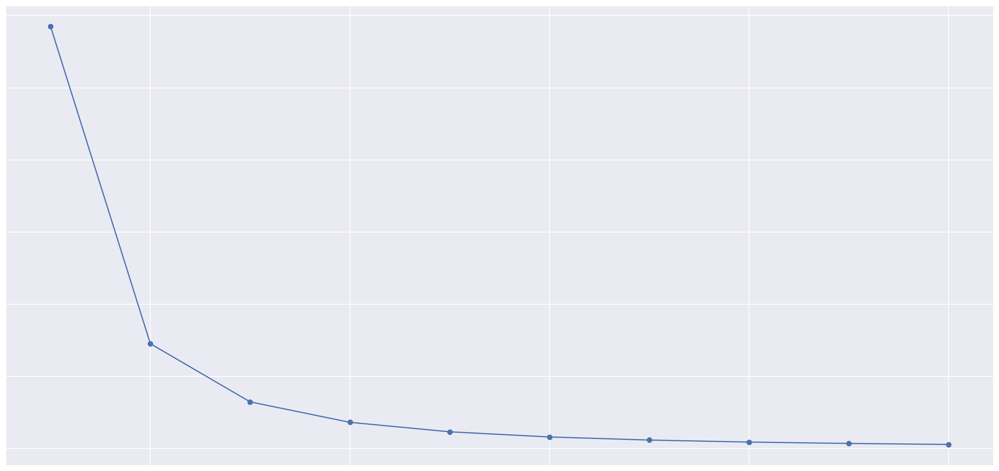

In [9]:
def elbow(X,n,seed=607):
    sse = []
    for i in range(1,n+1):
        print("\r",i,"/",n,end='')
        km = KMeans(n_clusters=i,init='k-means++',random_state=seed)
        km.fit(X)
        sse.append(km.inertia_)
    plt.figure(figsize=(20,10))
    plt.plot(range(1,n+1),sse,marker='o')
    plt.ylabel("SSE")
    plt.show()
elbow(test, 10)

In [10]:
seed = 607
km = KMeans(n_clusters=4, n_jobs=-1, random_state=seed)
km.fit(test)
res = km.predict(test)

In [11]:
if not os.path.exists('./data/KMeans'):
    os.makedirs('./data/KMeans')
for n in range(4) :
    print('\r', (n / 4) * 100, '% 완료', end = '')
    temp = test[res == n].copy()
    temp['구매날짜'] = pd.to_datetime(temp['구매날짜'])
    temp = temp.reset_index(drop = True)
    temp.insert(1, '카테고리명', '')
    for i in cat_list :
        temp['카테고리명'] = temp['카테고리명'] + temp['카테고리_' + i].apply(lambda x : i if x == 1 else '')
        temp = temp.drop(['카테고리_' + i], axis = 'columns').copy()
    temp.insert(2, '고객성별', '')
    for i in ['M', 'F'] :
        temp['고객성별'] = temp['고객성별'] + temp[i].apply(lambda x : i if x == 1 else '')
        temp = temp.drop([i], axis = 'columns').copy()
    temp['고객성별'] = temp['고객성별'].apply(lambda x : '없음' if x == '' else x)
    temp.insert(4, 'OS유형', '')
    for i in OS_list[:-1] :
        temp['OS유형'] = temp['OS유형'] + temp['OS유형_' + i].apply(lambda x : i if x == 1 else '')
        temp = temp.drop(['OS유형_' + i], axis = 'columns').copy()
    temp['OS유형'] = temp['OS유형'].apply(lambda x : '없음' if x == '' else x)
    temp.to_csv('./data/KMeans/군집_' + str(n) + '.csv', mode = 'w')
print('\r', 100, '% 완료', end = '')

 100 % 완료료

## DBSCAN
* 유의미한 결과 X

In [12]:
db = DBSCAN(eps = 10, min_samples = 3, n_jobs = -1)
res_db = db.fit_predict(test)
pd.Series(res_db).value_counts()

-1      1565876
 118          5
 150          4
 84           4
 95           4
 62           4
 59           4
 106          4
 51           4
 43           4
 129          4
 131          4
 137          4
 24           4
 19           4
 149          4
 77           4
 13           4
 14           3
 54           3
 60           3
 4            3
 58           3
 57           3
 56           3
 55           3
 53           3
 3            3
 5            3
 52           3
 6            3
 50           3
 49           3
 48           3
 61           3
 2            3
 46           3
 71           3
 76           3
 75           3
 74           3
 73           3
 1            3
 72           3
 70           3
 63           3
 69           3
 68           3
 67           3
 66           3
 65           3
 64           3
 47           3
 45           3
 15           3
 12           3
 29           3
 28           3
 27           3
 26           3
 11           3
 25           3
 23     

# 군집화 된 데이터 분석
* 샘플 데이터 추출
* 시각화

In [13]:
df0 = pd.read_csv('./data/KMeans/군집_1.csv',engine='python', encoding = 'utf-8')
df1 = pd.read_csv('./data/KMeans/군집_3.csv',engine='python', encoding = 'utf-8')
df2 = pd.read_csv('./data/KMeans/군집_0.csv',engine='python', encoding = 'utf-8')
df3 = pd.read_csv('./data/KMeans/군집_2.csv',engine='python', encoding = 'utf-8')

In [14]:
dfr0 = df0.copy()
dfr1 = df1.copy()
dfr2 = df2.copy()
dfr3 = df3.copy()

## 샘플 데이터 추출

In [15]:
seed=607
ex0=dfr0[dfr0['고객성별']!='없음'].sample(1000, random_state=seed).copy()
ex1=dfr1[dfr1['고객성별']!='없음'].sample(1000, random_state=seed).copy()
ex2=df2[dfr2['고객성별']!='없음'].sample(1000, random_state=seed).copy()
ex3=df3[dfr3['고객성별']!='없음'].sample(1000, random_state=seed).copy()

ex0 = ex0[(ex0['구매금액']>0)&(ex0['구매금액']<1000000)].copy()
ex1 = ex1[(ex1['구매금액']>0)&(ex1['구매금액']<1000000)].copy()
ex2 = ex2[(ex2['구매금액']>0)&(ex2['구매금액']<1000000)].copy()
ex3 = ex3[(ex3['구매금액']>0)&(ex3['구매금액']<1000000)].copy()
# 이상데이터 제거

In [16]:
ex_list = [ex0.copy(), ex1.copy(), ex2.copy(), ex3.copy()]
for i in range(4) :
    ex_list[i]['ind'] = i
res = pd.concat(ex_list)
res = res.drop(res.columns[0], axis = 'columns').copy()
res

,구매날짜,카테고리명,고객성별,고객나이,OS유형,구매금액,구매수,평균구매금액,ind
116243,2019-02-08,음향가전,F,30,없음,651324,12,54277,0
370079,2019-05-04,골프용품,F,60,IOS,731620,6,121936,0
117998,2019-02-09,문구/사무용품,F,10,WINDOWS,338168,30,11272,0
97893,2019-02-02,안전용품,F,20,WINDOWS,114100,2,57050,0
341767,2019-04-24,완구/키덜트/게임,M,10,WINDOWS,172980,5,34596,0
...,...,...,...,...,...,...,...,...,...
73289,2020-03-12,문구/사무용품,M,50,없음,310621,8,38827,3
148590,2020-04-08,여성의류,F,30,없음,451020,12,37585,3
119870,2020-03-29,낚시용품,F,50,WINDOWS,90230,4,22557,3
137743,2020-04-04,욕실용품,M,20,WINDOWS,39430,3,13143,3


## 시각화

In [17]:
data = res.pivot_table(index = '구매날짜', columns = 'ind', values = '구매금액')
data.fillna(0)

ind,0,1,2,3
구매날짜,,,,
2019-01-01,43500.000000,0.0,0.0,0.000000
2019-01-02,586100.000000,0.0,0.0,0.000000
2019-01-03,300294.200000,0.0,0.0,0.000000
2019-01-04,665595.000000,0.0,0.0,0.000000
2019-01-05,439049.333333,0.0,0.0,0.000000
...,...,...,...,...
2020-06-26,0.000000,0.0,0.0,383724.666667
2020-06-27,0.000000,0.0,0.0,110380.000000
2020-06-28,0.000000,0.0,0.0,187053.333333


No handles with labels found to put in legend.


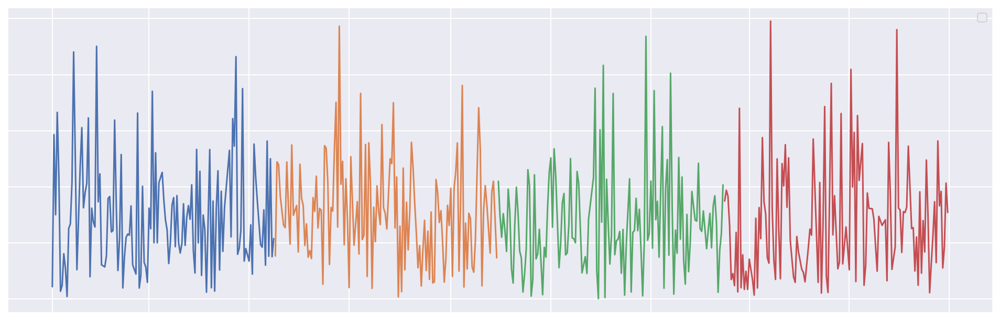

In [18]:
plt.figure(figsize=(15,5))
date = data.reset_index()['구매날짜']
date= pd.to_datetime(date)
plt.plot(date, data.reset_index()[0])
plt.plot(date, data.reset_index()[1])
plt.plot(date, data.reset_index()[2])
plt.plot(date, data.reset_index()[3])
plt.legend()
plt.xticks(rotation=20)
plt.show()

In [19]:
data2 = res.pivot_table(index = '고객성별', columns = 'ind', values = '구매금액')

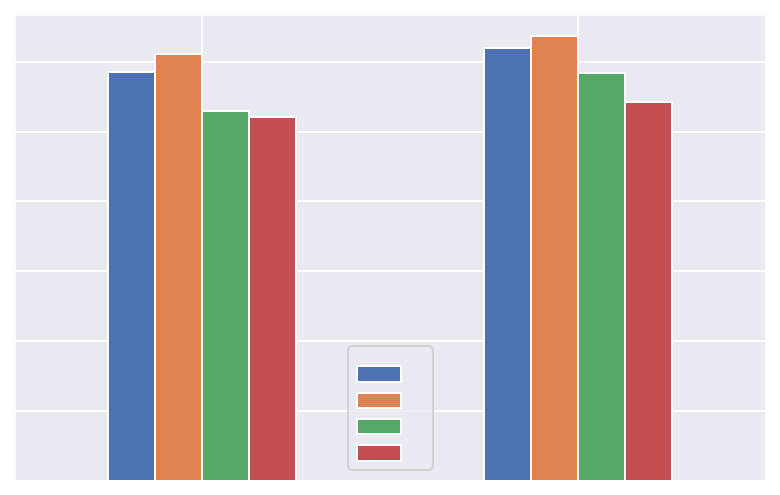

In [20]:
data2.plot(kind = 'bar')

In [21]:
data3 = res.pivot_table(index = '고객나이', columns = 'ind', values = '구매금액')

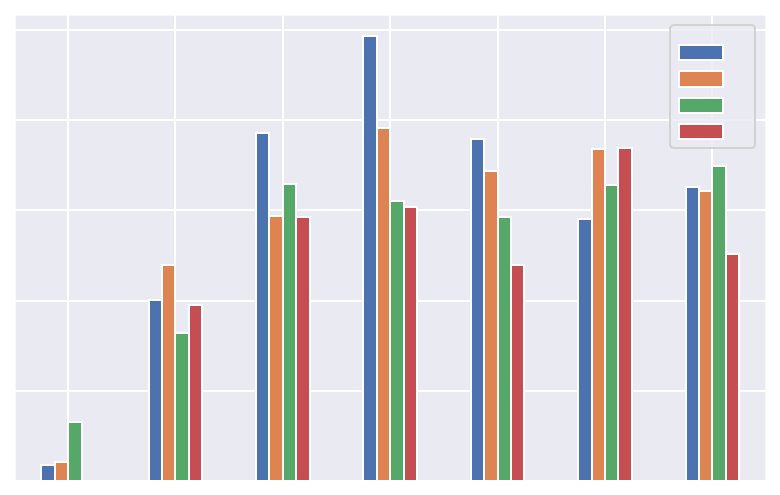

In [22]:
data3.plot(kind = 'bar')

# 온라인 데이터 시각화
* 데이터 전처리
* 전체 소비 동향
* 업종별 소비 동향
* 업종 및 연령별 소비 동향

In [23]:
MCorp=pd.read_csv('./data/M_corper.csv')
MCorp['구매월'] = MCorp['구매날짜'] // 100
MCorp = MCorp.drop('구매날짜', axis = 'columns').copy()
GMCorp= MCorp.groupby(['구매월', '카테고리명', '고객나이']).sum().reset_index().copy()
GMCorp

,구매월,카테고리명,고객나이,Unnamed: 0,구매금액,구매수
0,201901,PC/사무기기,0,4426134,22020712768,109024
1,201901,PC/사무기기,10,10933602,158076632,3115
2,201901,PC/사무기기,20,11208748,5479610163,55419
3,201901,PC/사무기기,30,11209740,9978355454,77589
4,201901,PC/사무기기,40,11210732,10573521393,62938
...,...,...,...,...,...,...
8059,202006,휴대폰/악세서리,20,355636296,4458047318,114744
8060,202006,휴대폰/악세서리,30,348164148,6439191001,126650
8061,202006,휴대폰/악세서리,40,357218802,5744716067,90591
8062,202006,휴대폰/악세서리,50,351055659,2390068305,28955


## 데이터 전처리
* '고객나이'==0 인 데이터의 값이 매우 커서 각 연령대 구매수 비율에 따라 분배하였다.

In [24]:
corp=GMCorp

cate_list=corp['카테고리명'].unique().tolist()
month_list=corp['구매월'].unique().tolist()

import copy

corp_list=[]
for i in cate_list:
    temp_list = []
    temp_df = corp[corp['카테고리명']==i]
    for j in month_list : temp_list.append(temp_df[temp_df['구매월'] == j])
    corp_list.append(copy.deepcopy(temp_list))
    
for i in range(len(cate_list)):
    for j in range(len(month_list)):
        corp_list[i][j]=corp_list[i][j].reset_index()
        corp_list[i][j]['비율']=corp_list[i][j]['구매수'].apply(lambda x: x/corp_list[i][j]['구매수'][1:].sum())
        corp_list[i][j]['비율']=corp_list[i][j]['비율'].apply(lambda x: x*corp_list[i][j]['구매수'][0])
        corp_list[i][j]['구매수']+=corp_list[i][j]['비율']
#         corp_list[i][j]=corp_list[i][j].drop([corp_list[i][j].columns[0], corp_list[i][j].columns[-1]])
new_corp = pd.concat([corp_list[i][j] for i in range(len(cate_list)) for j in range(len(month_list))]).copy()

cop=new_corp[['구매월','카테고리명','고객나이','구매수']].copy()
cop=cop[cop['고객나이']!=0]
cop['구매수']=round(cop['구매수']).astype(int)
cop=cop.reset_index()

cop_20=cop[(cop['고객나이']==10)|(cop['고객나이']==20)].groupby(['구매월','카테고리명']).sum().reset_index()
cop_20['고객나이']=20
cop=pd.concat([cop_20, cop[(cop['고객나이']>20)]])
cop=cop.drop(columns=['index'])

## 전체 소비 동향

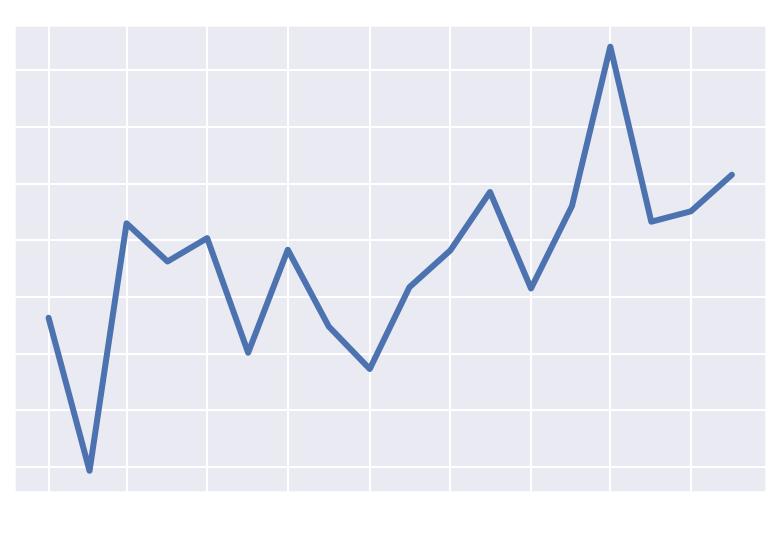

In [25]:
ALL_Corp=MCorp.groupby(["구매월"]).sum().reset_index()
date=ALL_Corp["구매월"].apply(lambda x: str(x)+'01')
date=pd.to_datetime(date)
count=ALL_Corp["구매수"].tolist()
plt.title("전체 소비 변화")
plt.xticks(rotation=20)
plt.plot(date, count, linewidth=3)
plt.savefig('ALL.jpg')
plt.show()

## 업종별 소비 동향

[PC/사무기기]


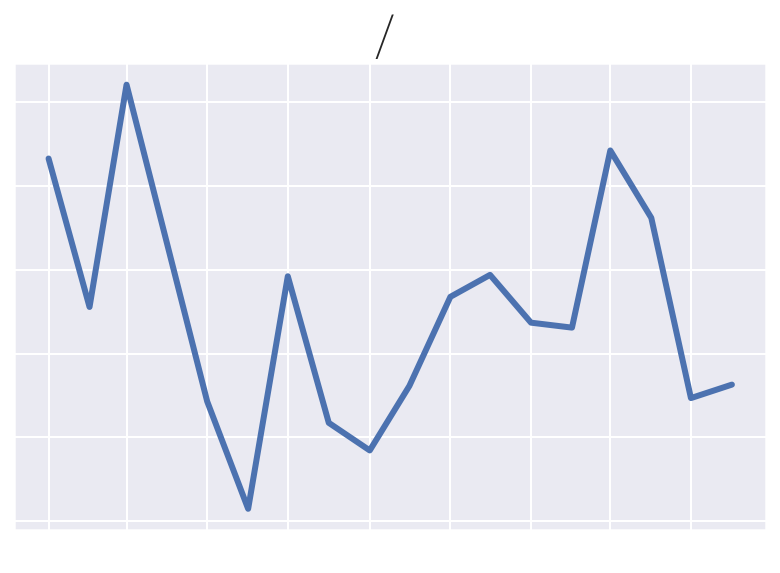

[TV/홈시어터]


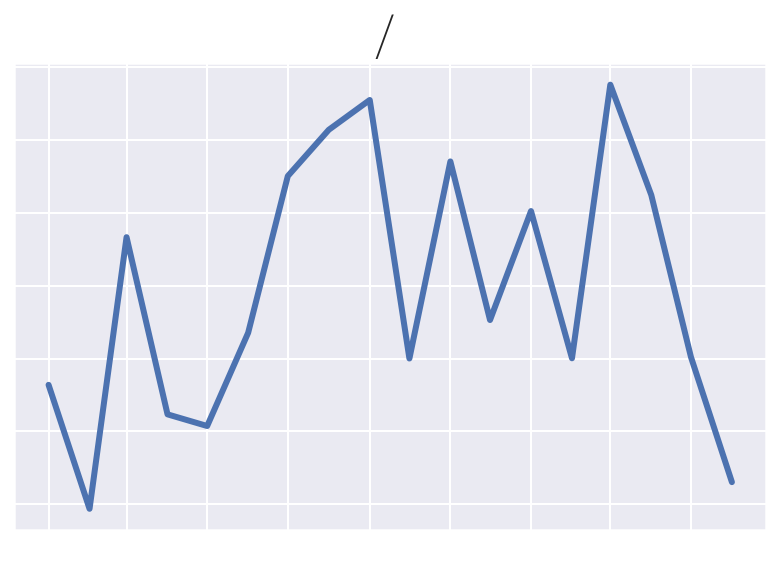

[가공식품]


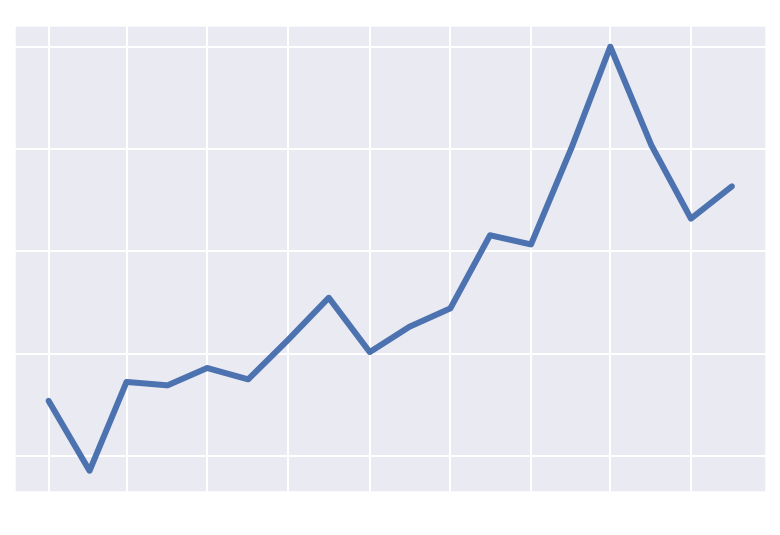

[가방/지갑/잡화]


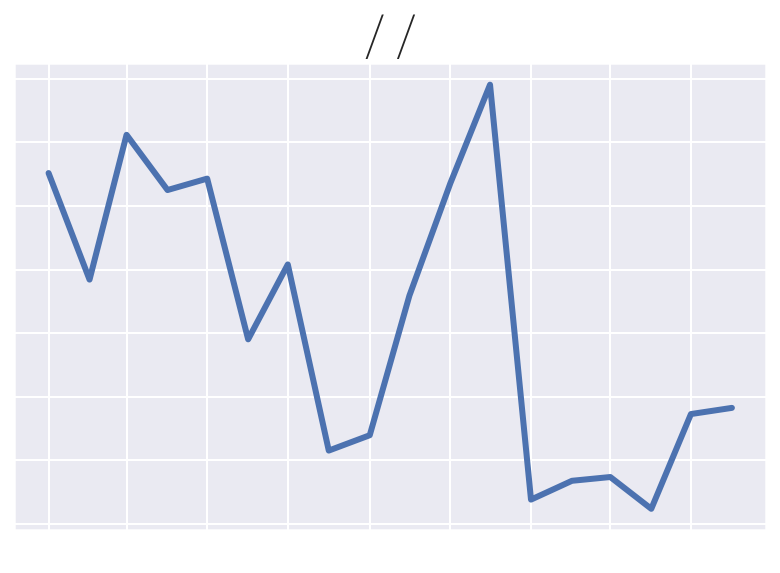

[건강 관련용품]


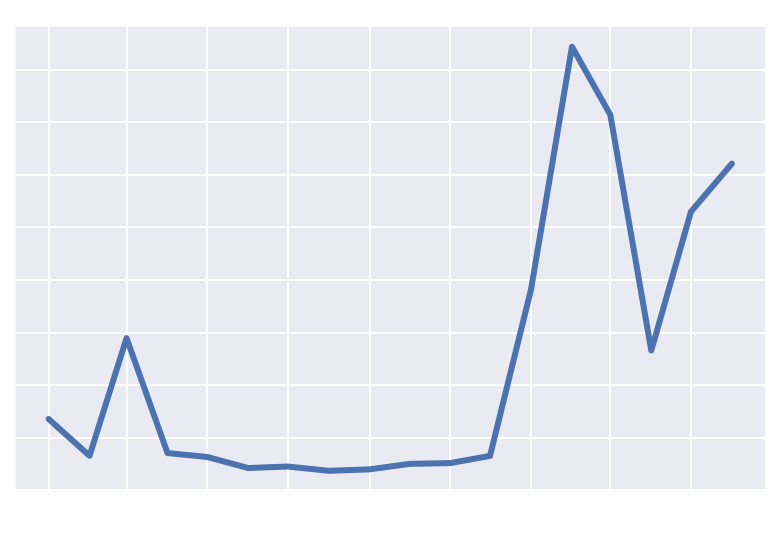

[건강식품]


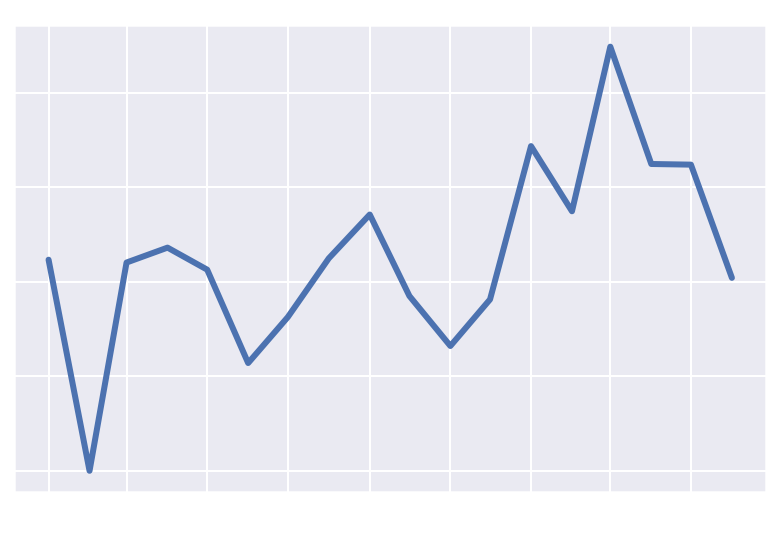

[계절가전]


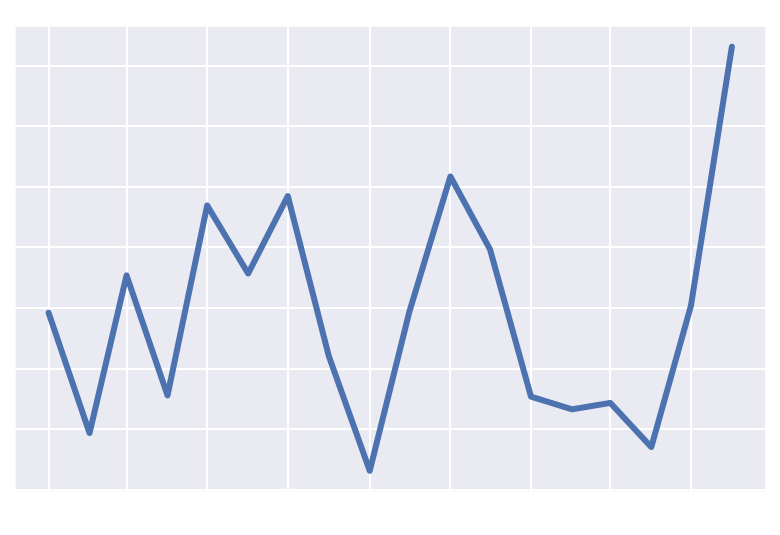

[골프용품]


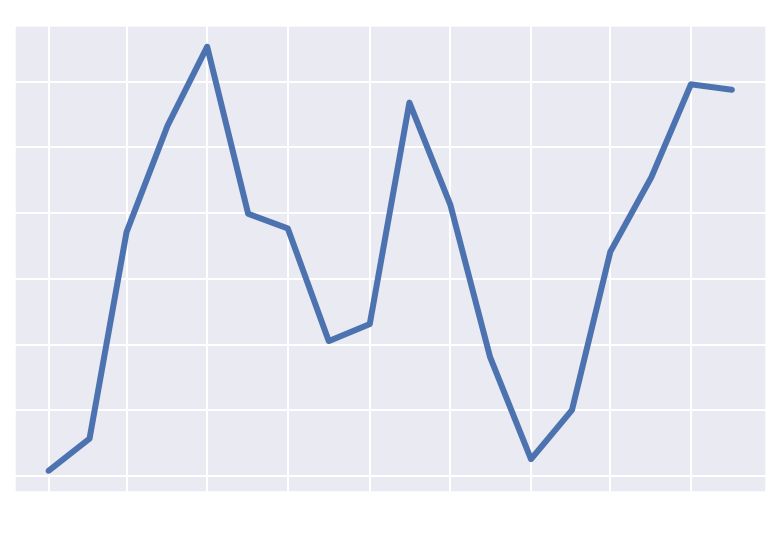

[공구류]


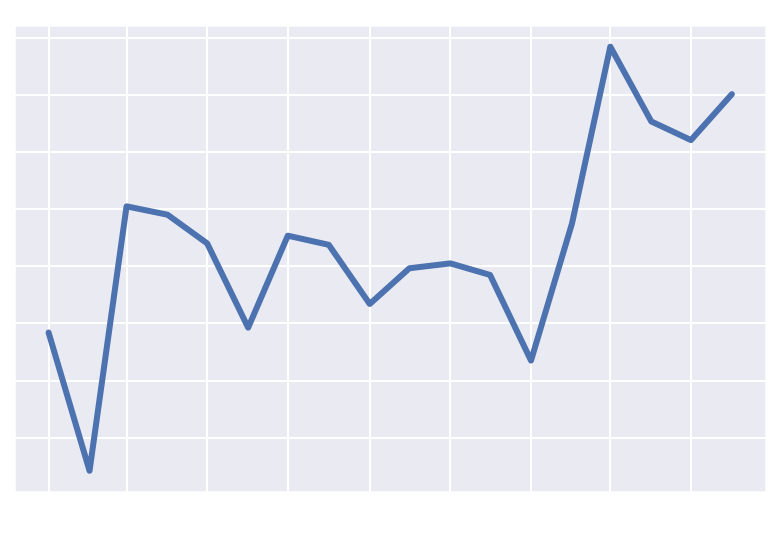

[구기종목 용품]


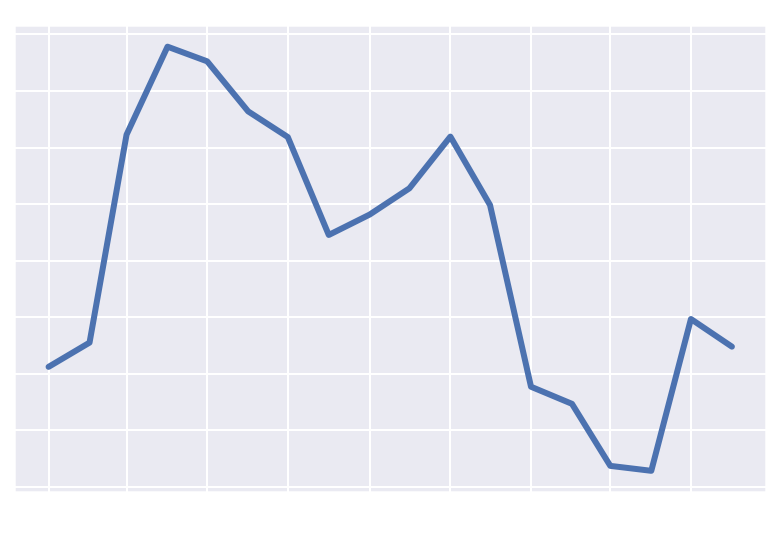

[국내외여행]


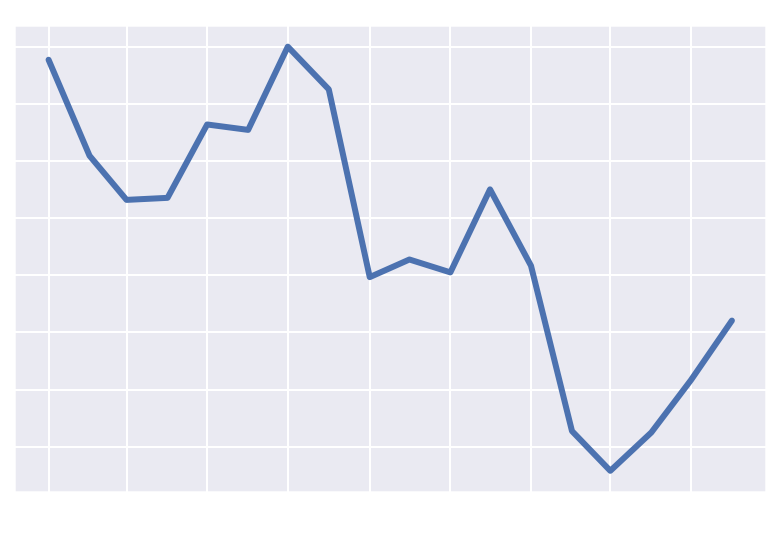

[기타 스포츠/스포츠 용품]


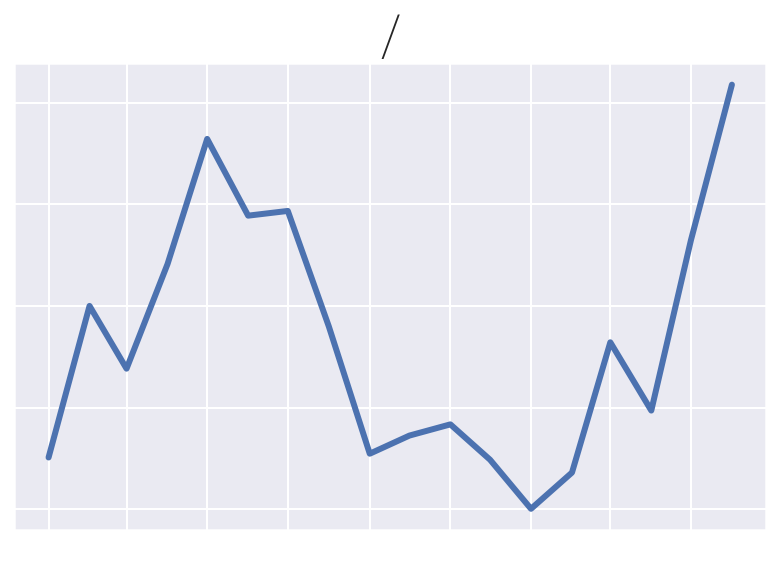

[낚시용품]


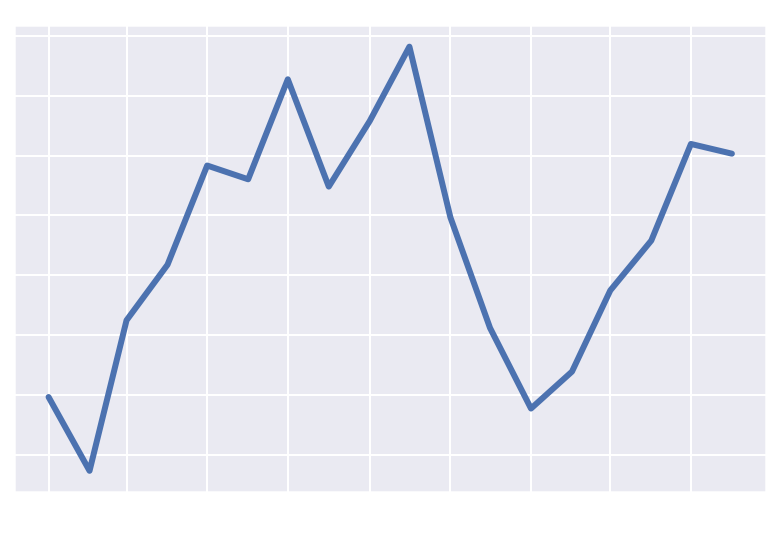

[남성의류]


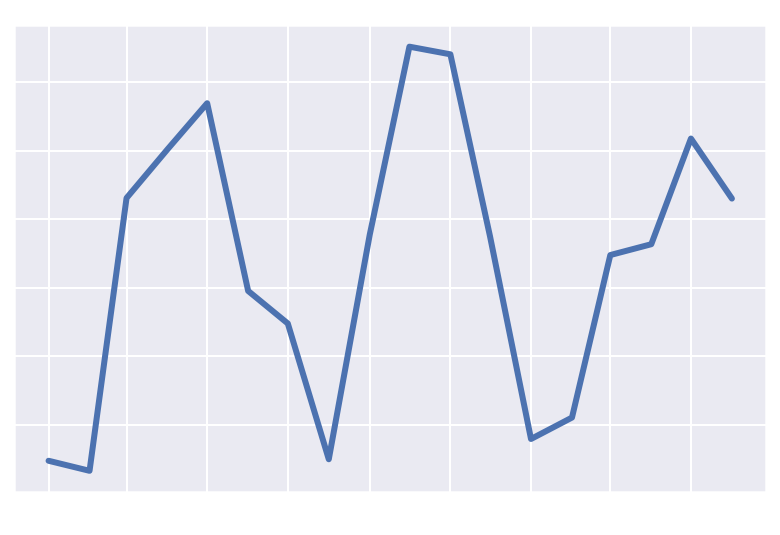

[노트북/태블릿/학습가전]


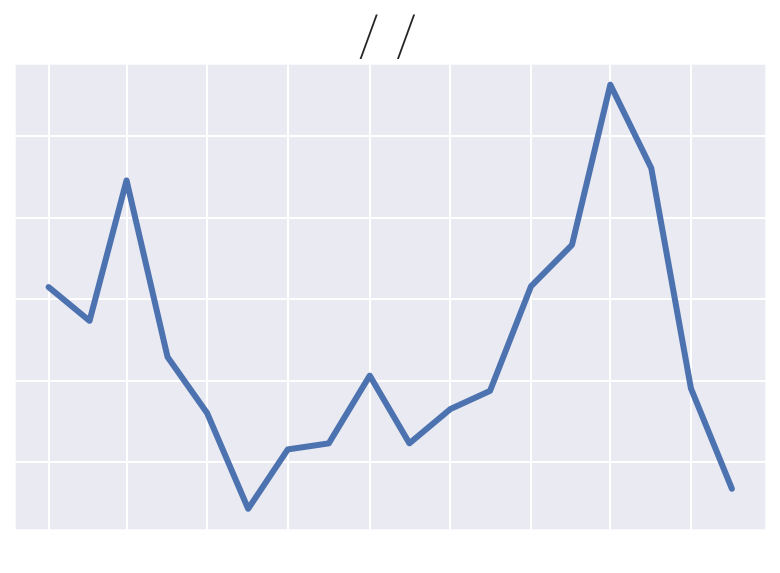

[농축수산물]


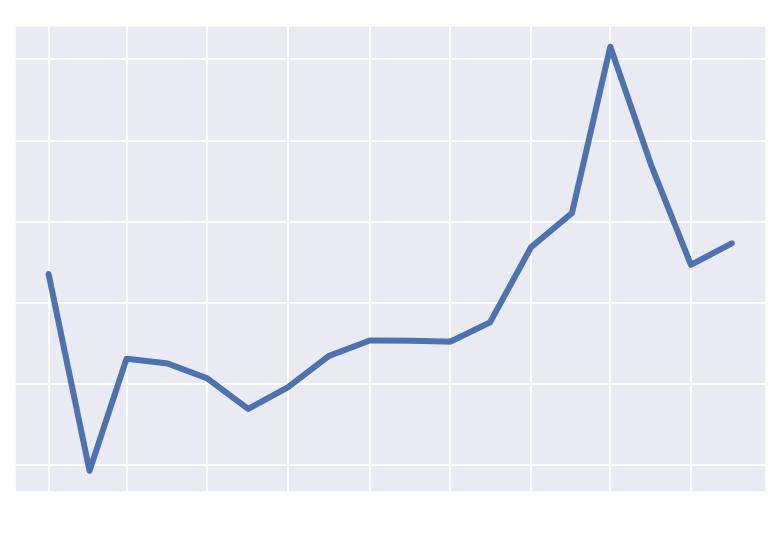

[도서/음반/DVD]


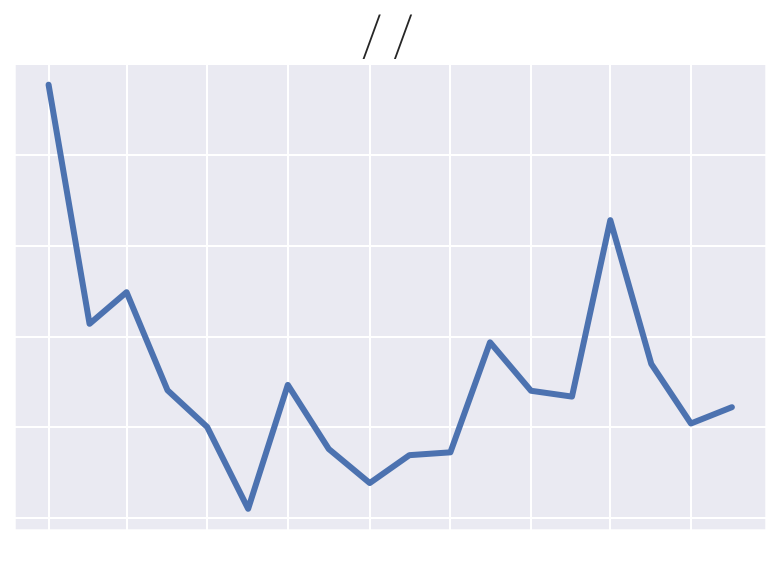

[등산용품]


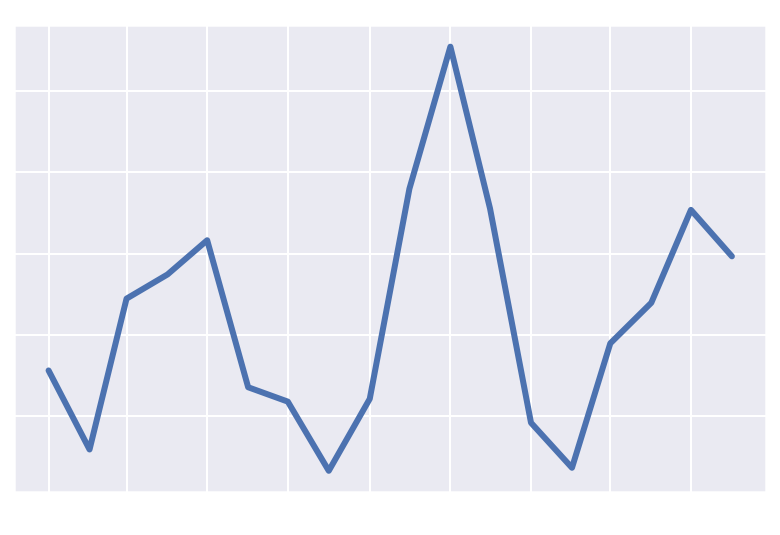

[메이크업 용품]


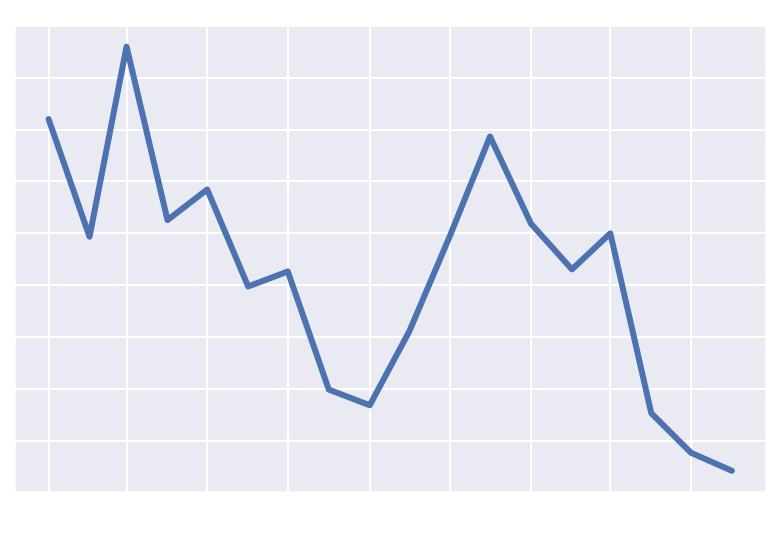

[문구/사무용품]


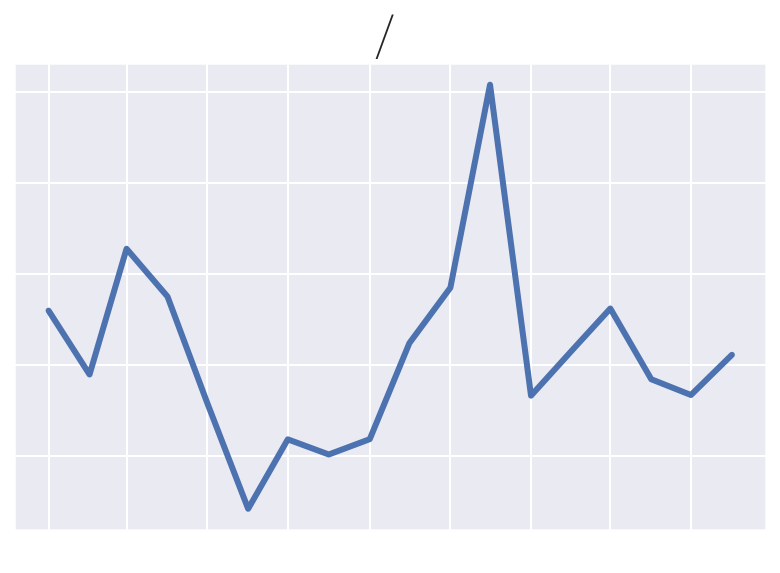

[미용가전/안마기]


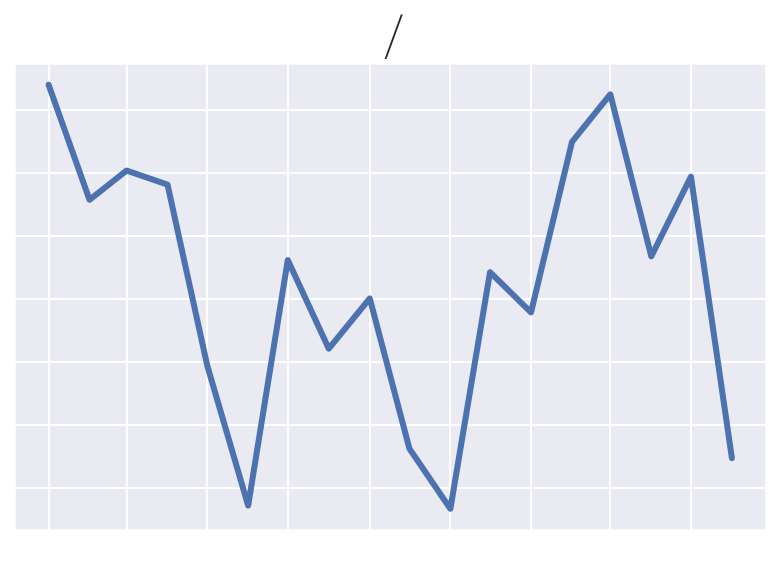

[반려동물용품]


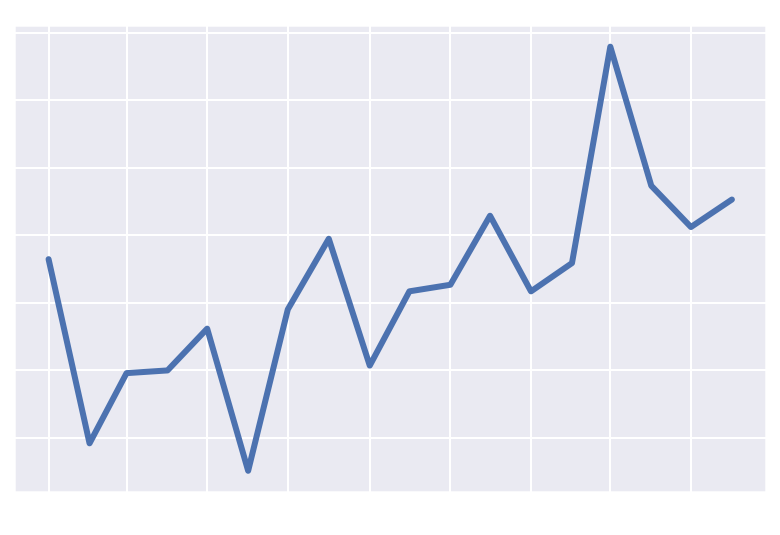

[생활 가구]


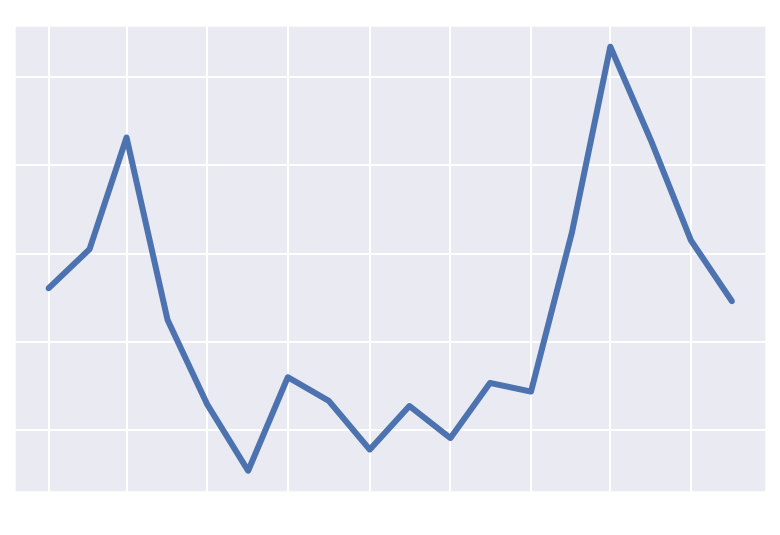

[생활 가전]


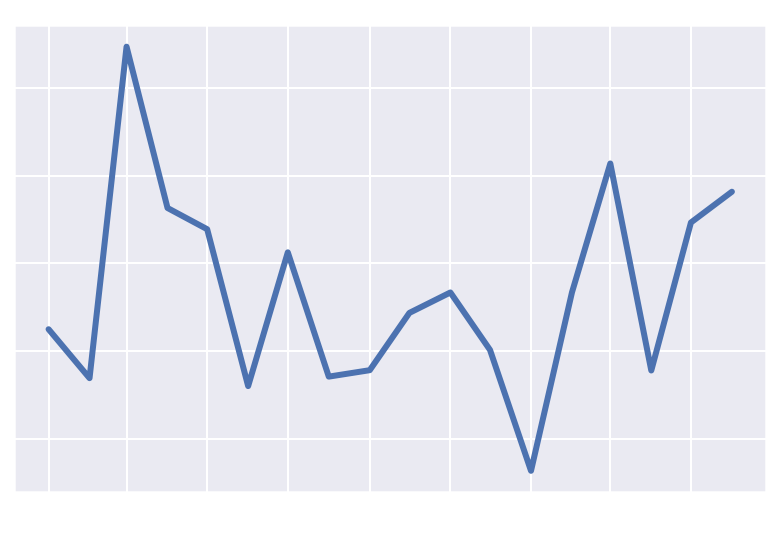

[생활용품]


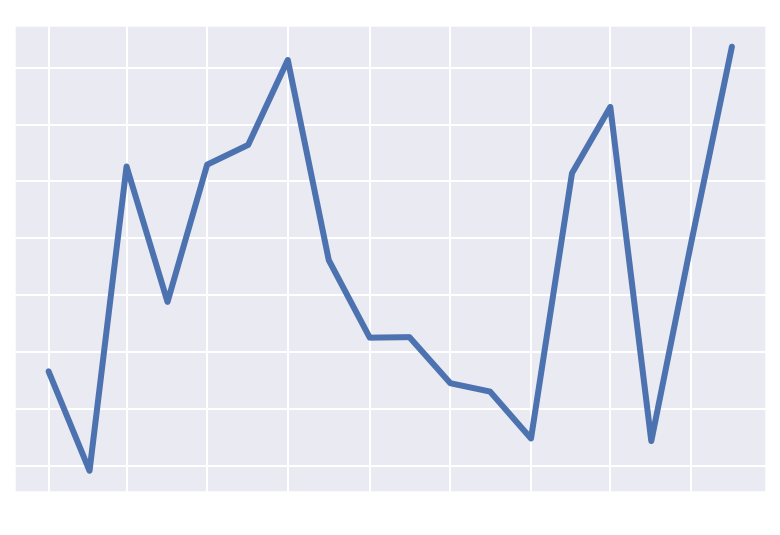

[서비스/티켓]


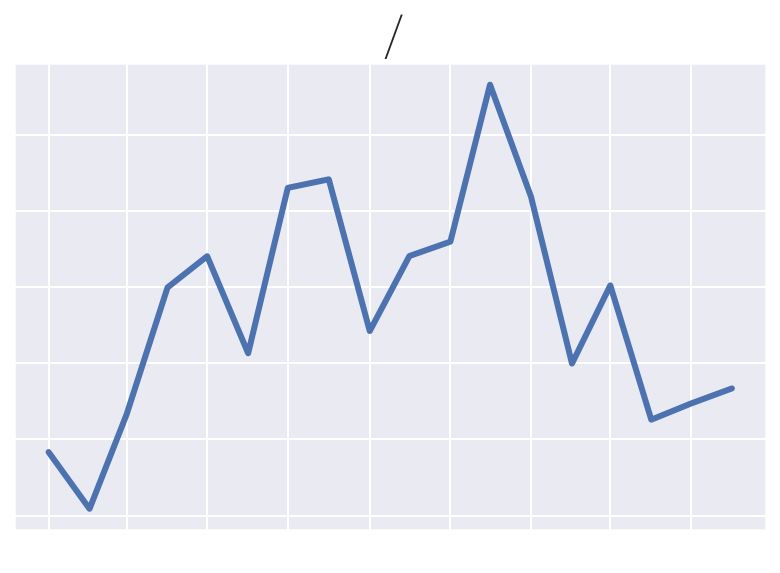

[성인용품]


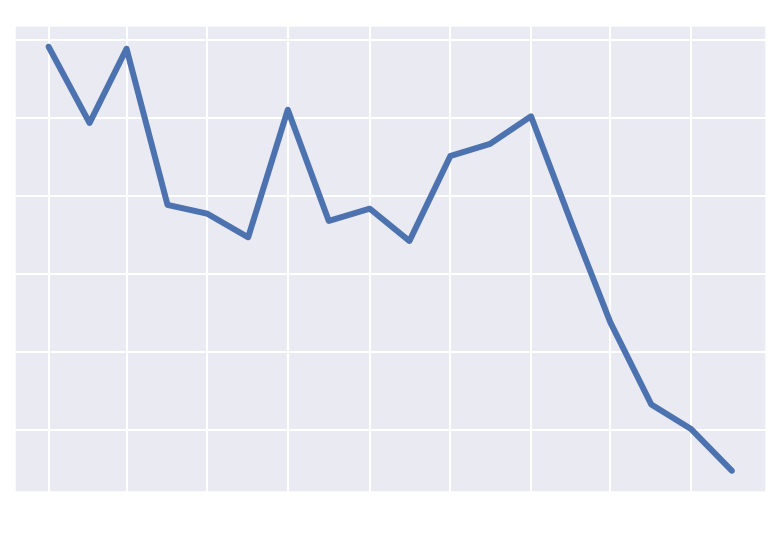

[세탁/청소/세면 용품]


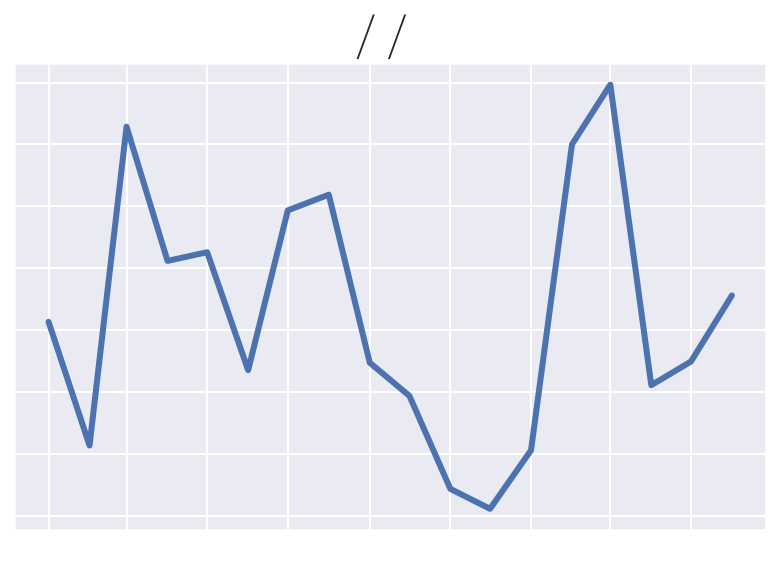

[수납가구]


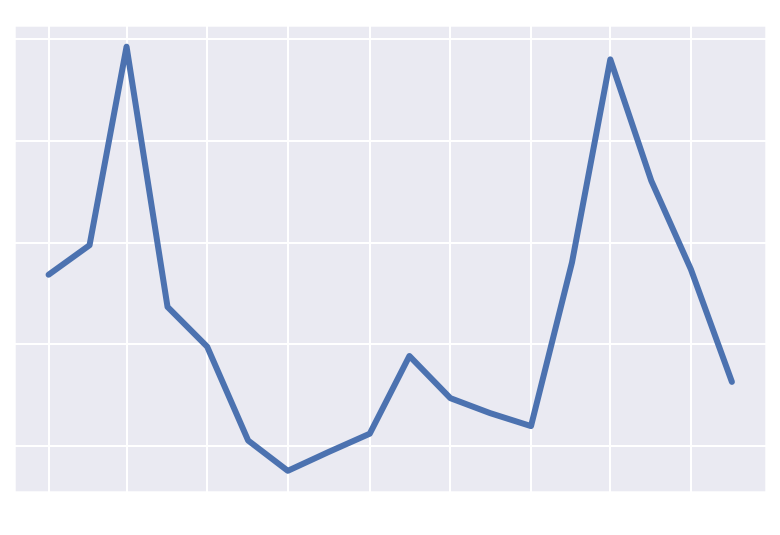

[수납용품]


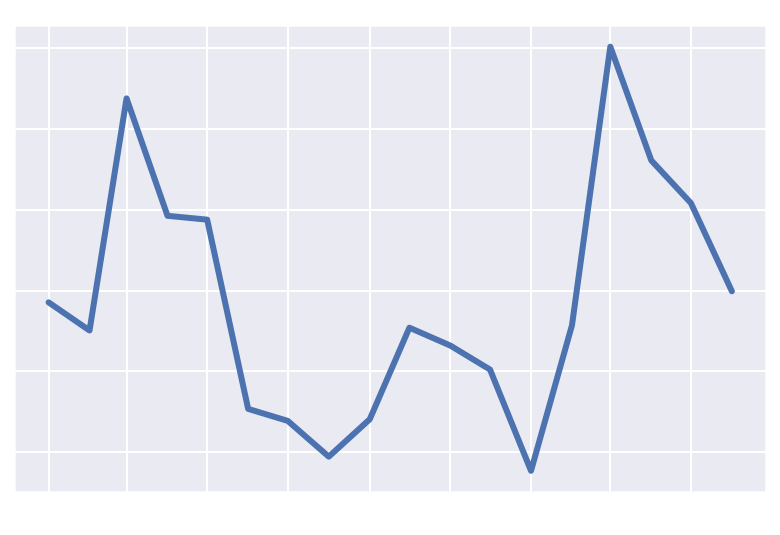

[수영용품]


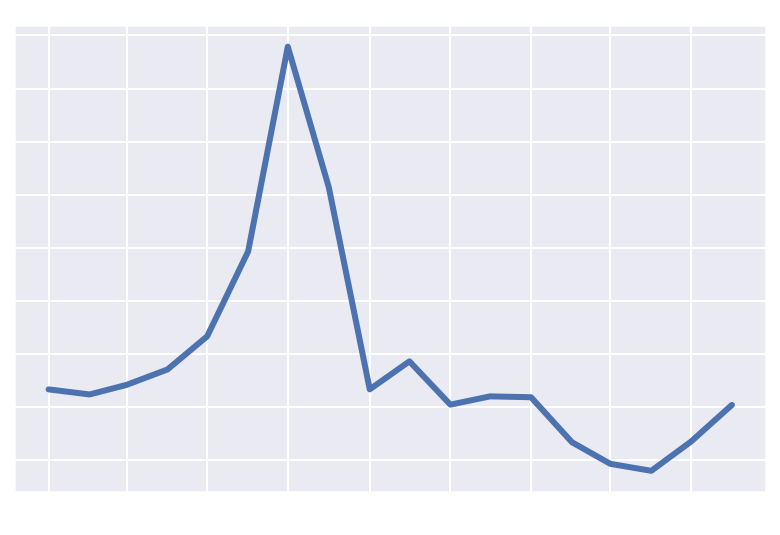

[스키/보드용품]


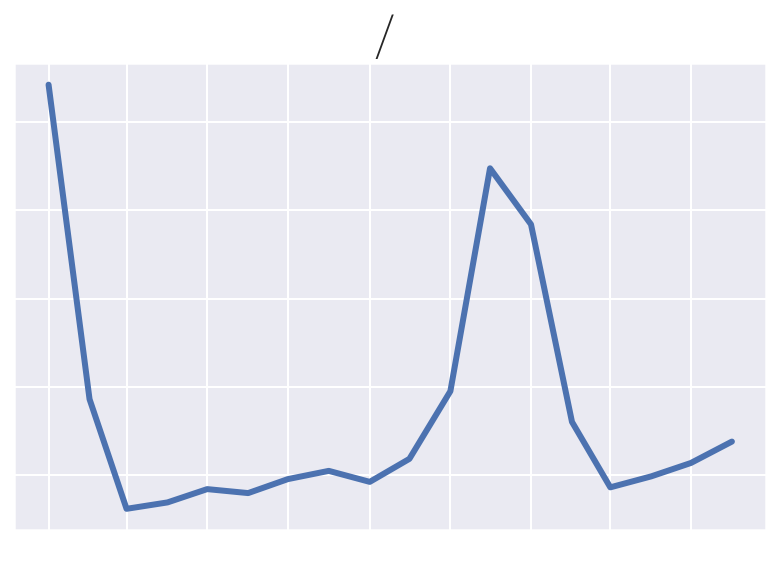

[스킨케어]


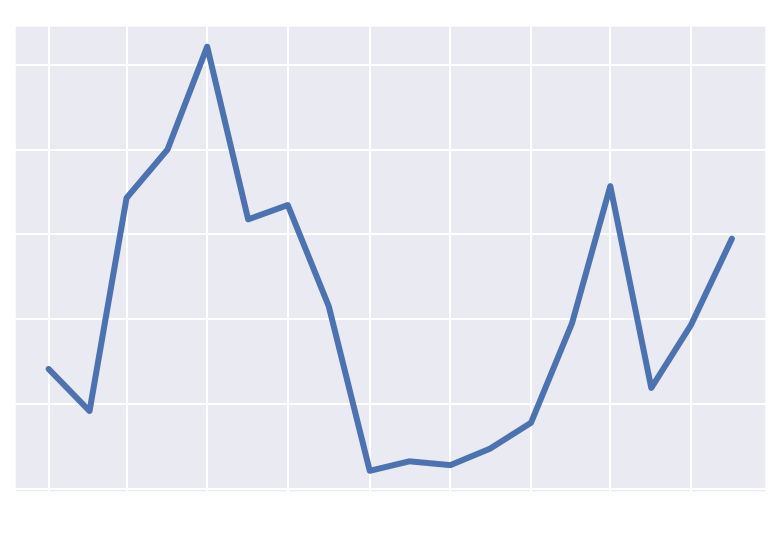

[스포츠의류/잡화]


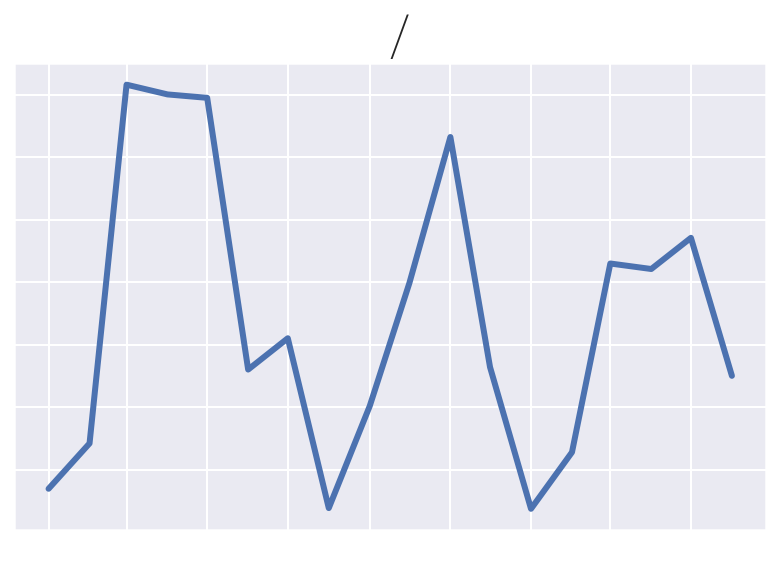

[신발]


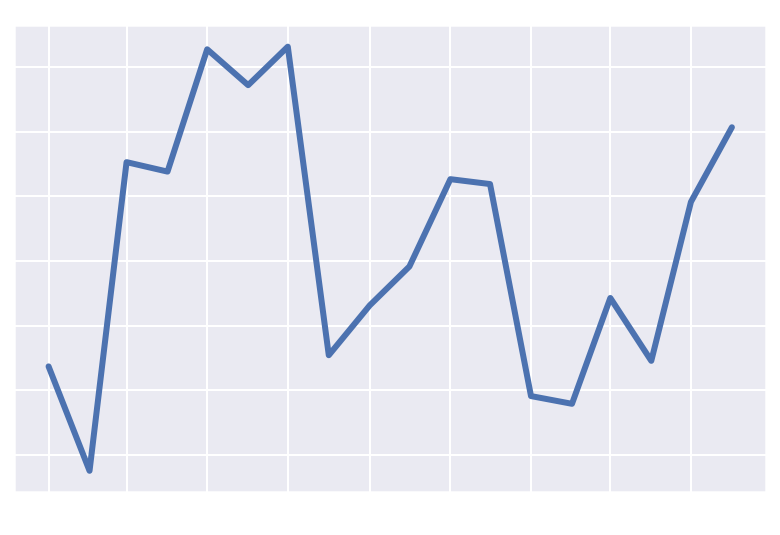

[악세서리/시계/주얼리]


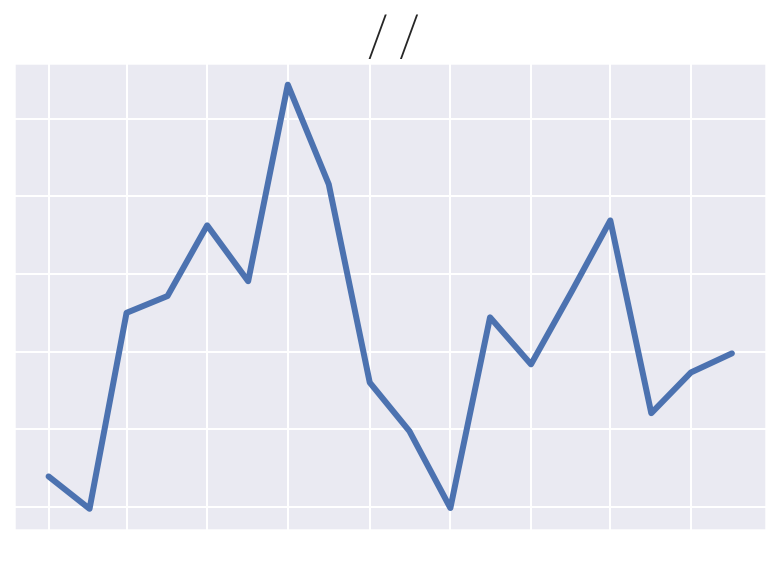

[안전용품]


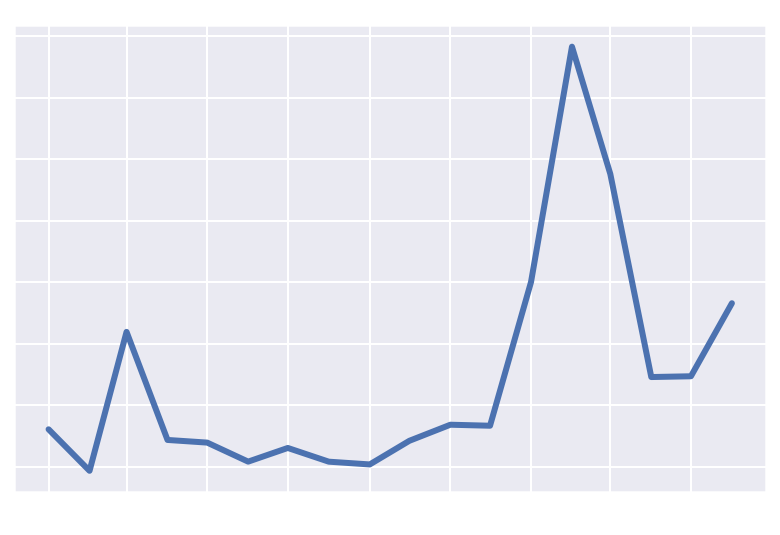

[언더웨어]


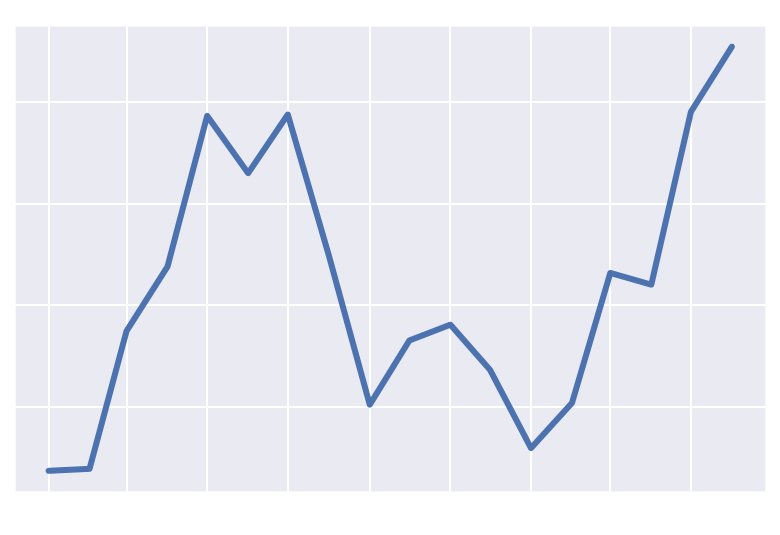

[업소 위생용품]


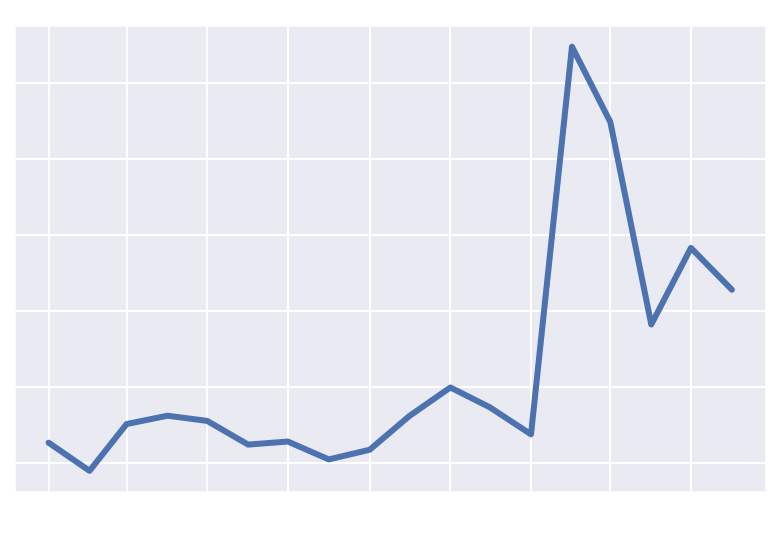

[여성의류]


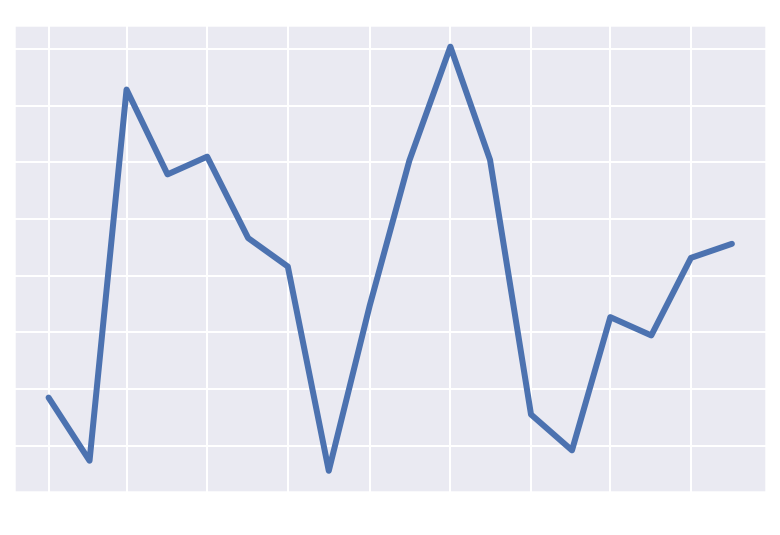

[완구/키덜트/게임]


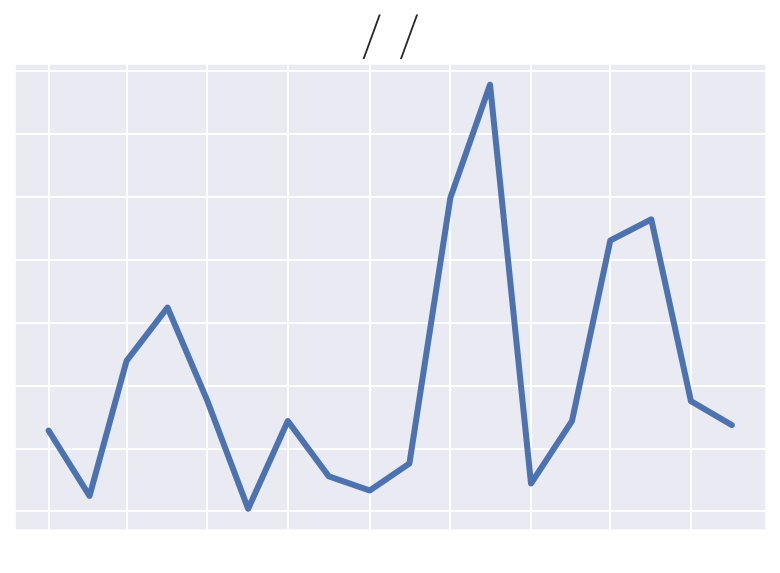

[욕실가전]


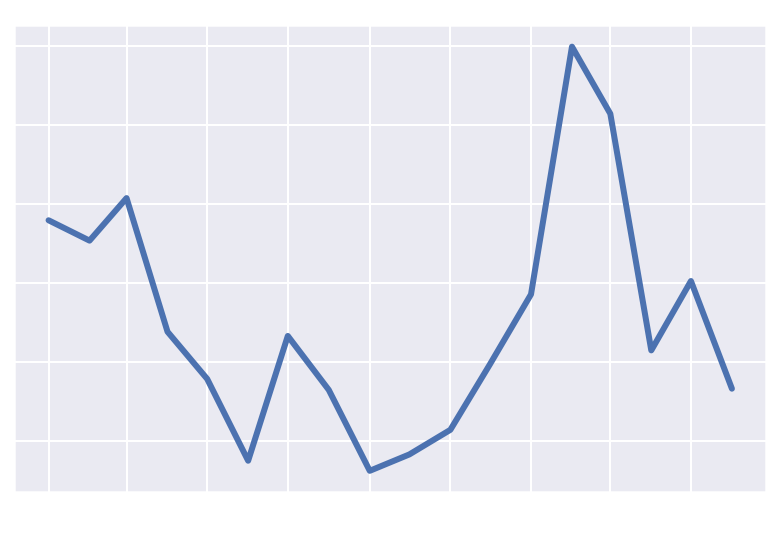

[욕실용품]


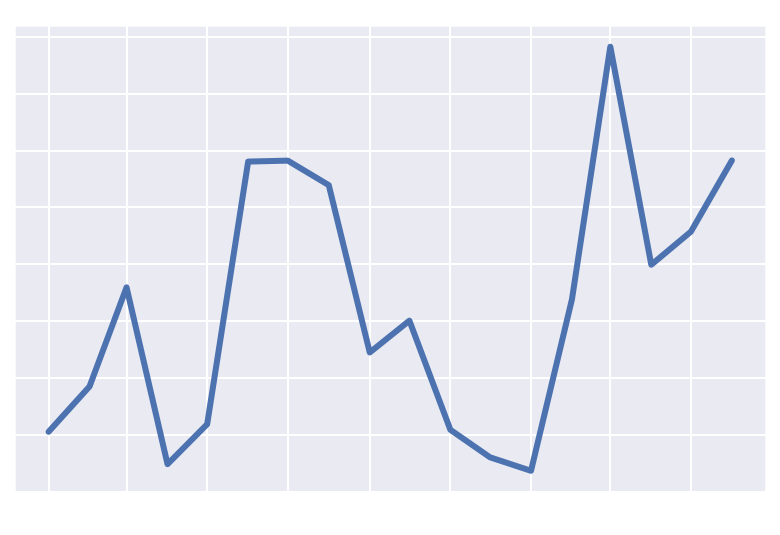

[유아/아동용품]


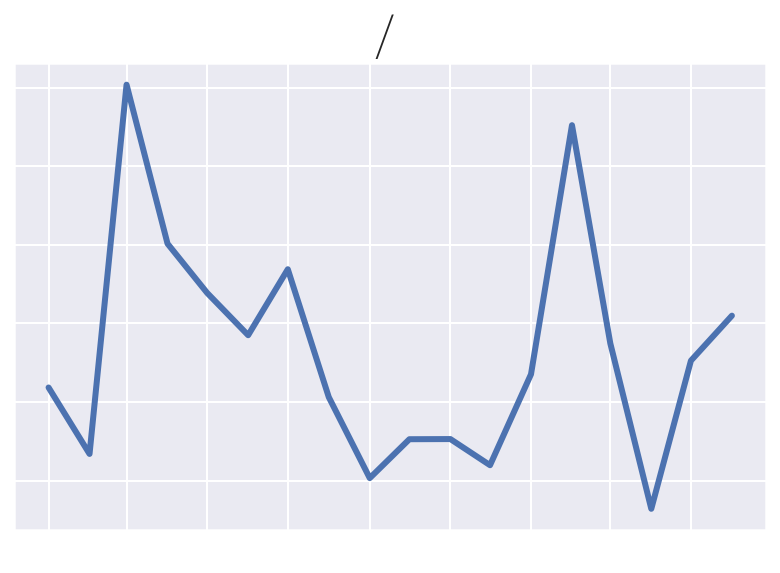

[유아/아동의류]


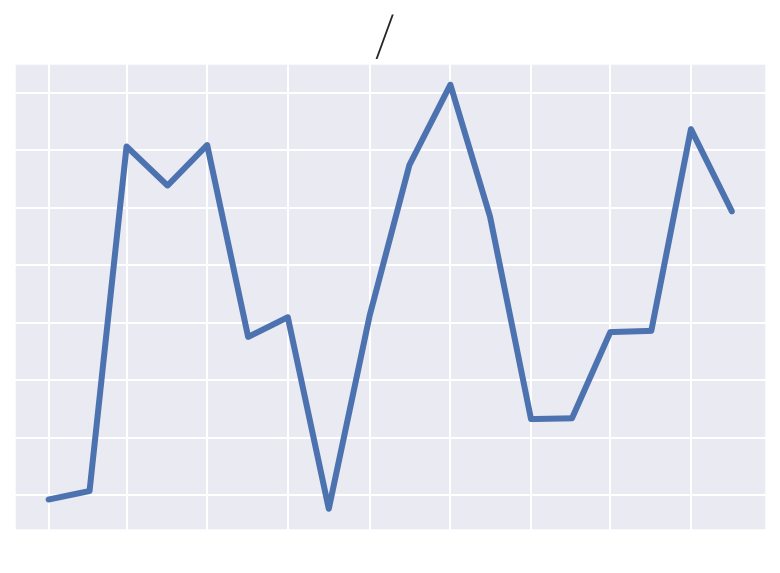

[음료]


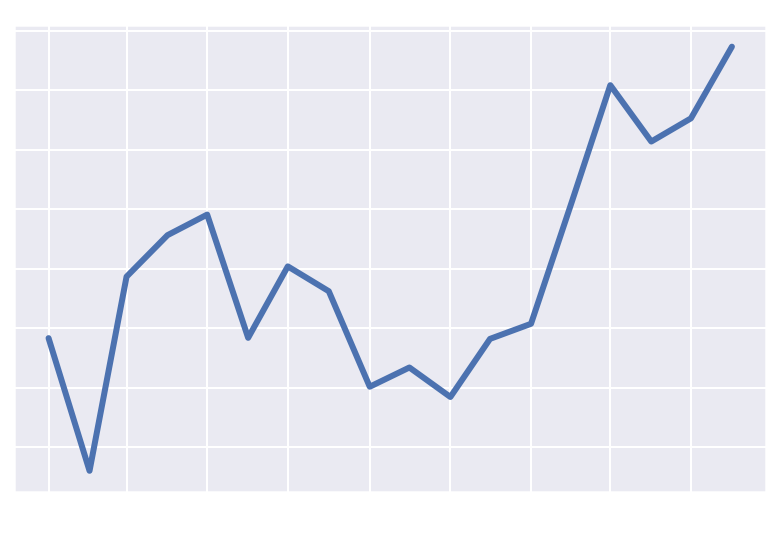

[음향가전]


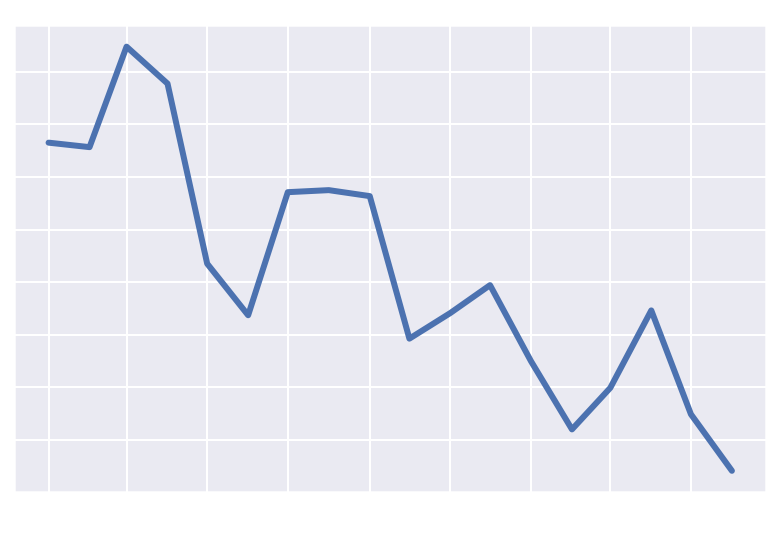

[인테리어용품]


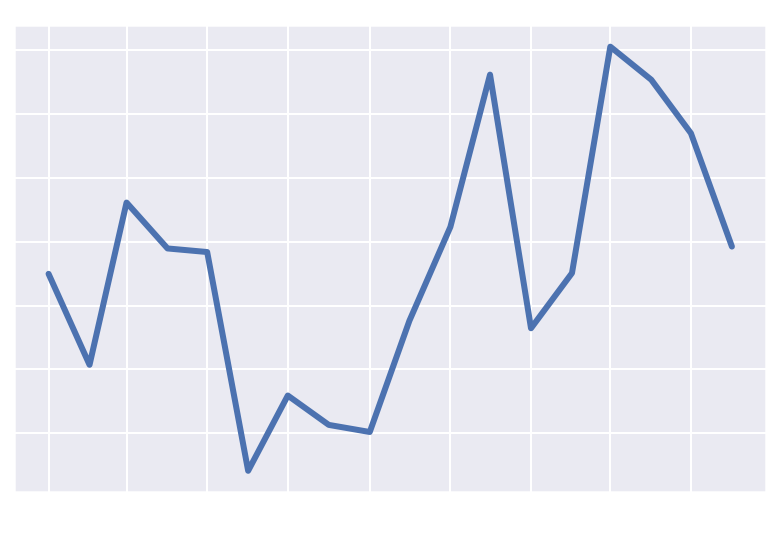

[자동차 관련용품]


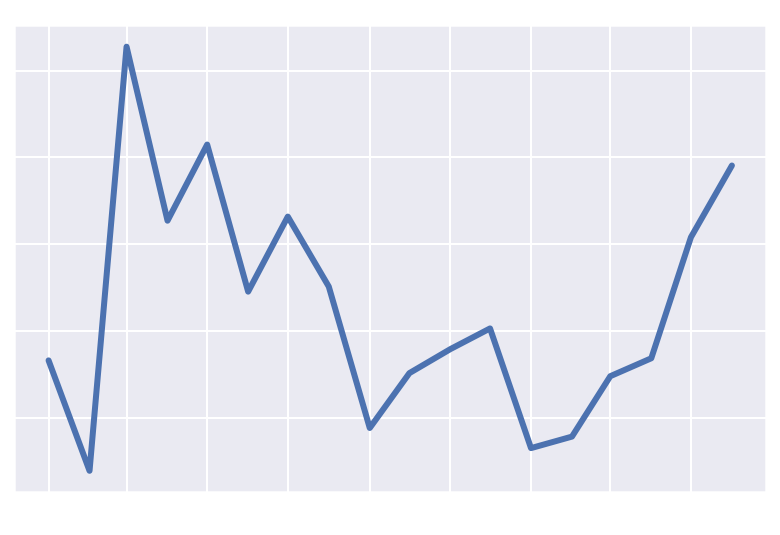

[자전거/사이클/보드/인라인]


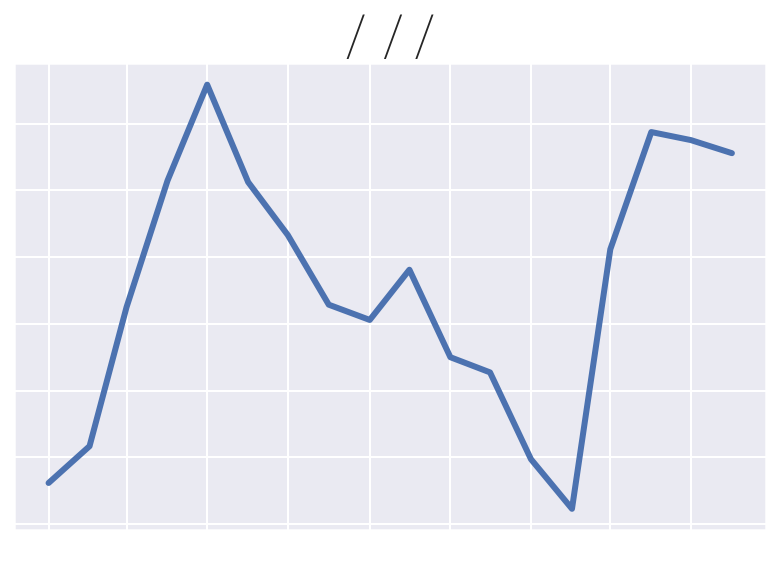

[주방가전]


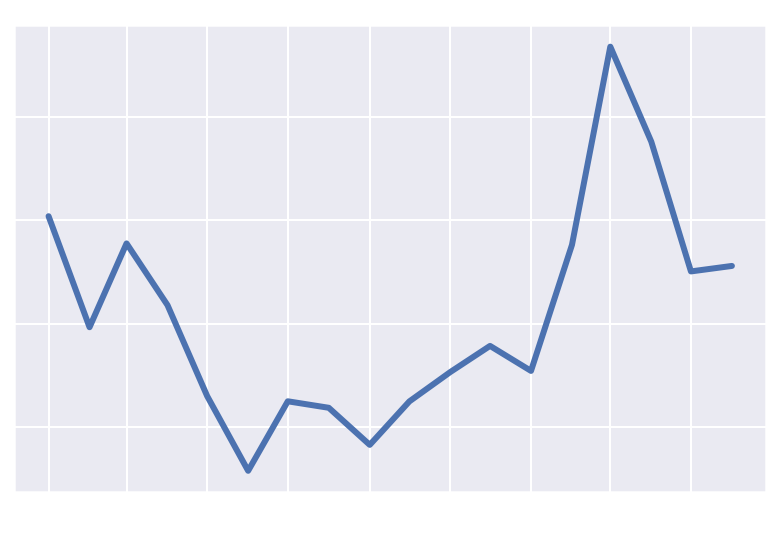

[주방수납/잡화]


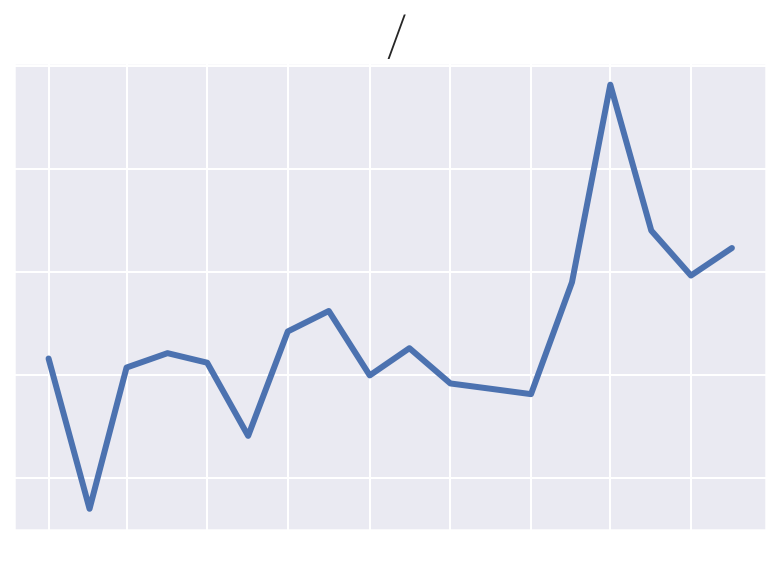

[주방식기/용기]


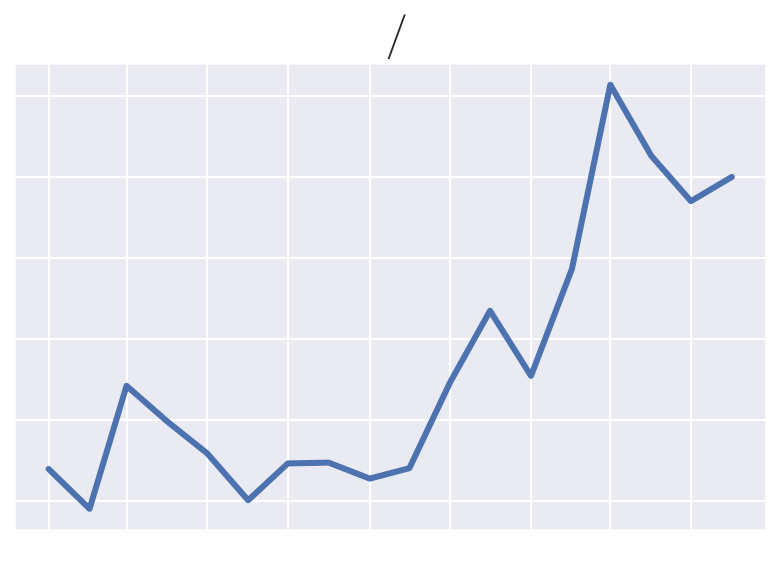

[주방조리기구]


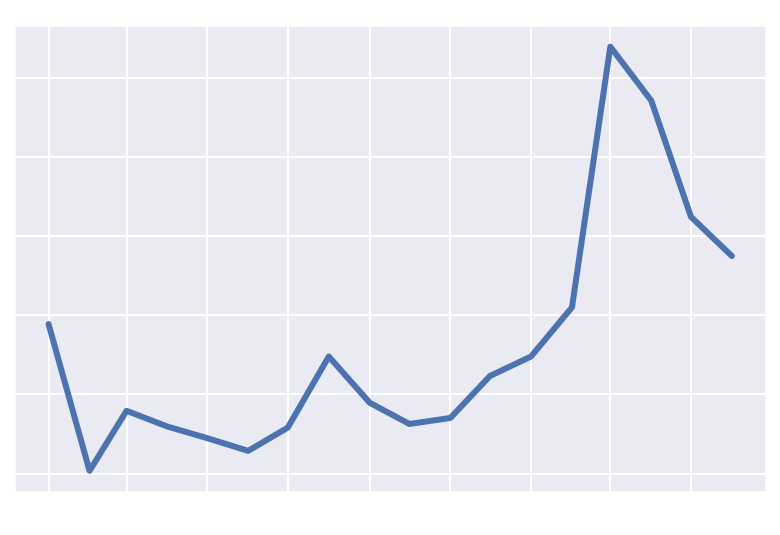

[출산용품/임부용품]


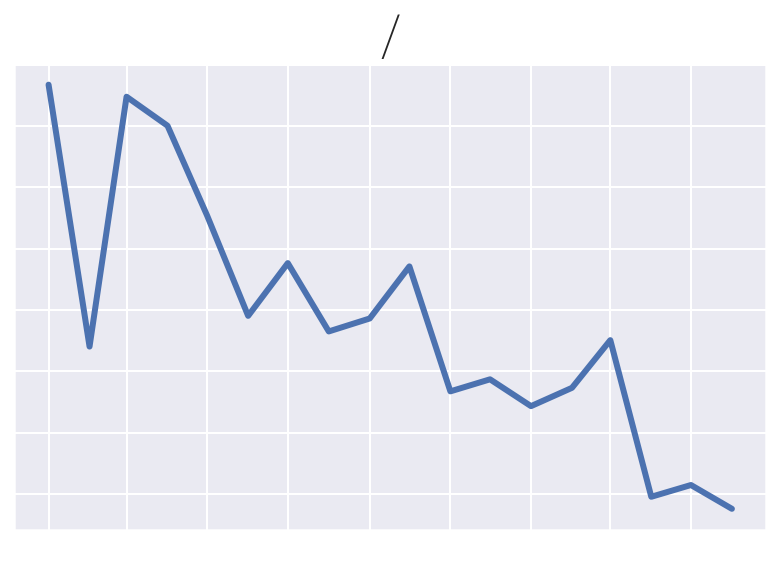

[취미/악기]


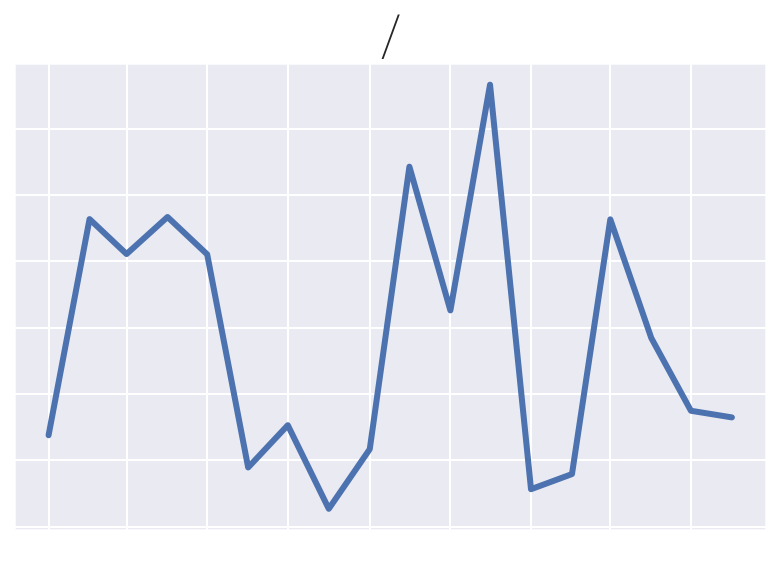

[침실 가구]


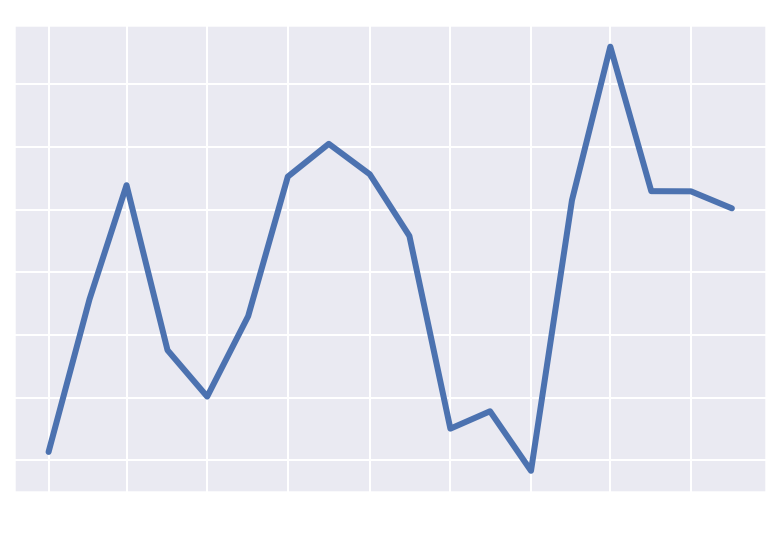

[침실 인테리어]


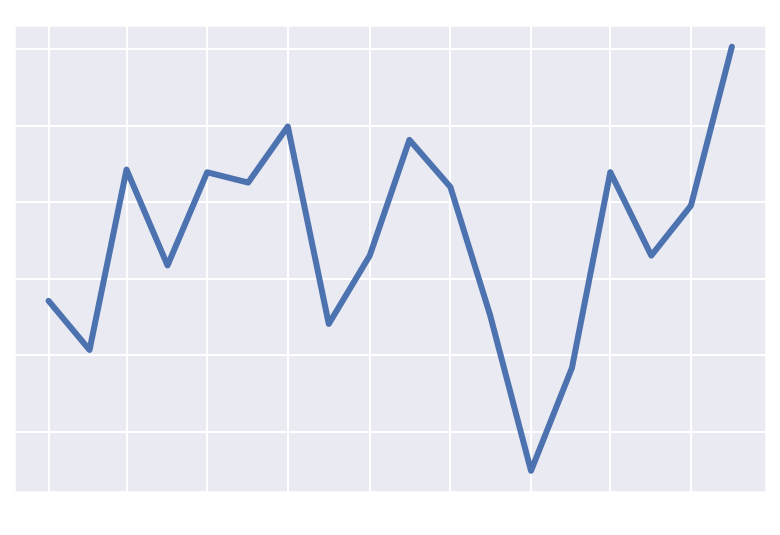

[카메라/캠코더]


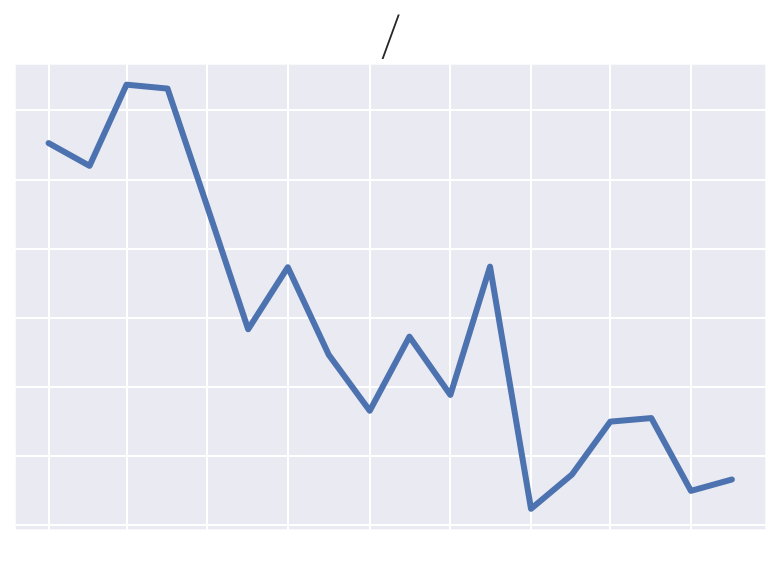

[캠핑용품]


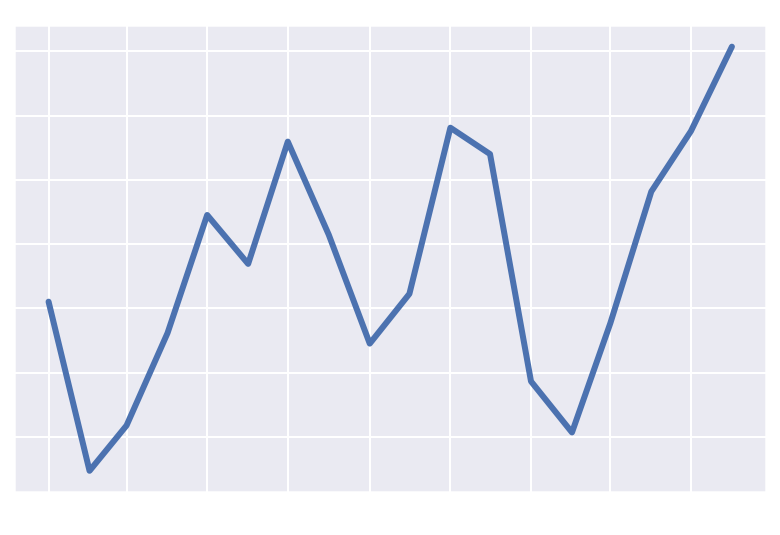

[테마의류]


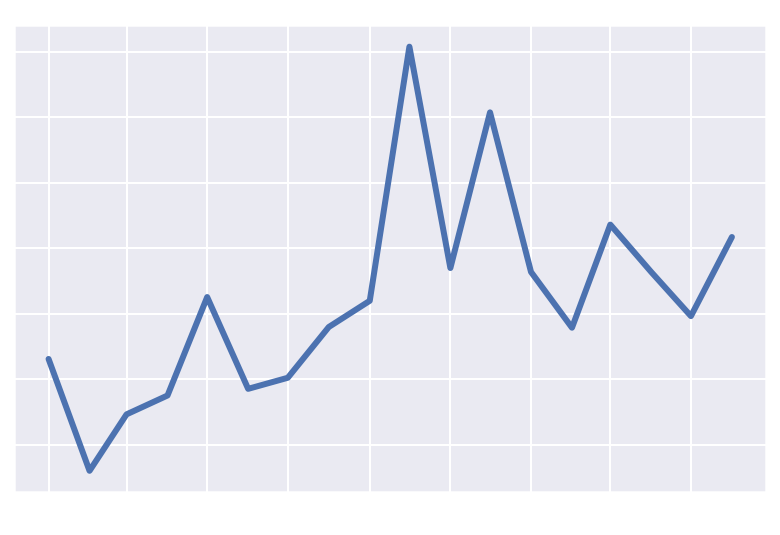

[헤어/바디케어]


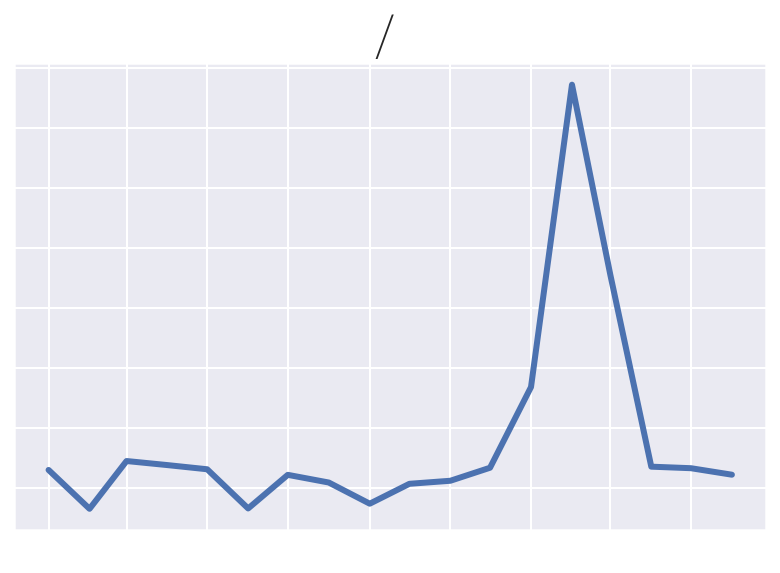

[헬스기구용품]


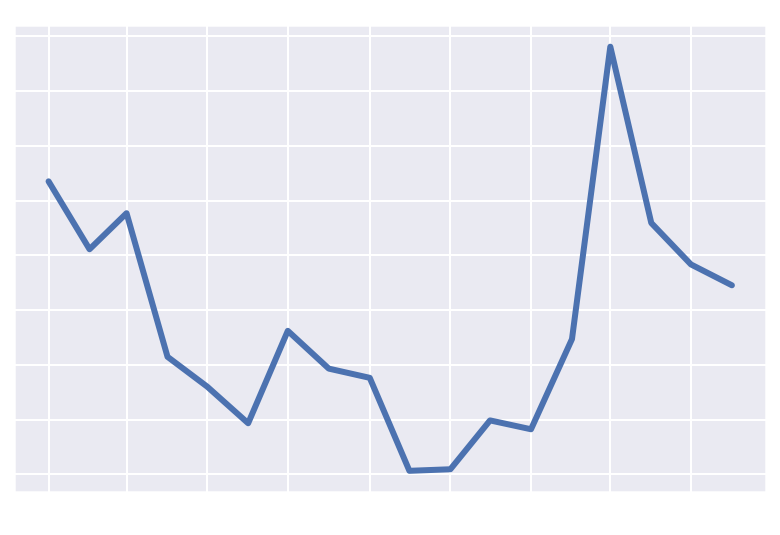

[휴대폰/악세서리]


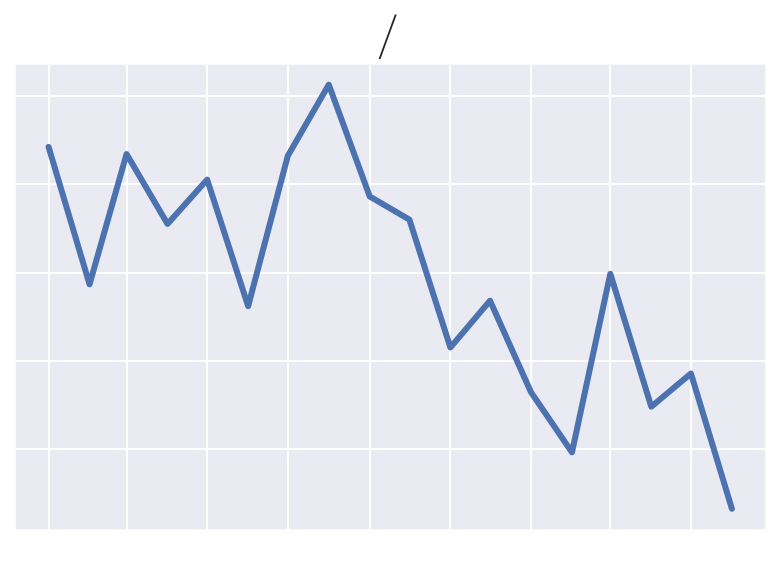

In [26]:
Category=cop['카테고리명'].unique().tolist()
M_Corp=cop.copy()
GM_Corp=M_Corp.groupby(["구매월", "카테고리명"]).sum().reset_index()
for i in range(len(Category)):
    print("["+Category[i]+"]")
    Cate_data=GM_Corp[GM_Corp["카테고리명"]==Category[i]]
    date=Cate_data["구매월"].apply(lambda x: str(x)+'01')
    date=pd.to_datetime(date)
    count=Cate_data["구매수"].tolist()
    plt.title(str(Category[i]))
    plt.xticks(rotation=20)
    if not os.path.exists('./figures') : os.makedirs('./figures/')
    plt.savefig('./figures/' + Category[i].replace("/", "")+'.jpg')
    plt.plot(date, count, linewidth=3)
    plt.show()

## 업종 및 연령별 소비 동향

[PC/사무기기]


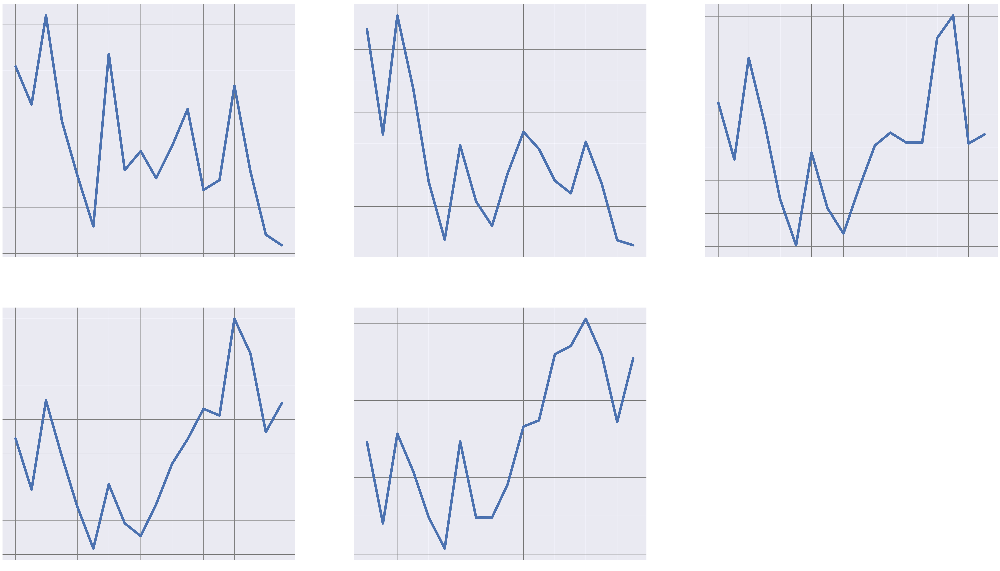

[TV/홈시어터]


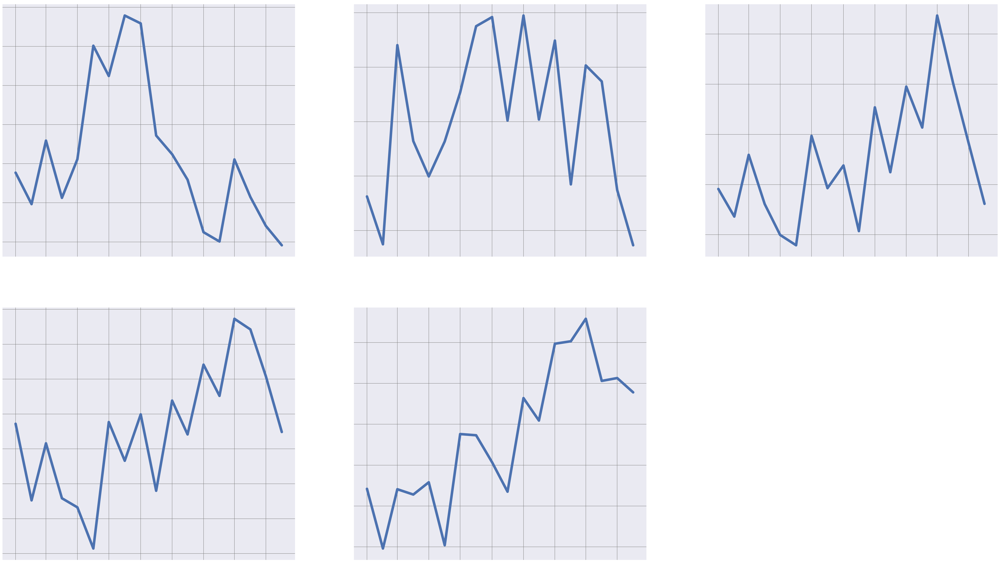

[가공식품]


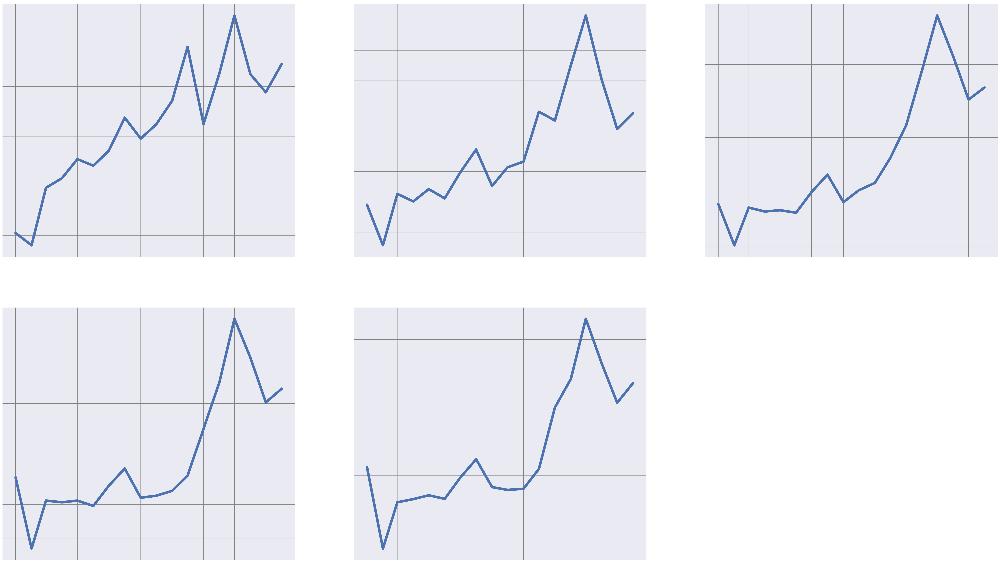

[가방/지갑/잡화]


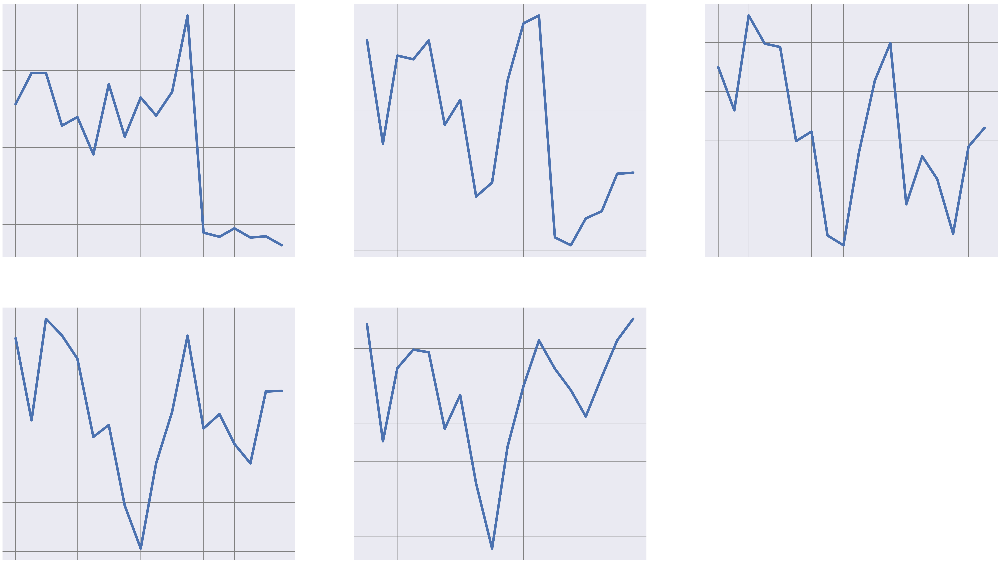

[건강 관련용품]


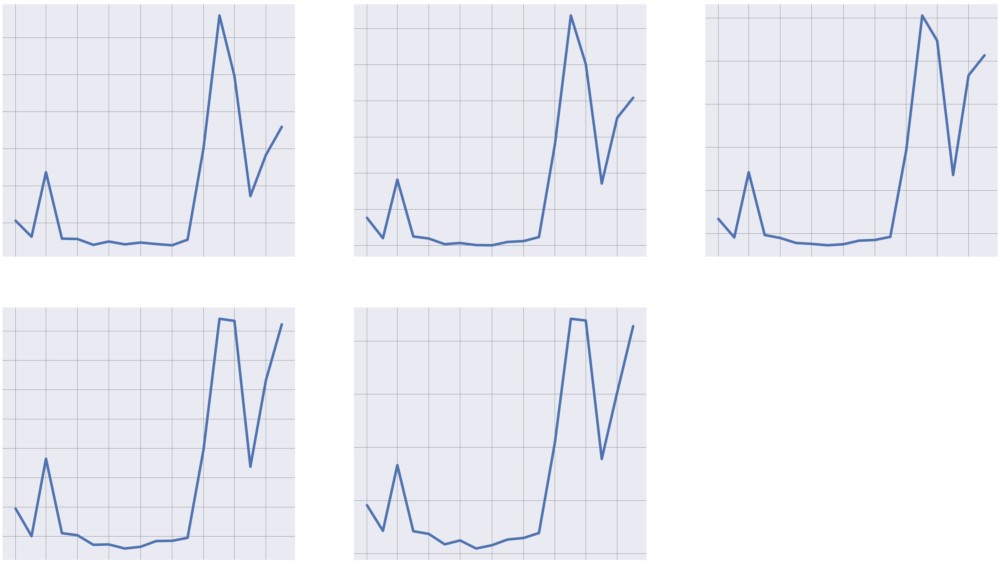

[건강식품]


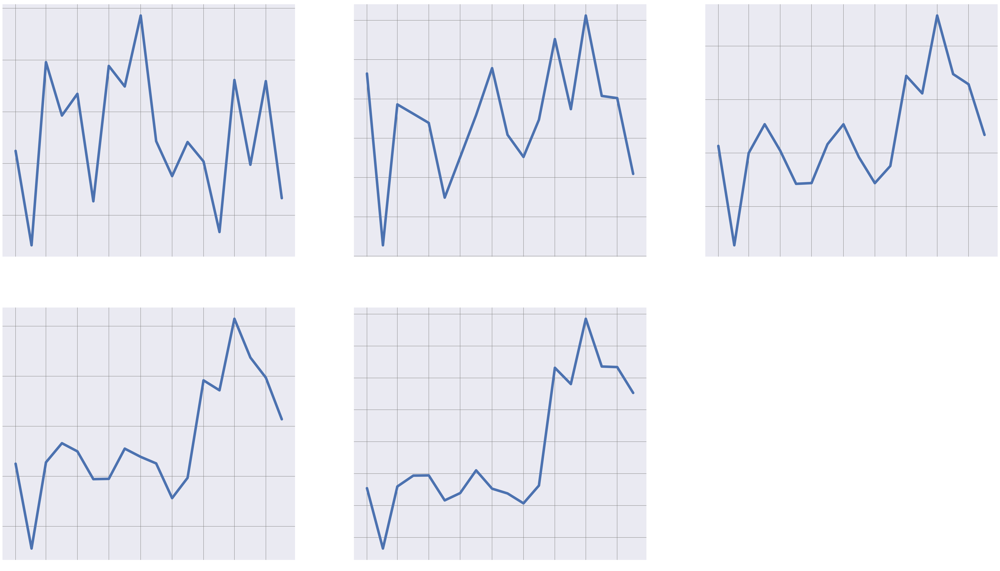

[계절가전]


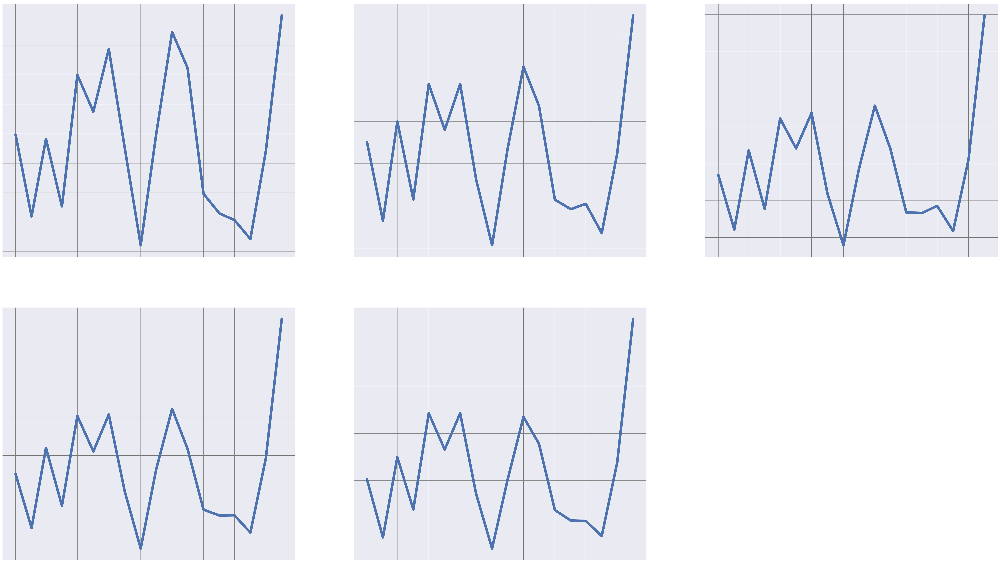

[골프용품]


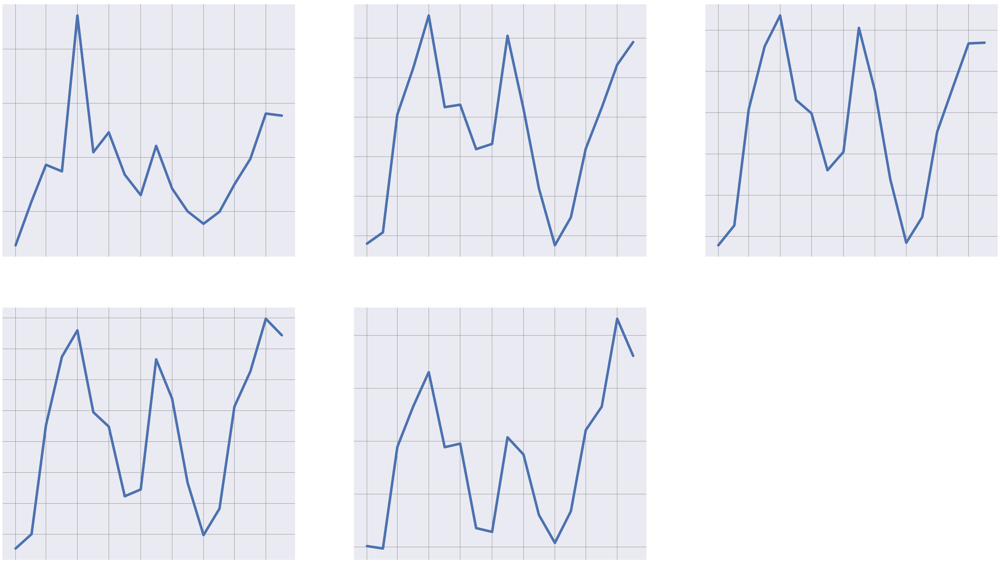

[공구류]


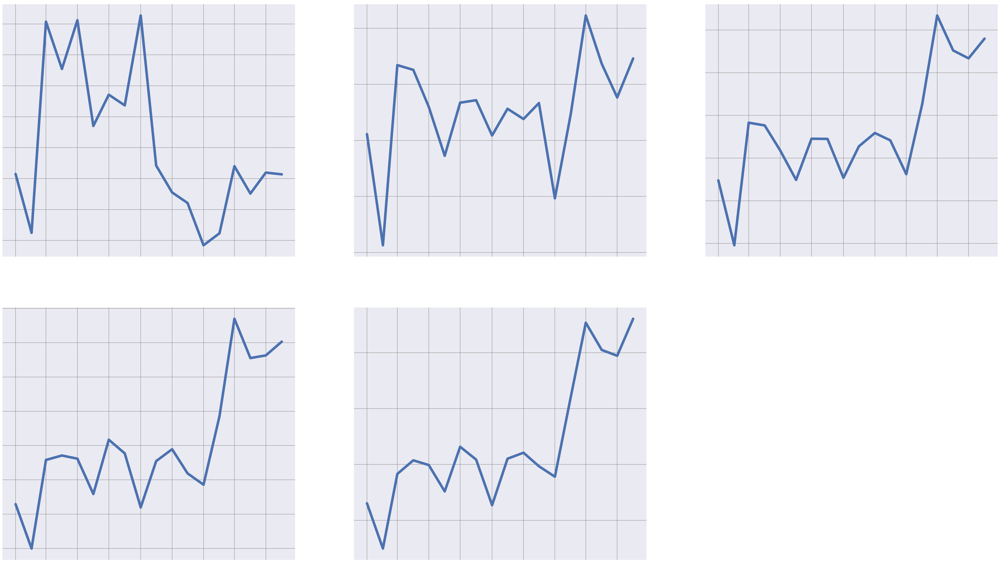

[구기종목 용품]


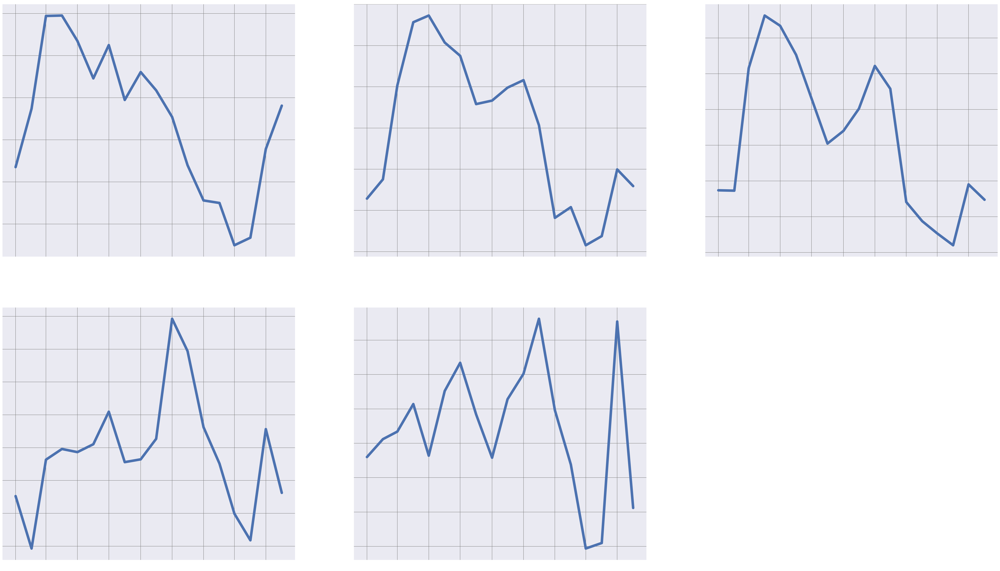

[국내외여행]


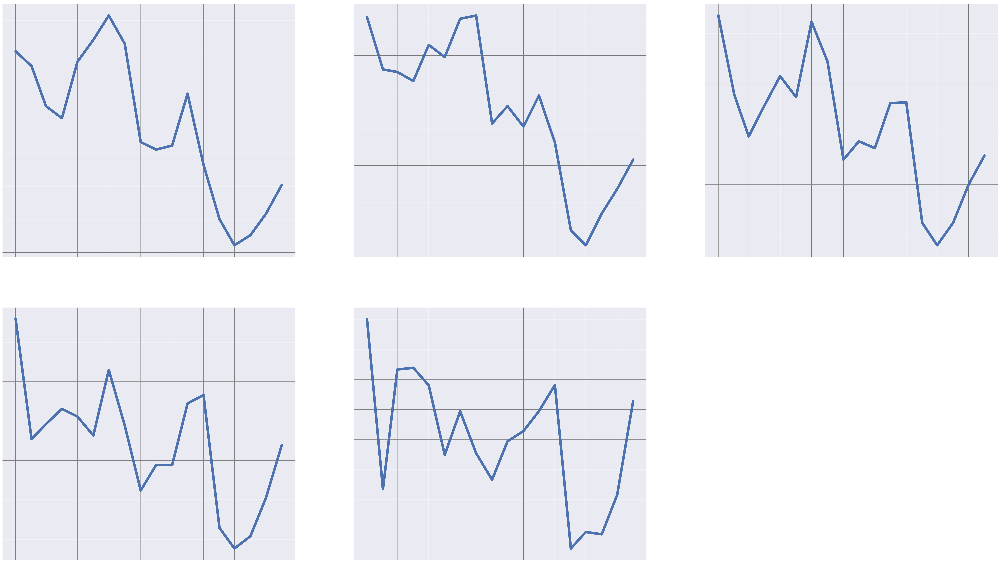

[기타 스포츠/스포츠 용품]


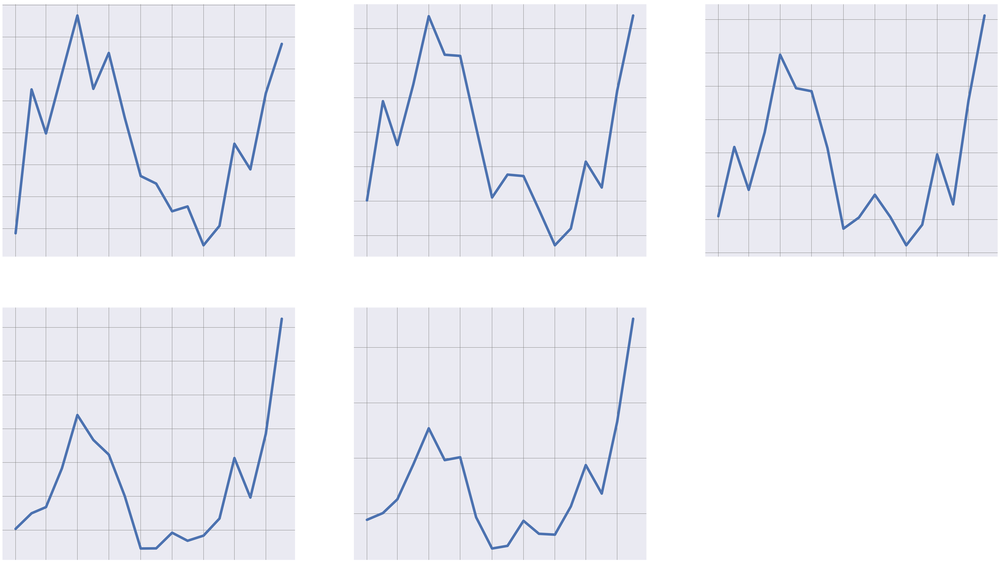

[낚시용품]


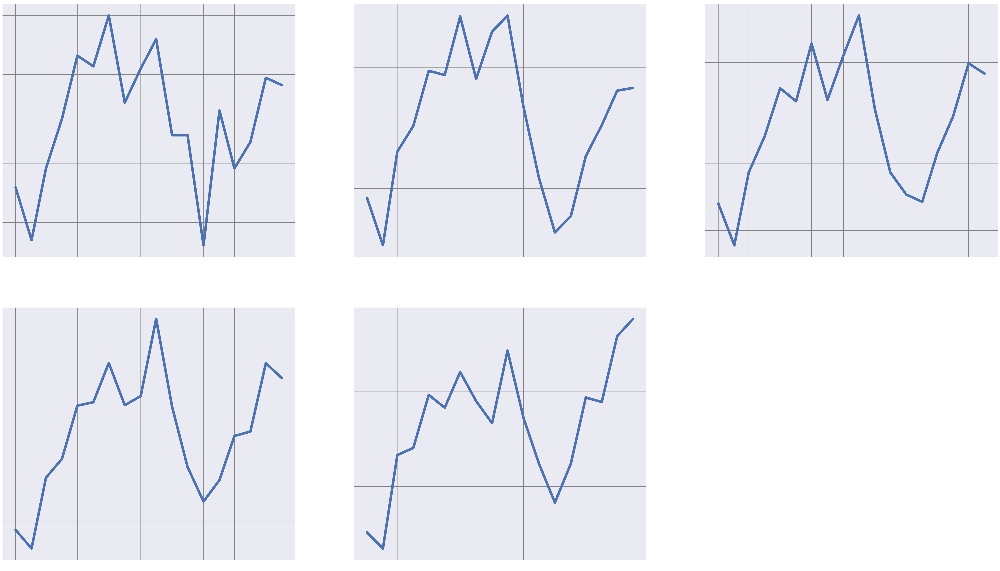

[남성의류]


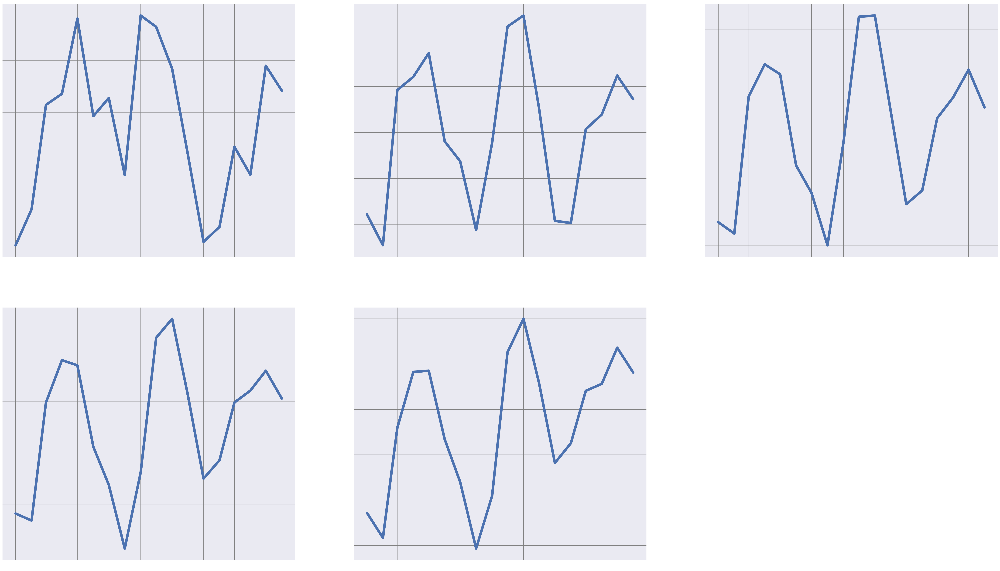

[노트북/태블릿/학습가전]


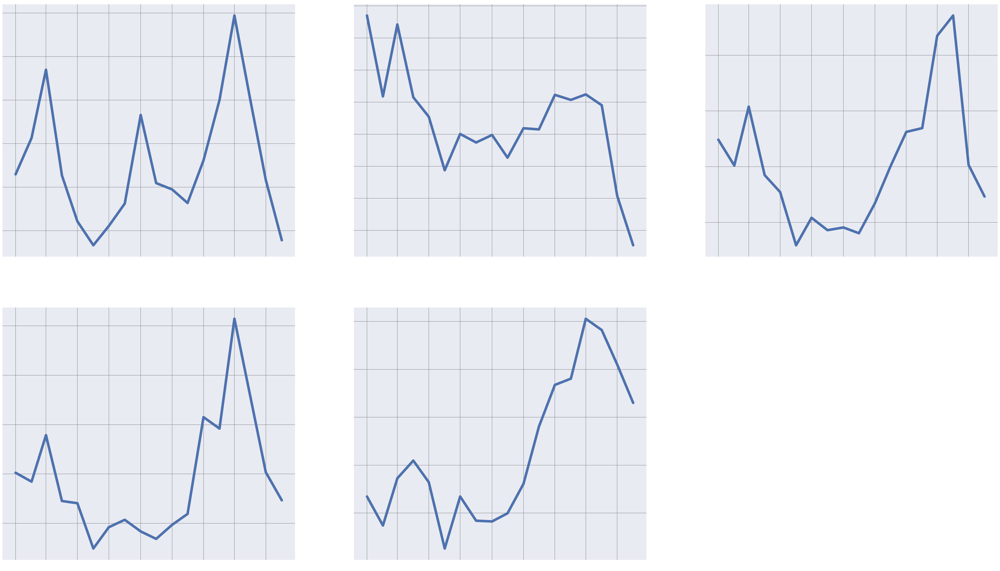

[농축수산물]


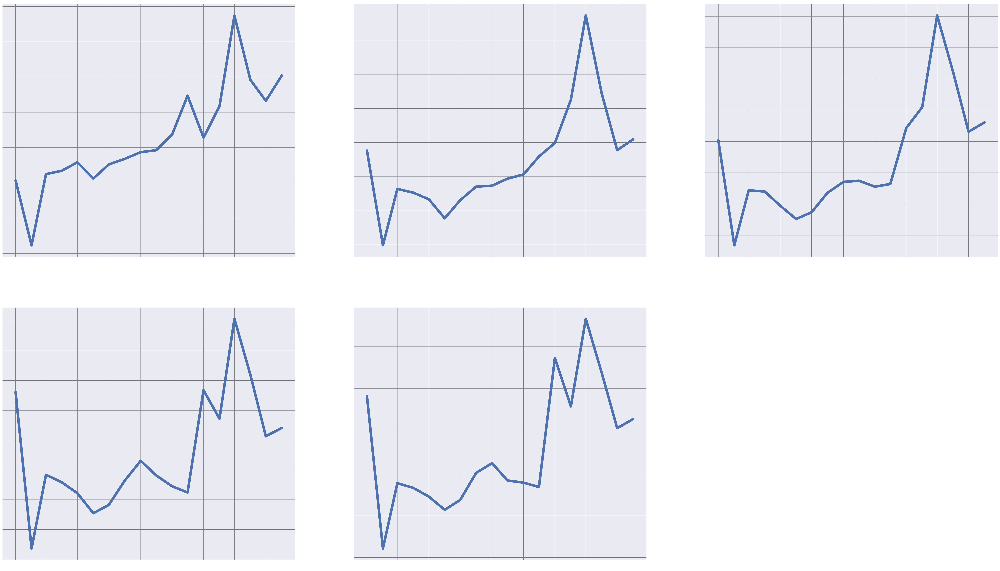

[도서/음반/DVD]


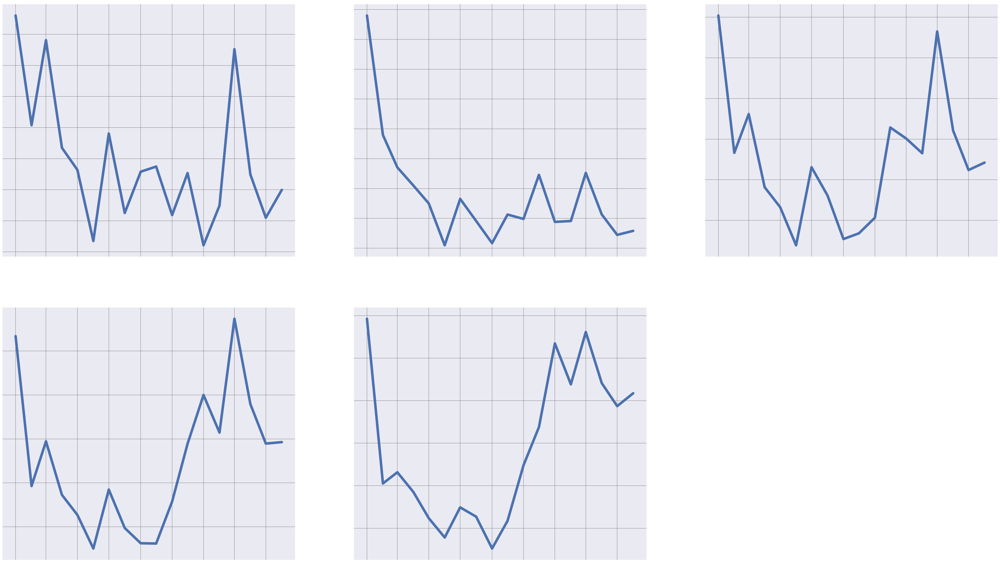

[등산용품]


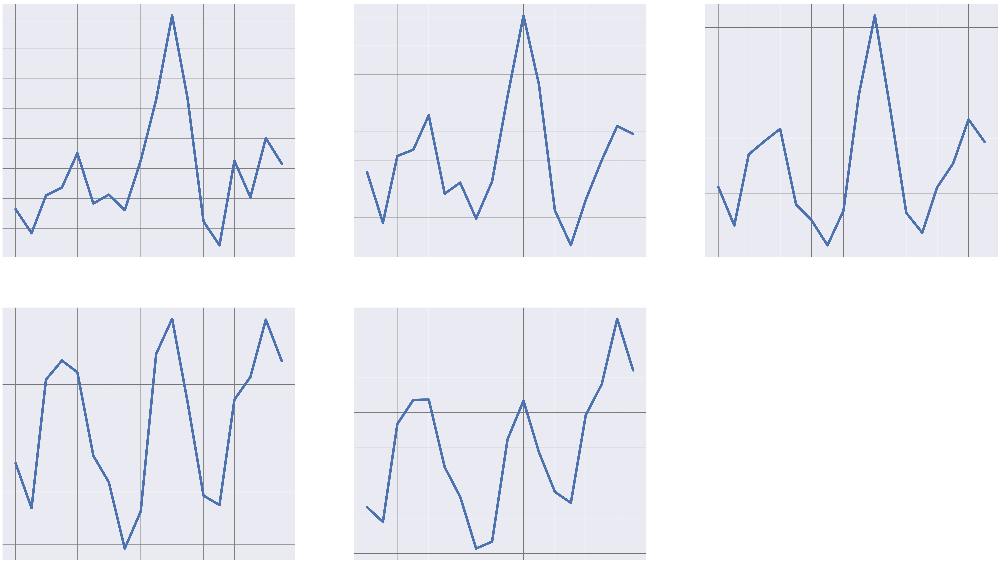

[메이크업 용품]


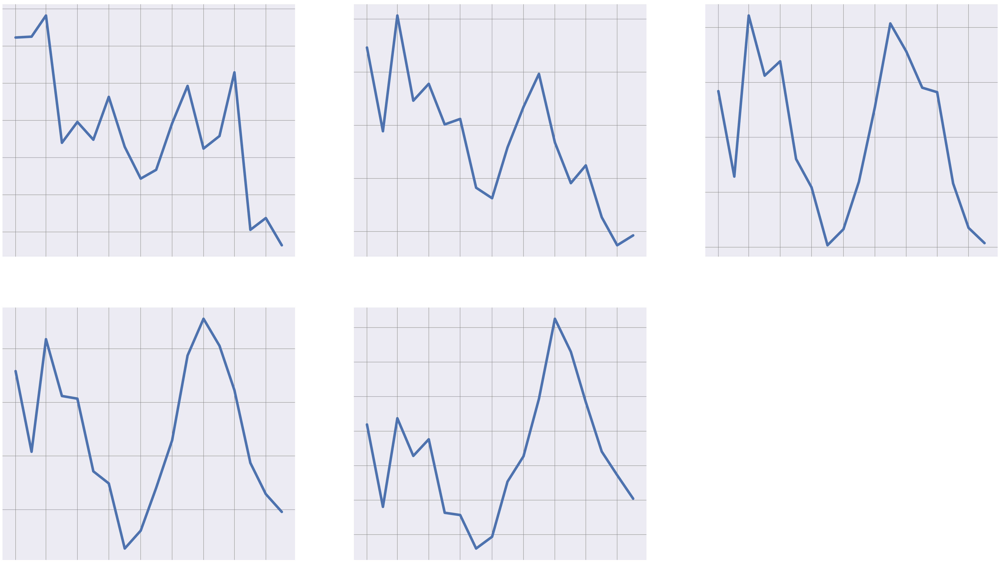

[문구/사무용품]


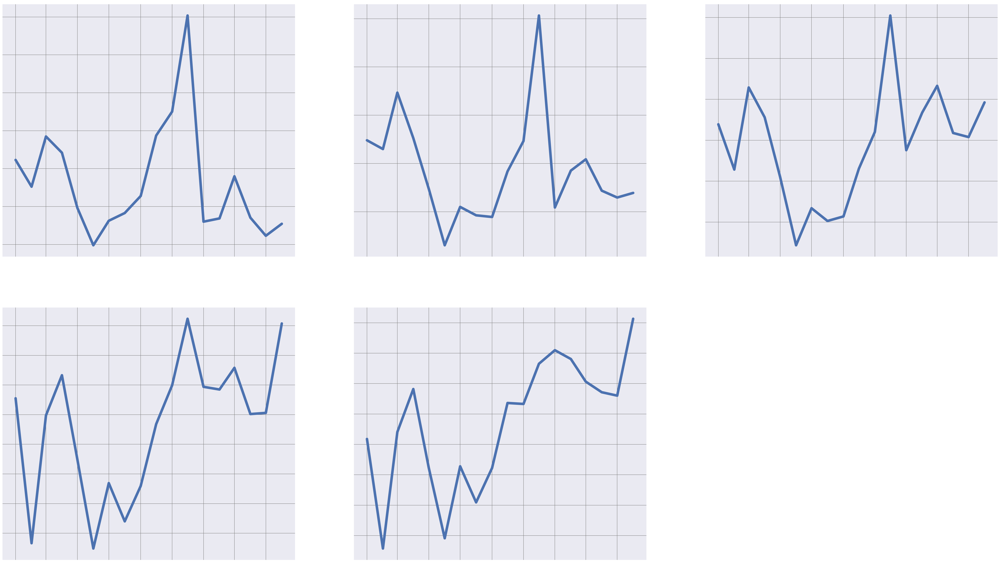

[미용가전/안마기]


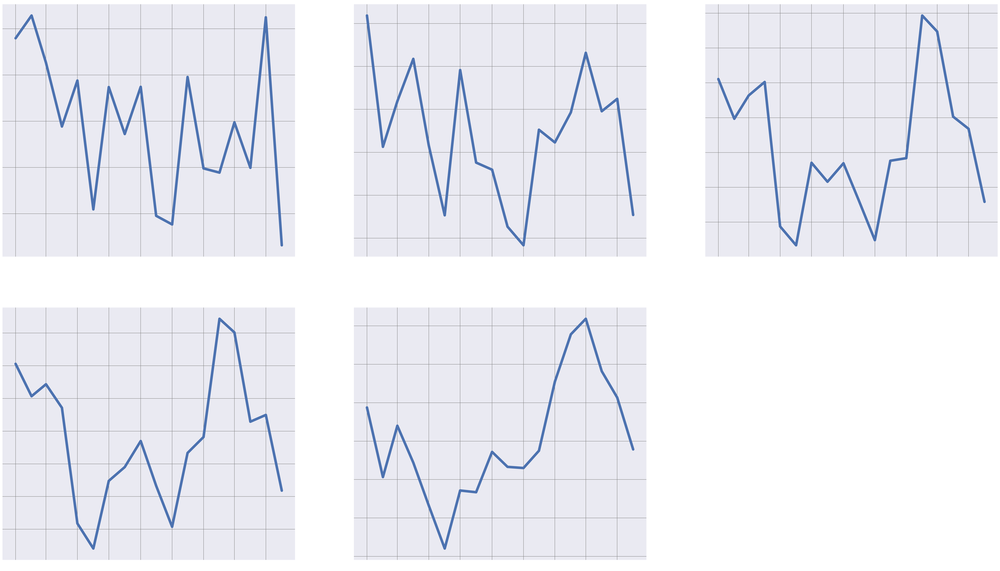

[반려동물용품]


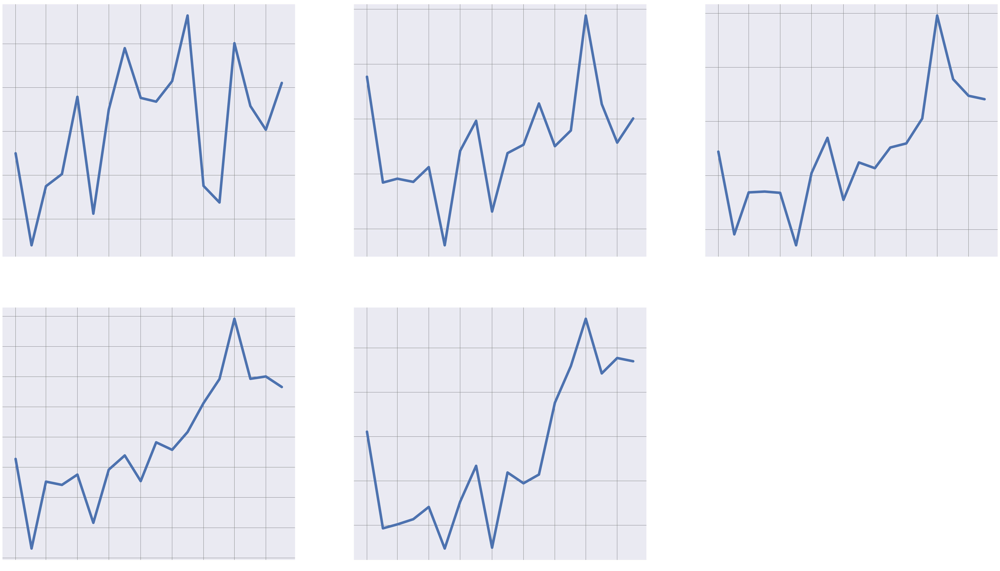

[생활 가구]


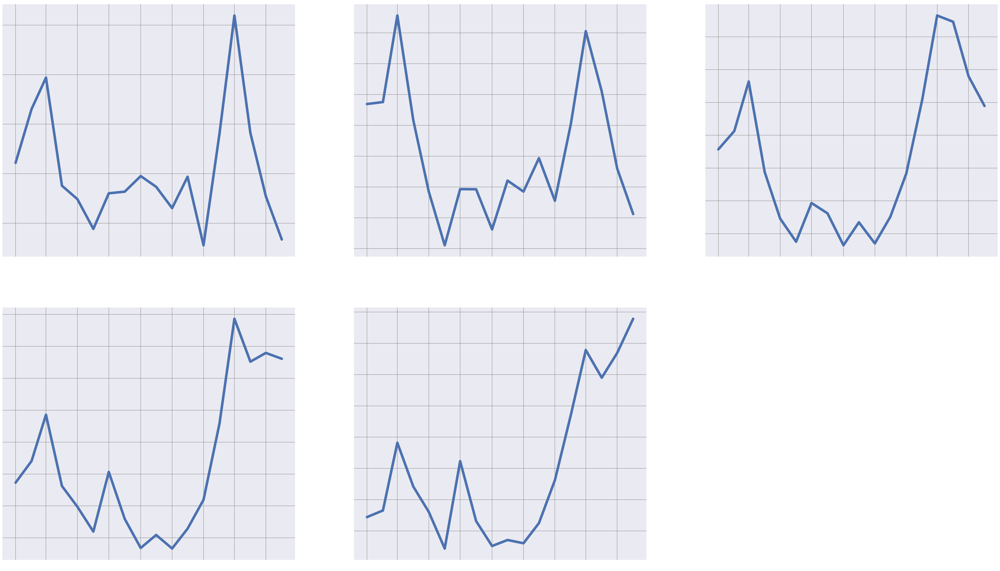

[생활 가전]


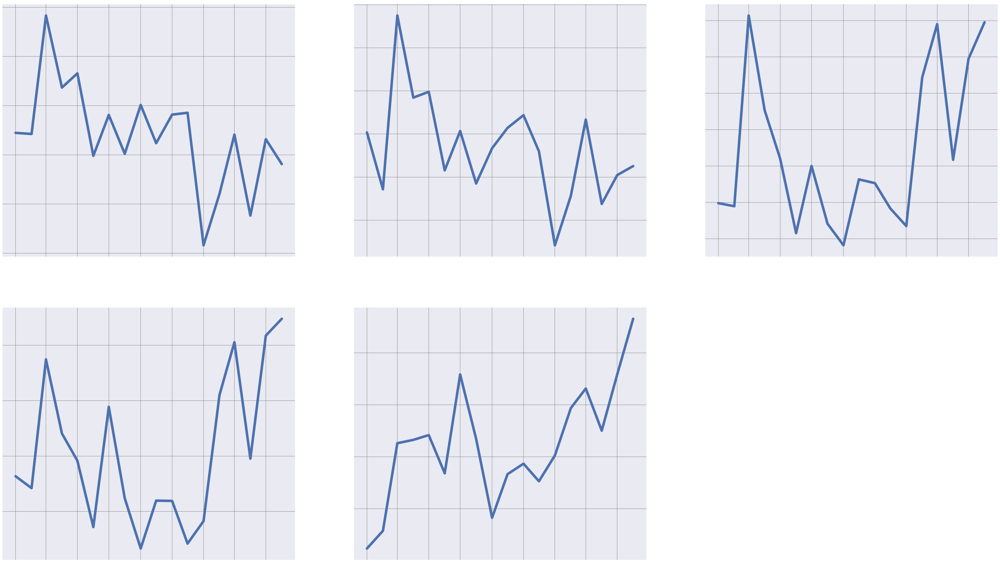

[생활용품]


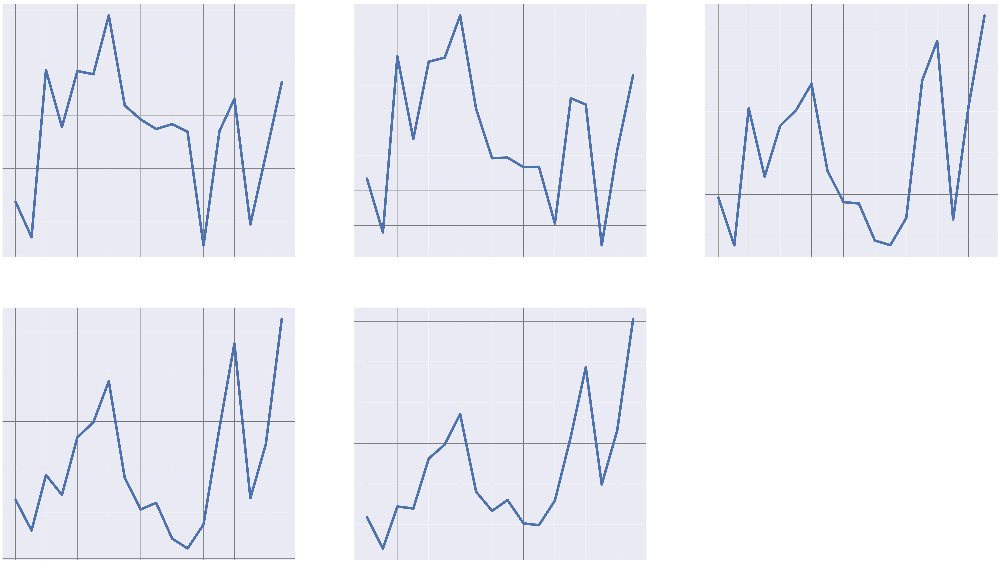

[서비스/티켓]


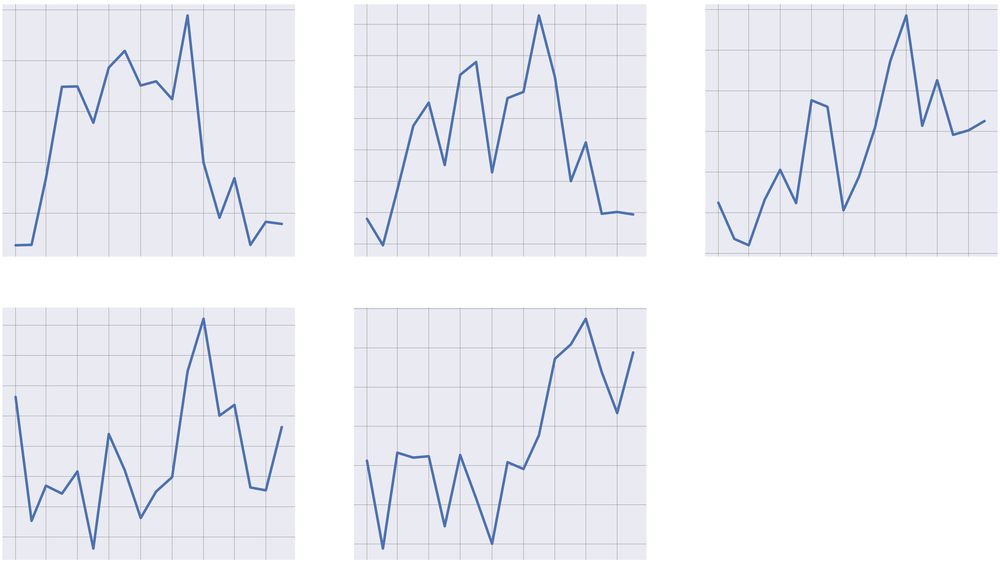

[성인용품]


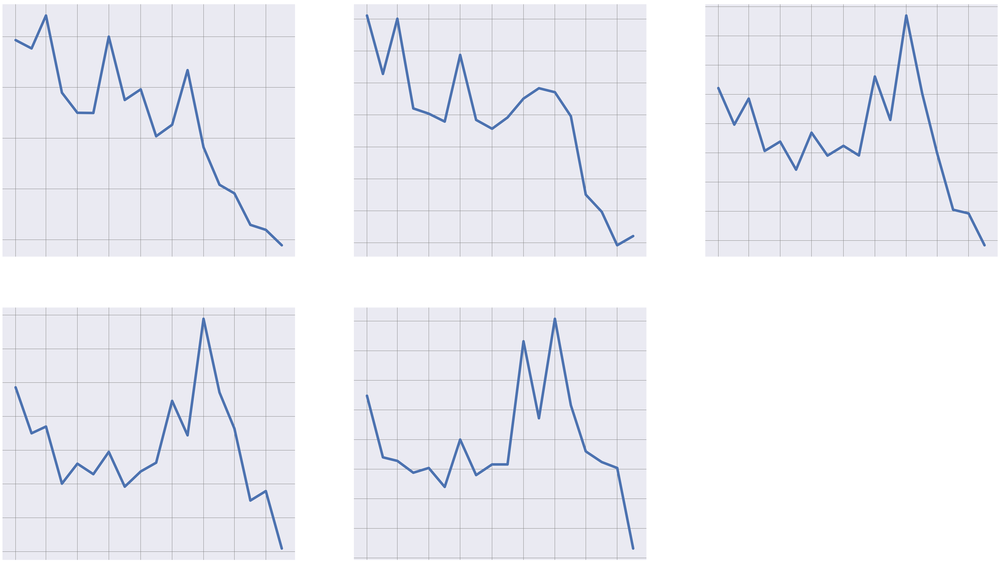

[세탁/청소/세면 용품]


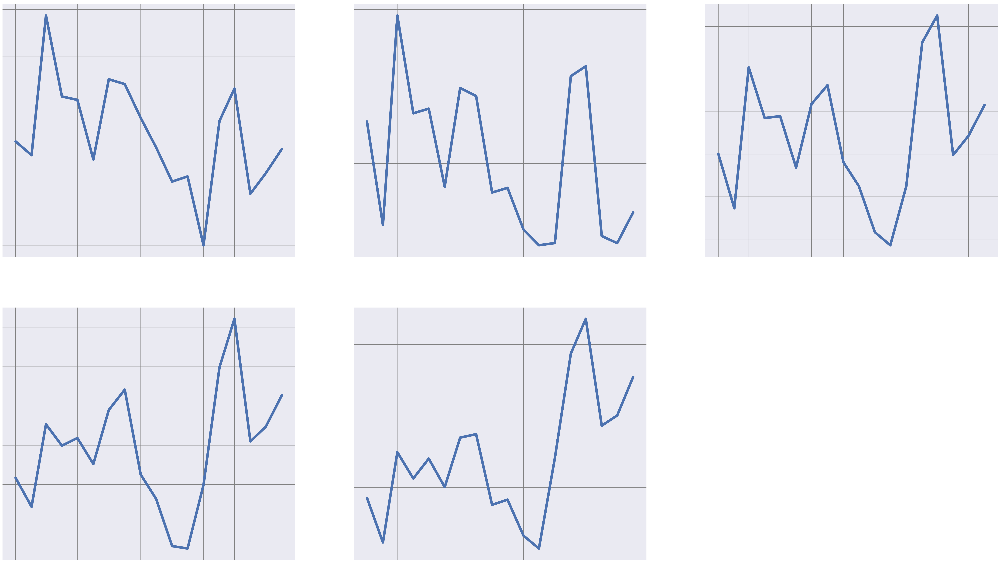

[수납가구]


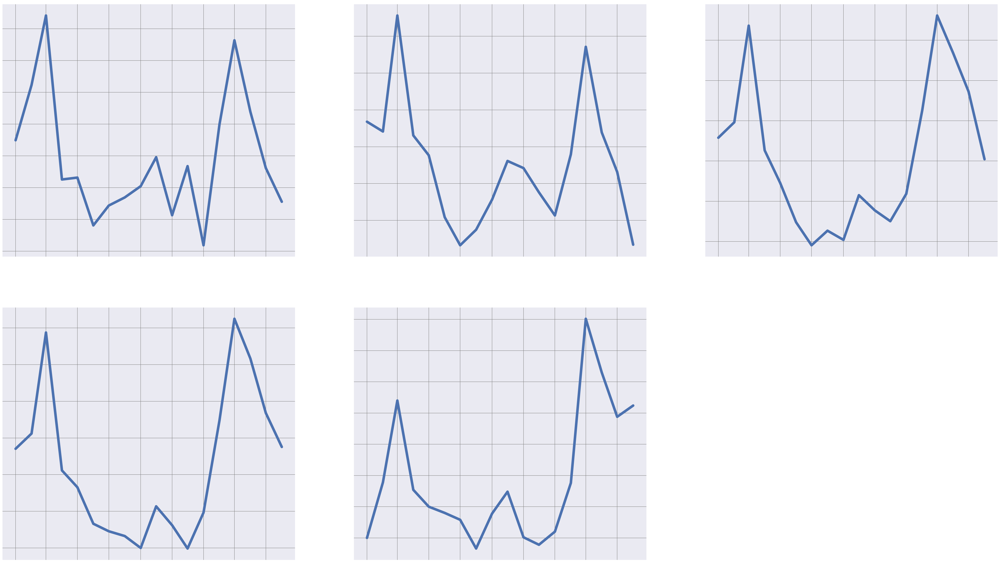

[수납용품]


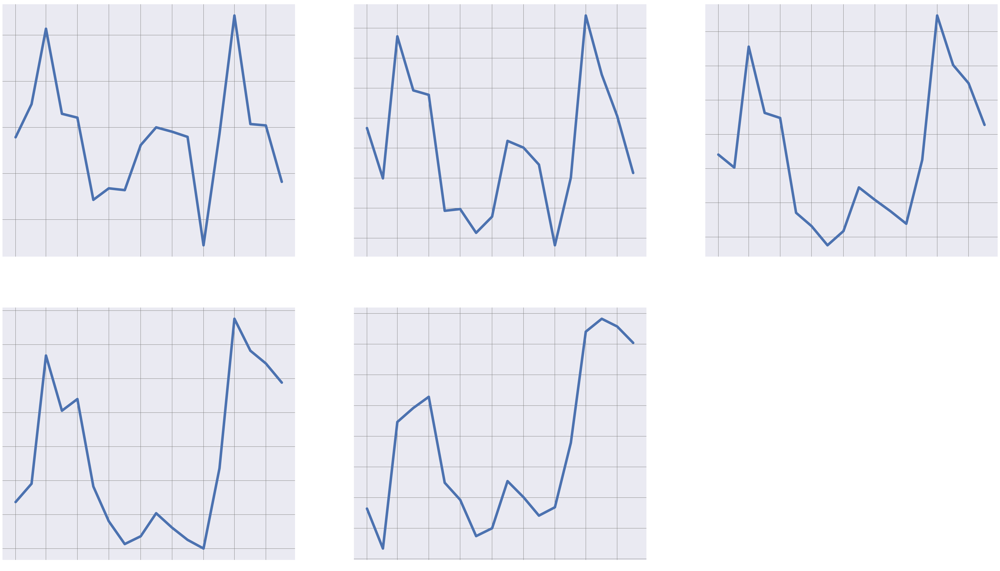

[수영용품]


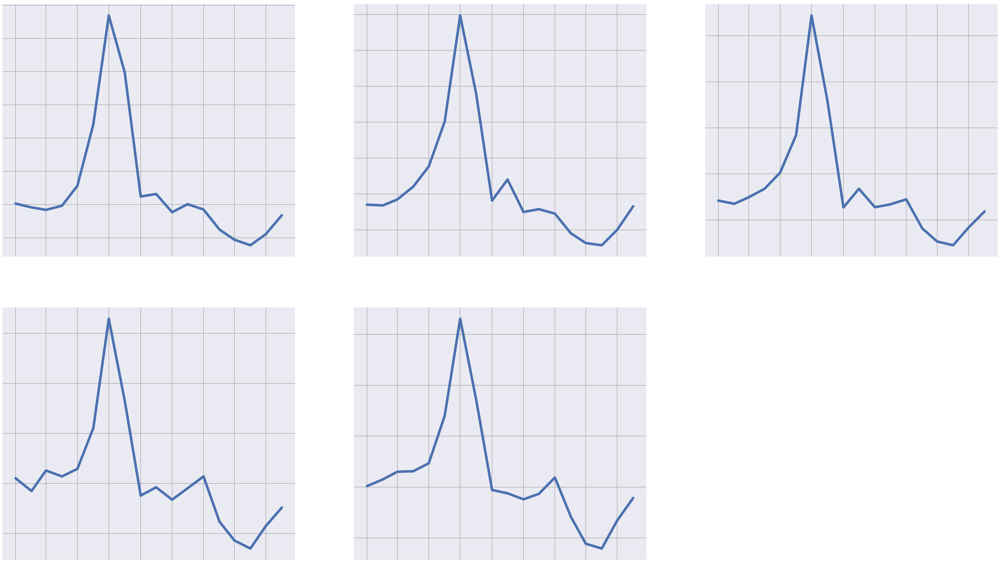

[스키/보드용품]


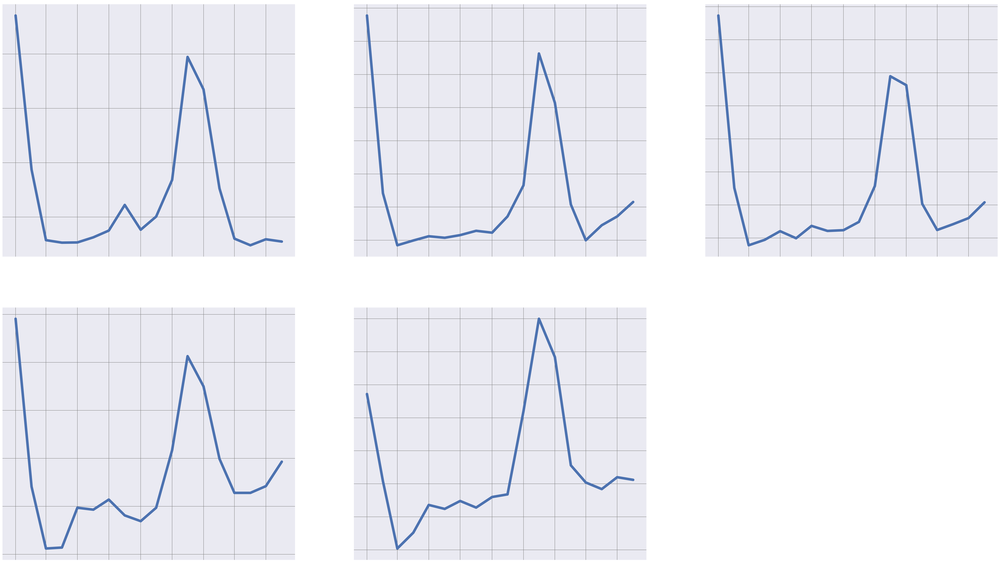

[스킨케어]


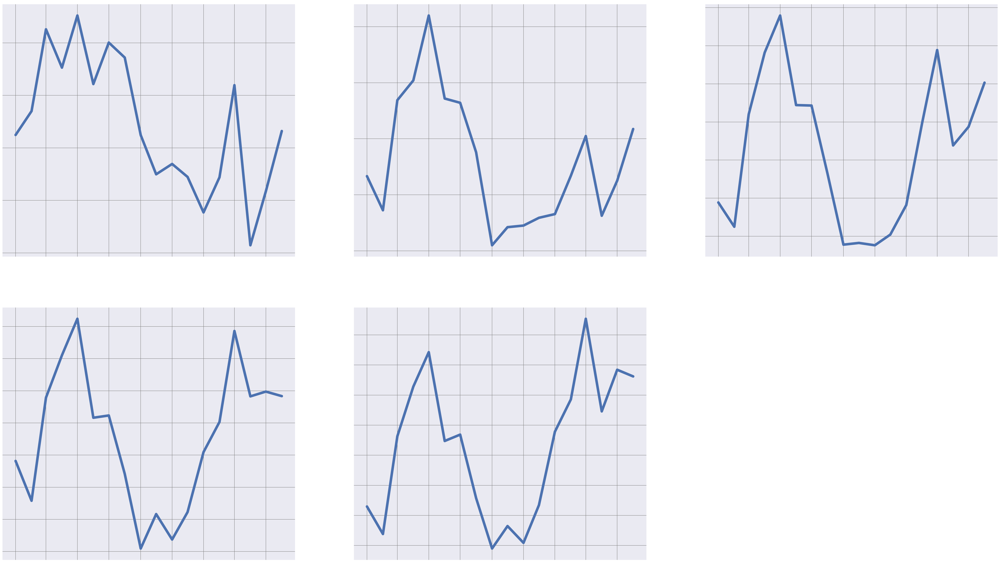

[스포츠의류/잡화]


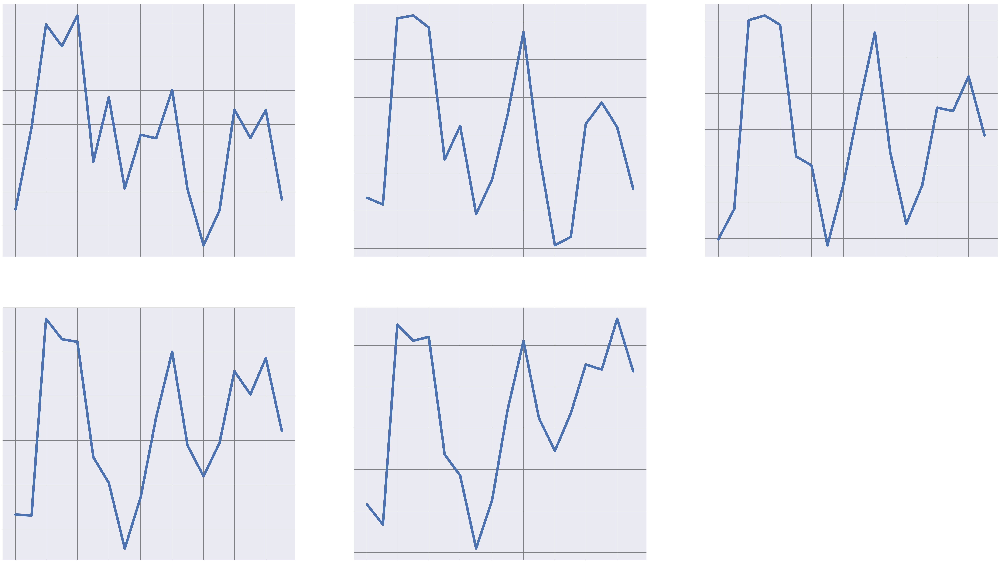

[신발]


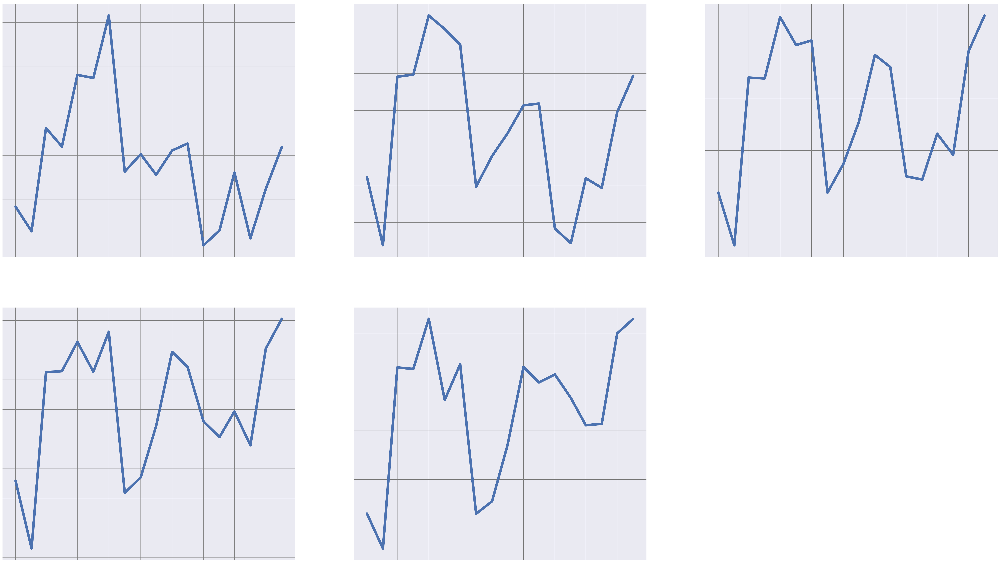

[악세서리/시계/주얼리]


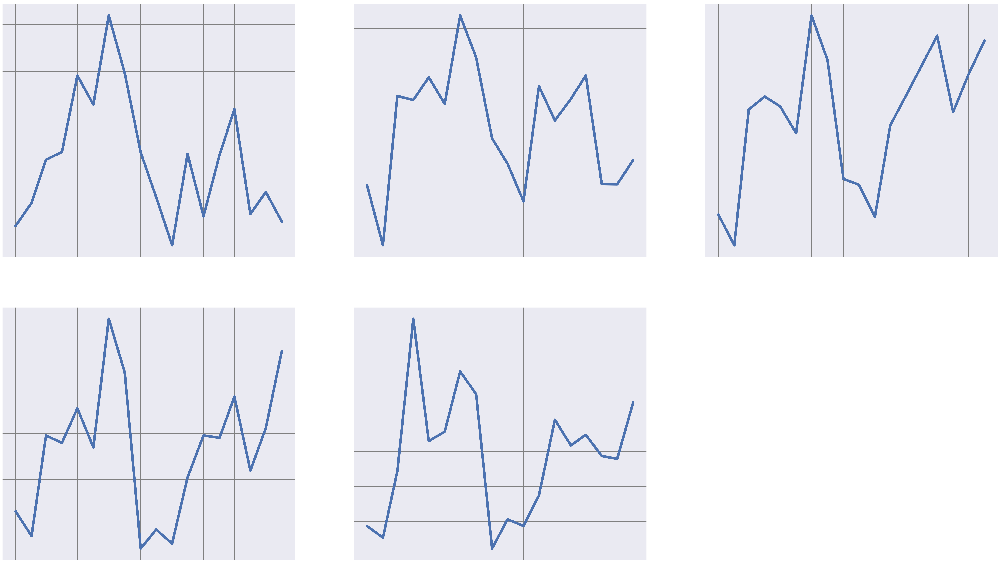

[안전용품]


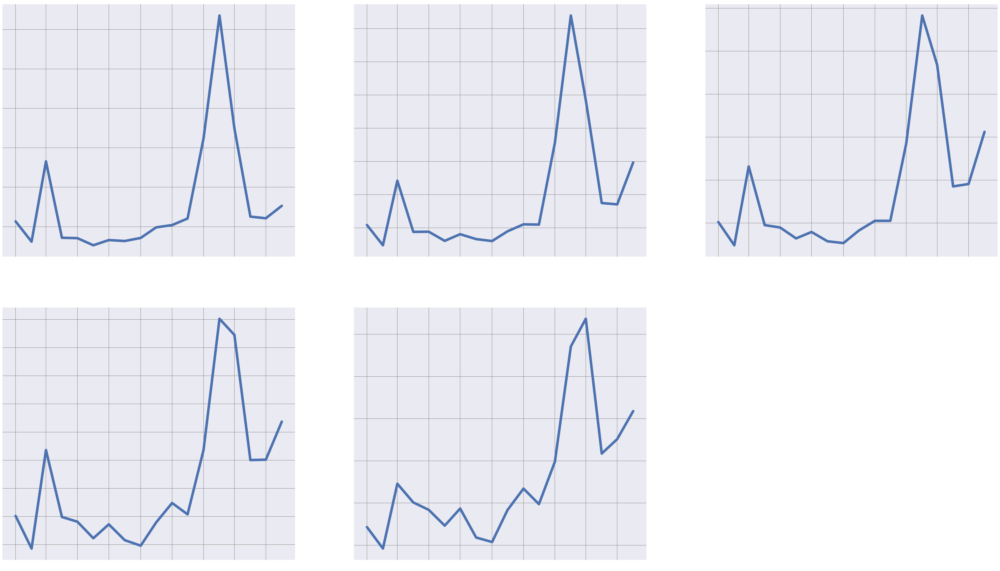

[언더웨어]


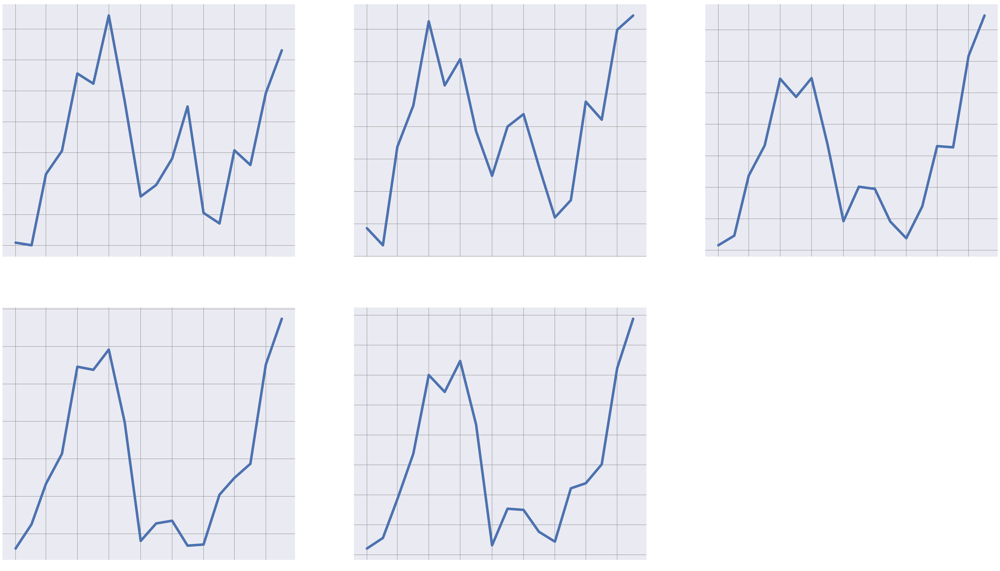

[업소 위생용품]


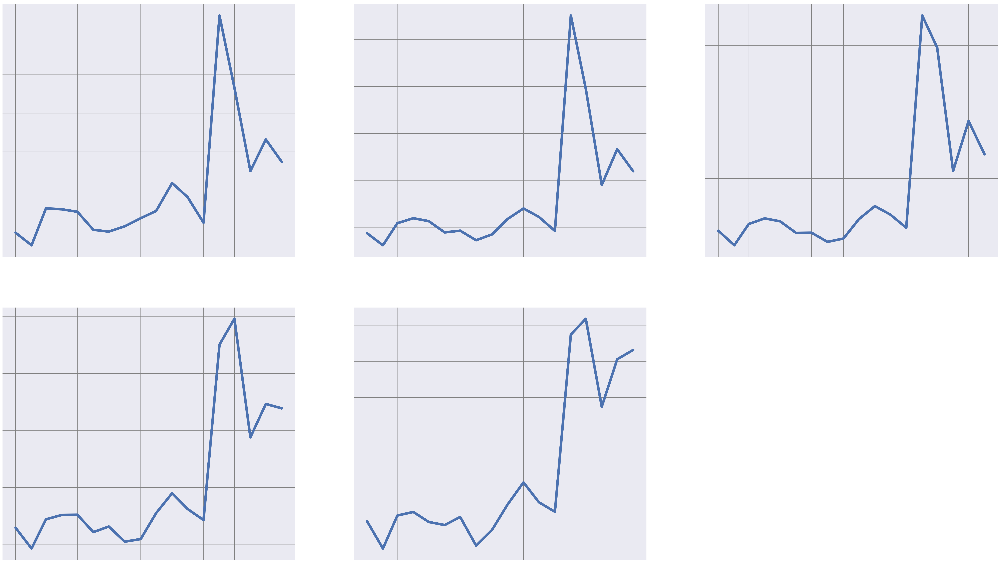

[여성의류]


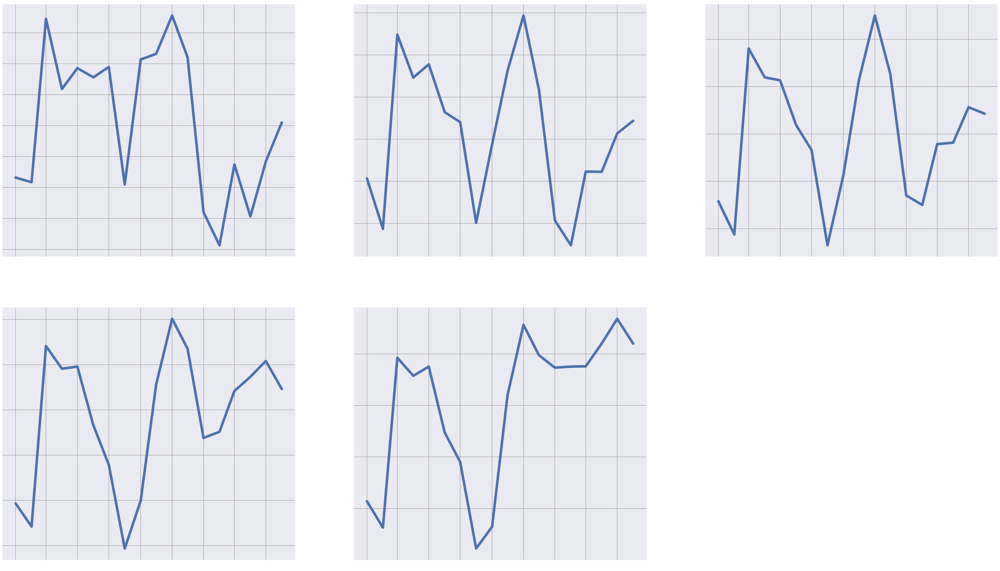

[완구/키덜트/게임]


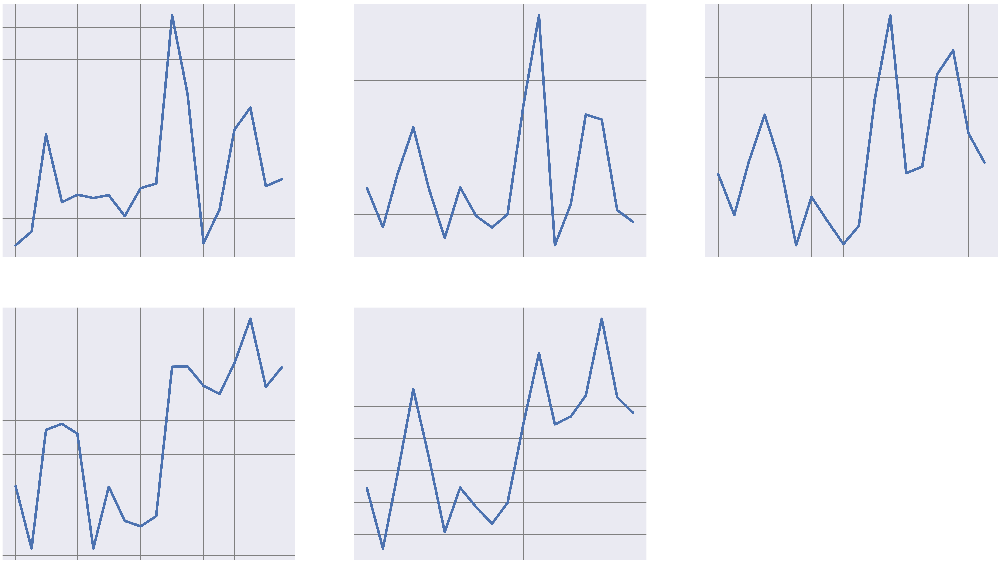

[욕실가전]


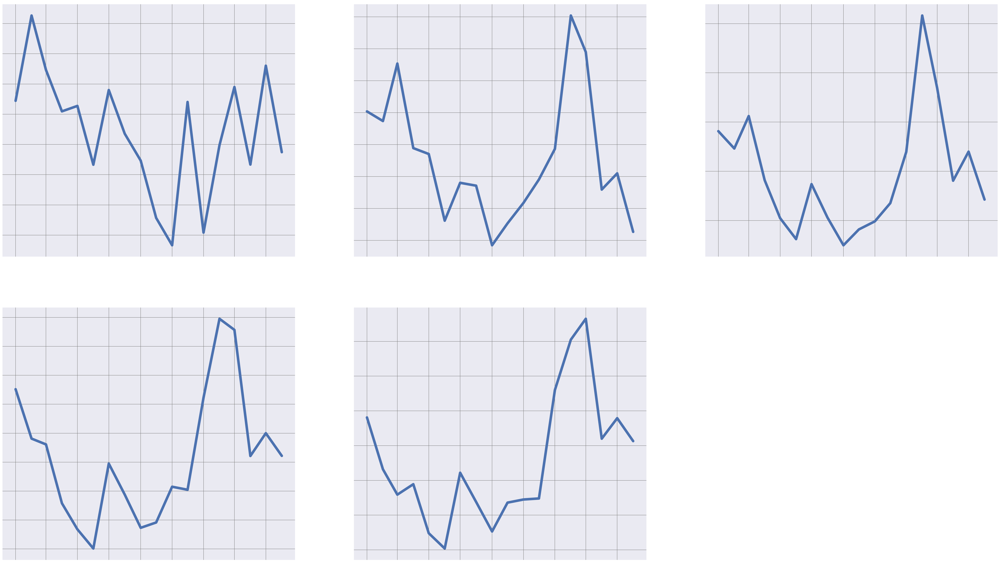

[욕실용품]


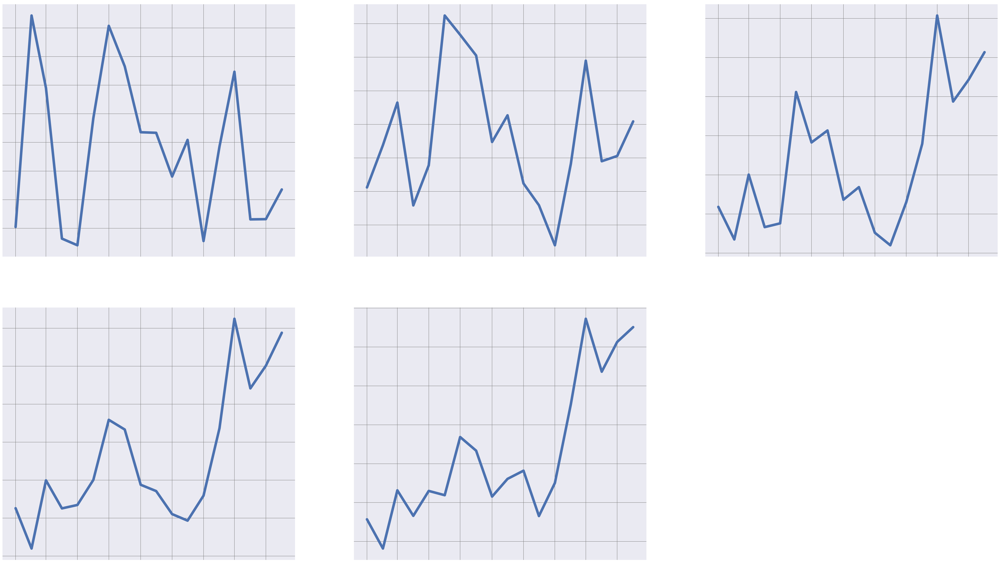

[유아/아동용품]


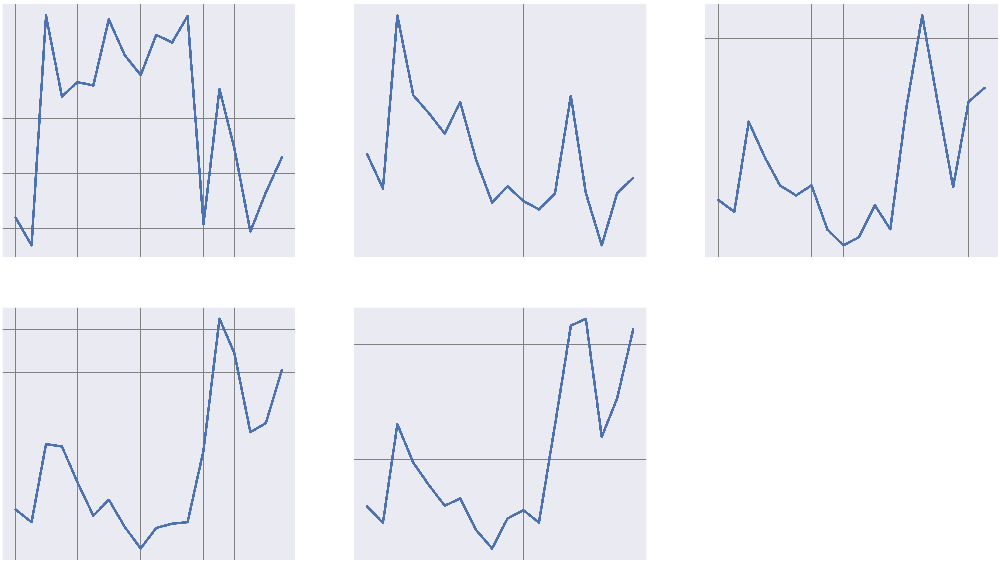

[유아/아동의류]


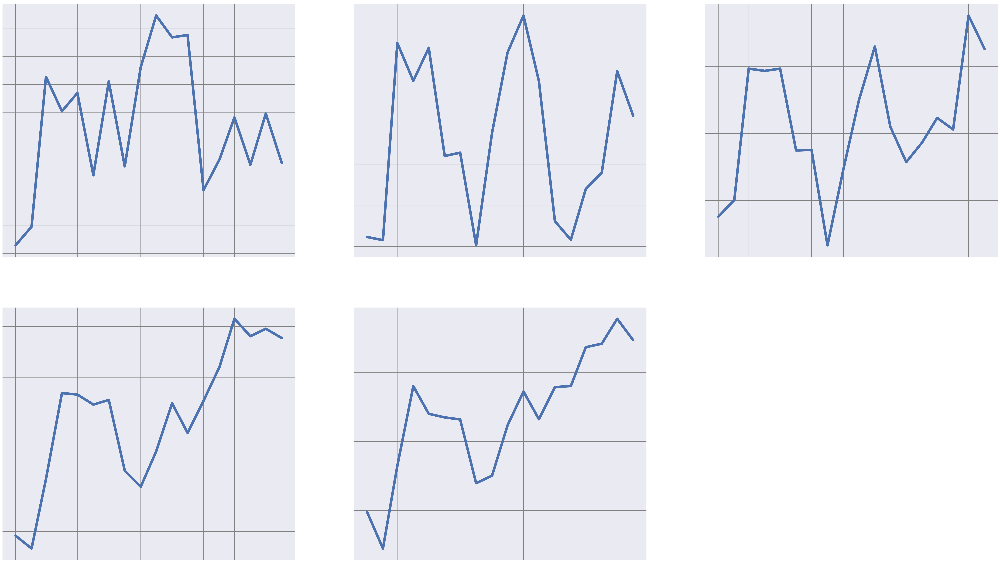

[음료]


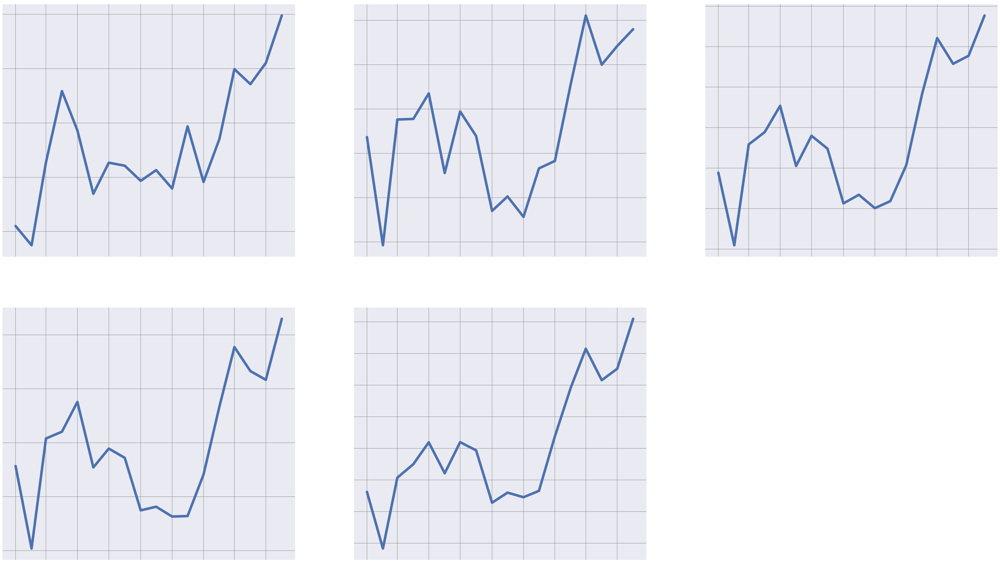

[음향가전]


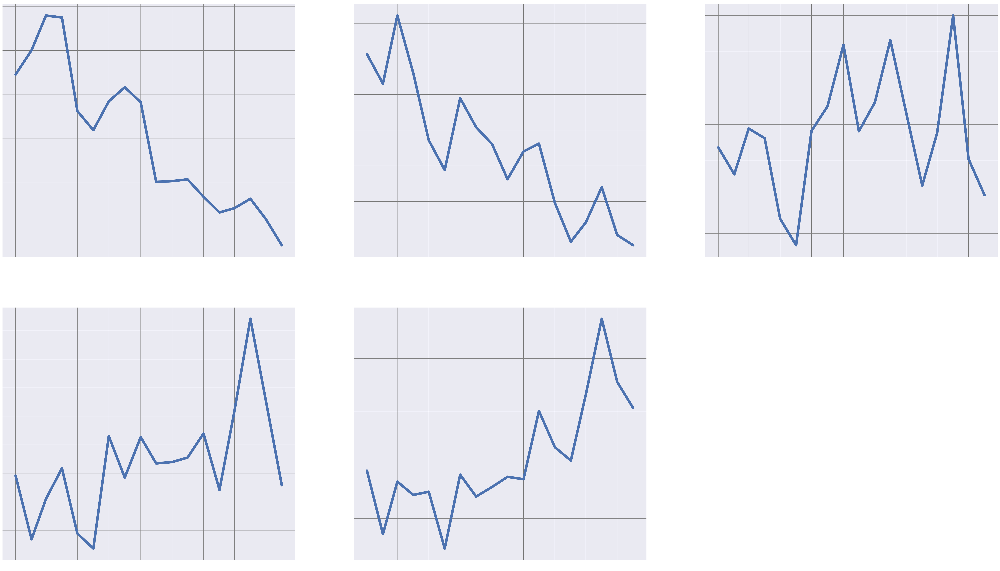

[인테리어용품]


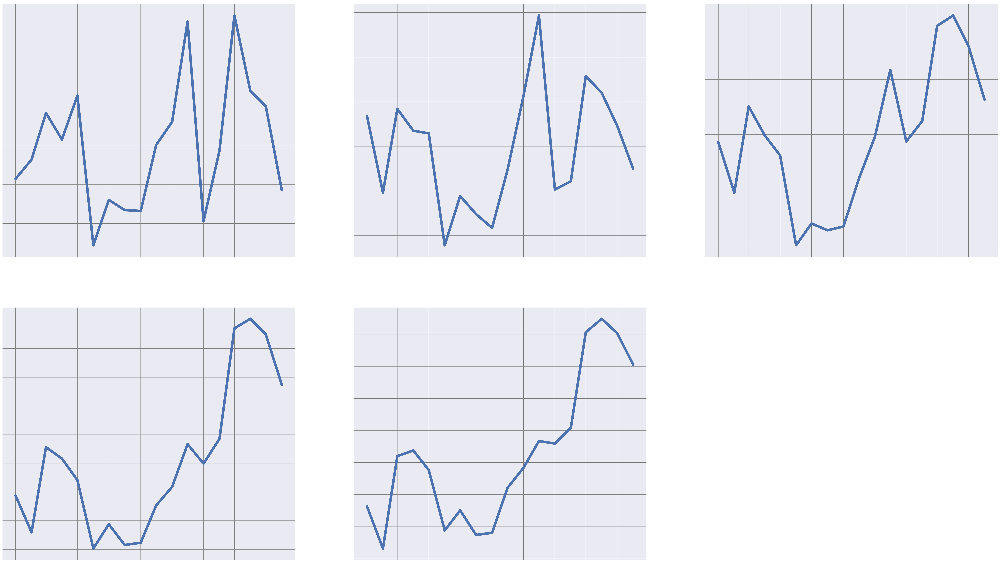

[자동차 관련용품]


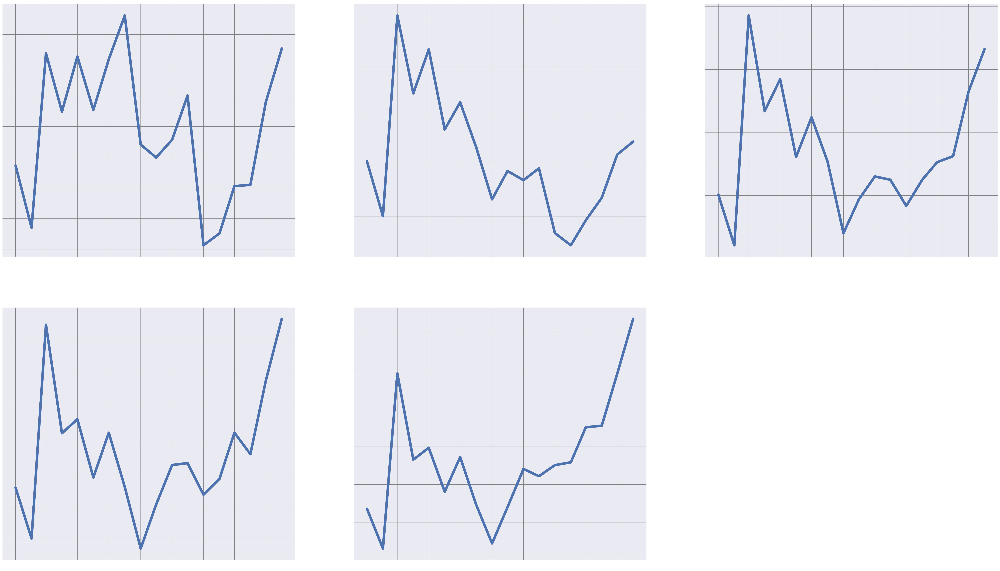

[자전거/사이클/보드/인라인]


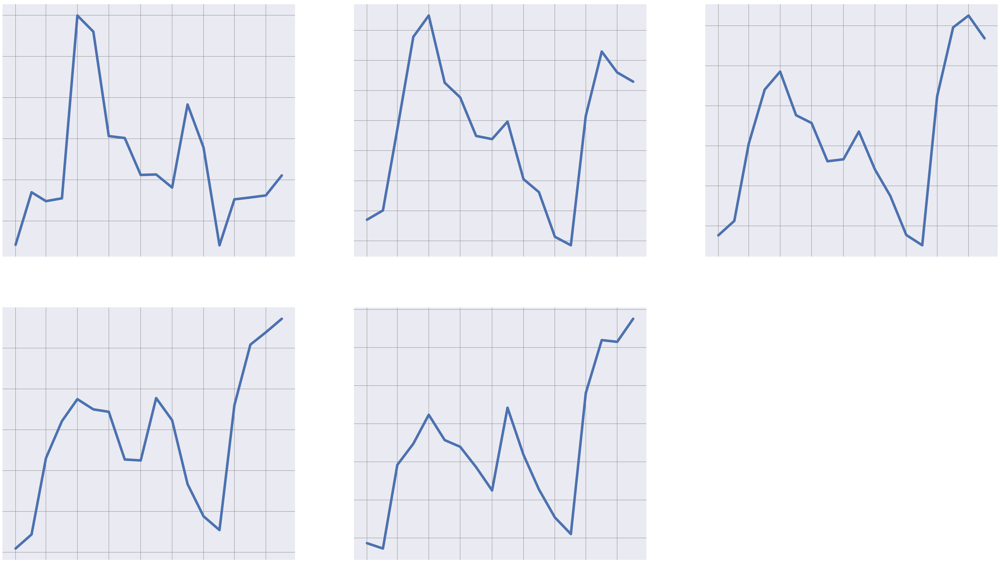

[주방가전]


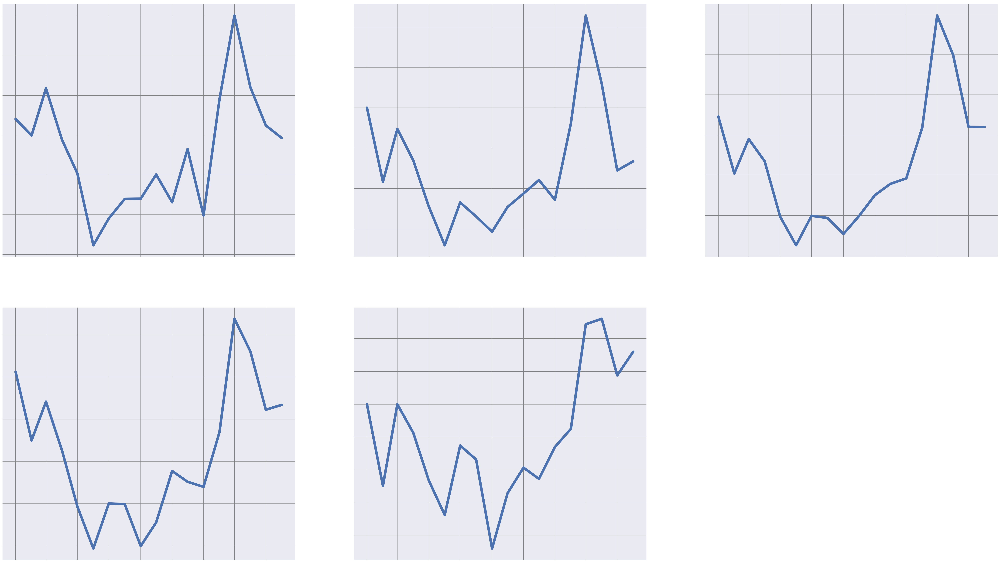

[주방수납/잡화]


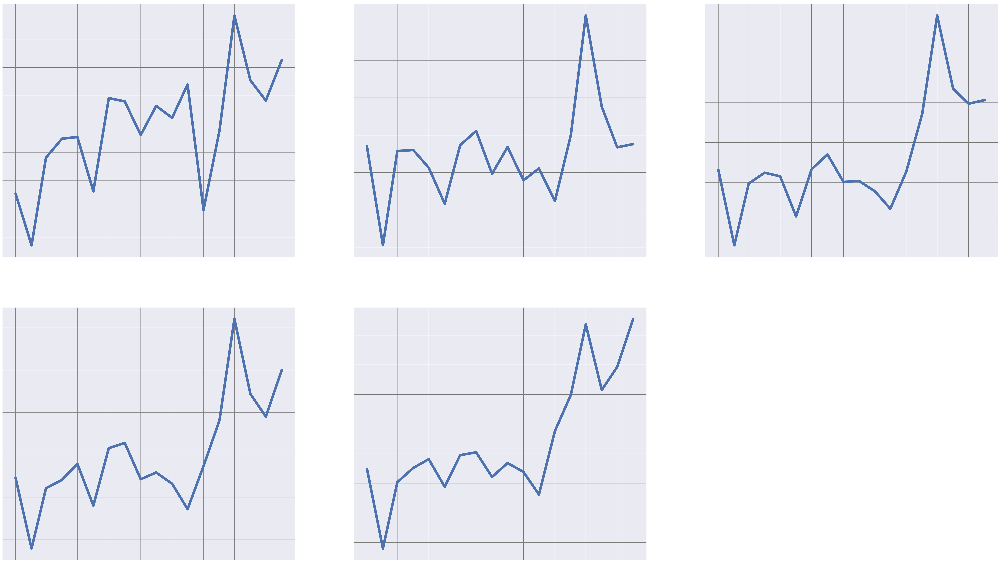

[주방식기/용기]


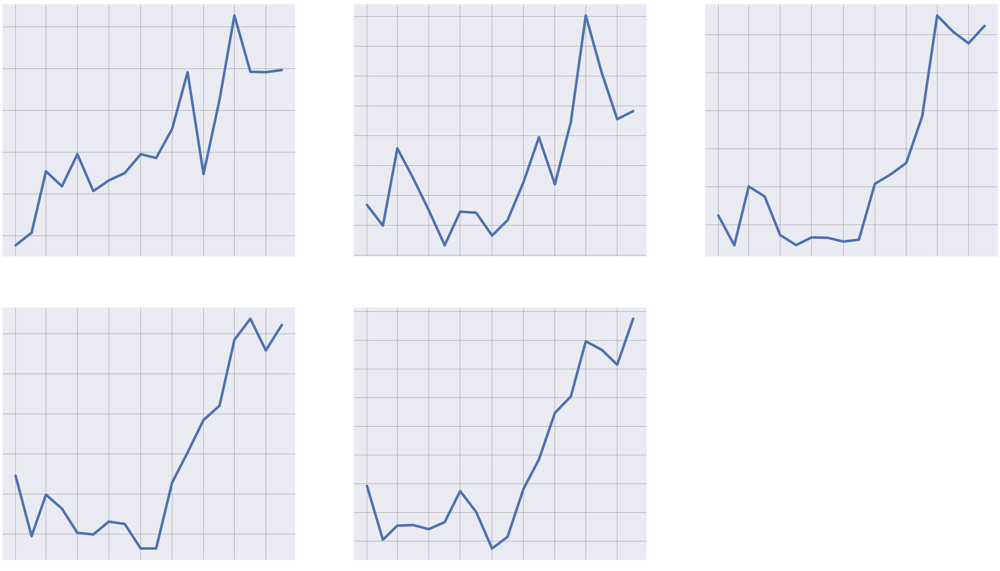

[주방조리기구]


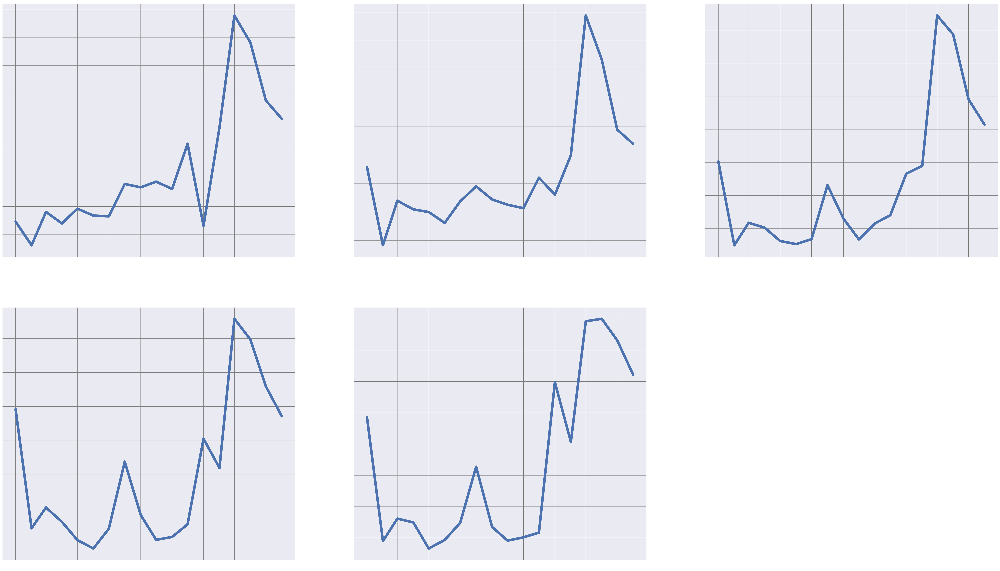

[출산용품/임부용품]


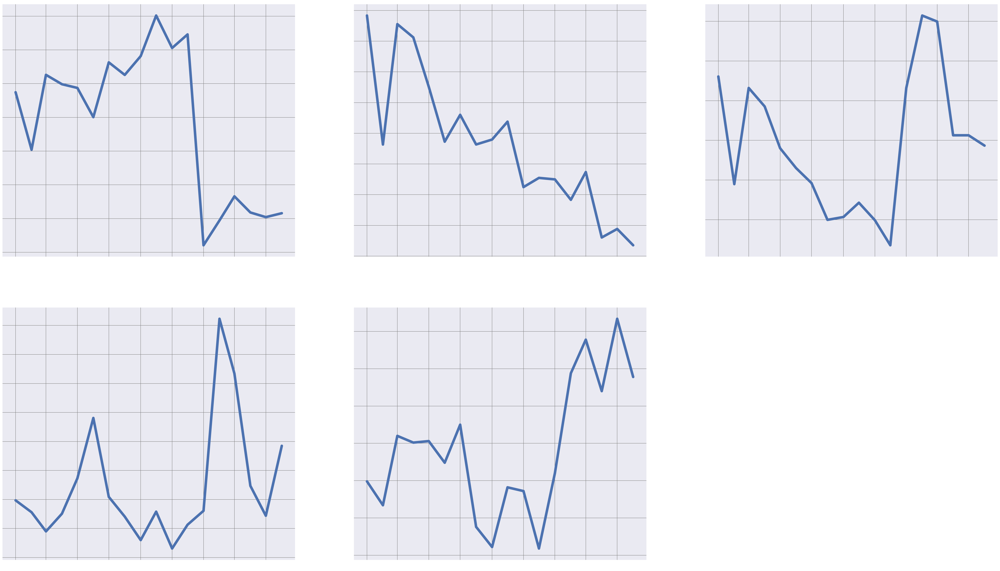

[취미/악기]


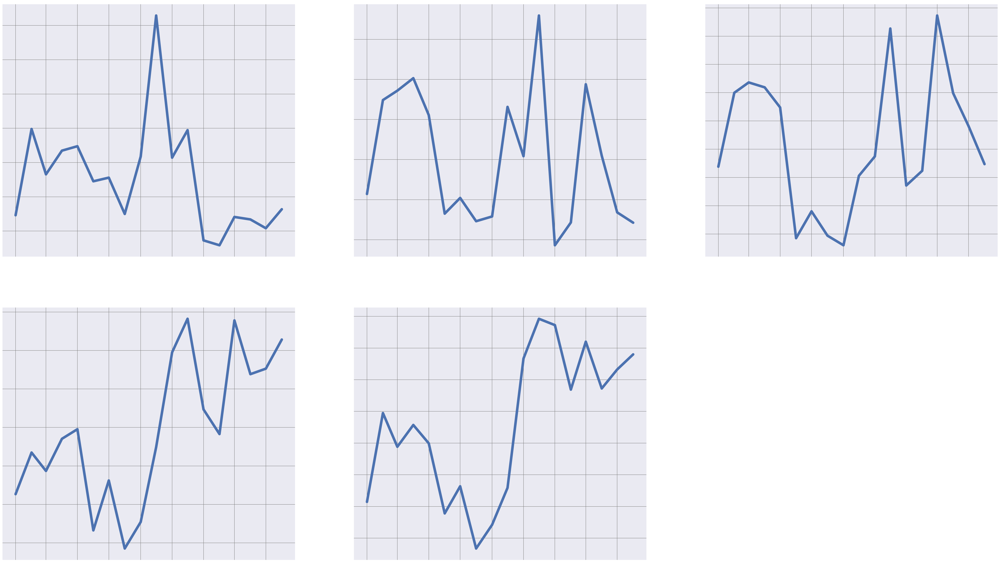

[침실 가구]


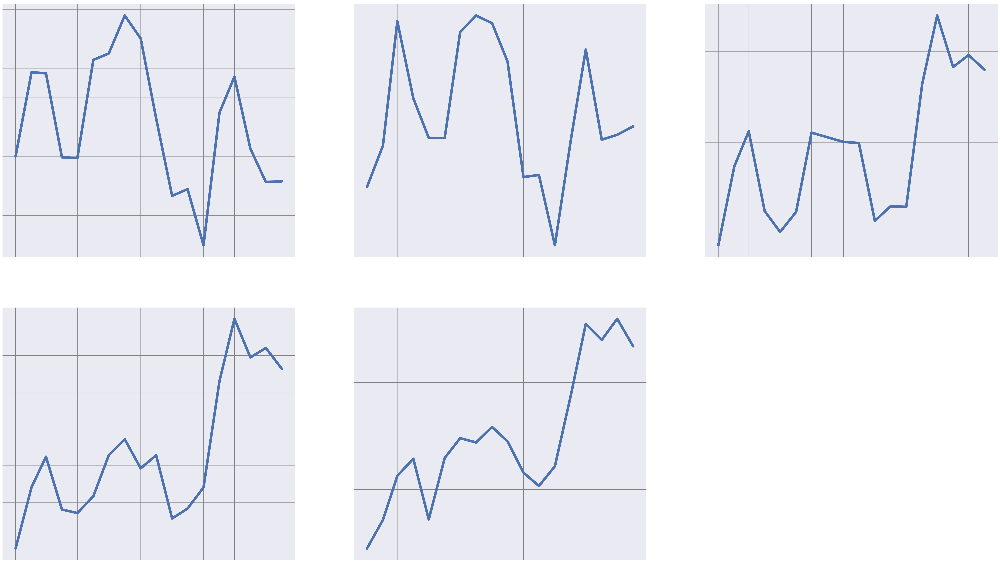

[침실 인테리어]


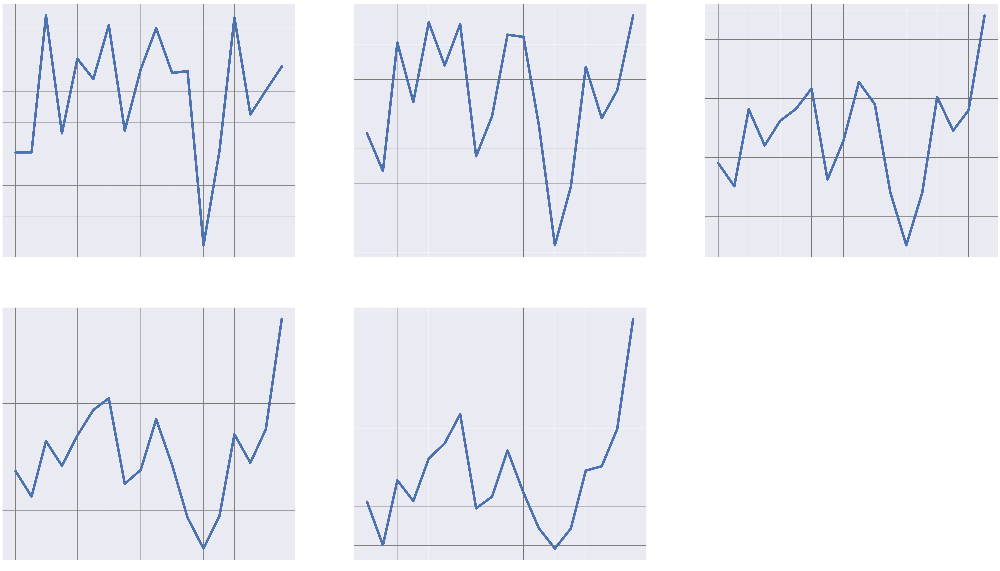

[카메라/캠코더]


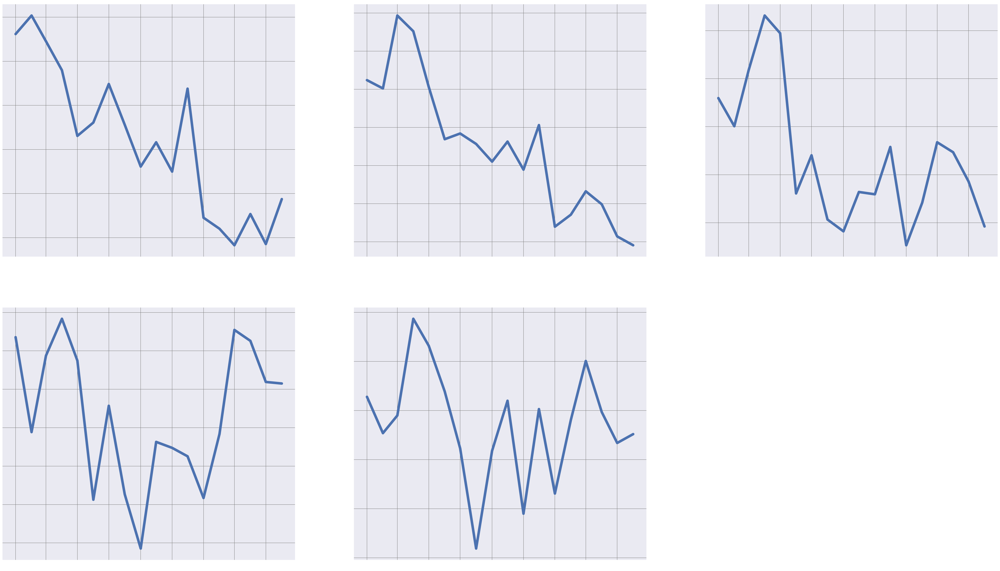

[캠핑용품]


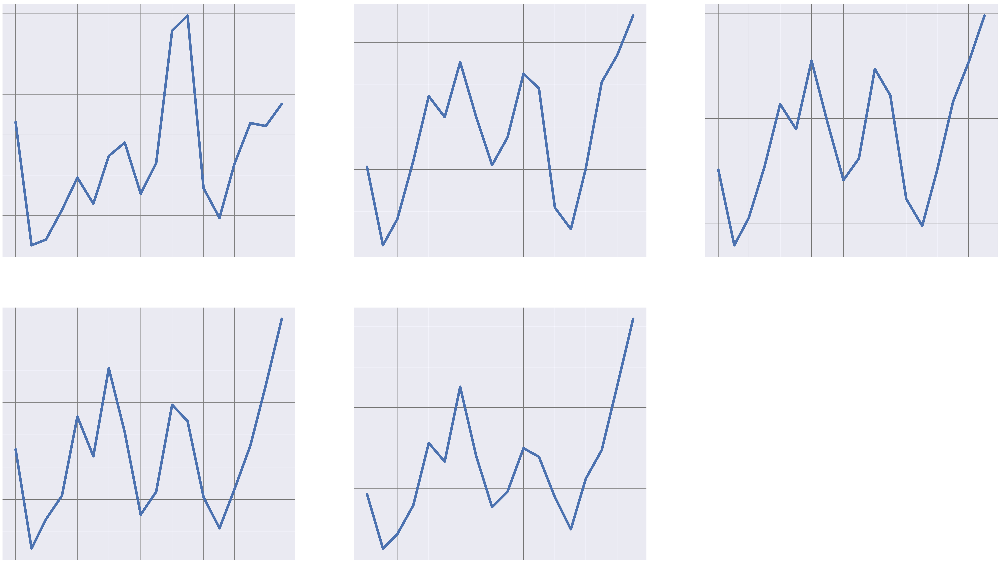

[테마의류]


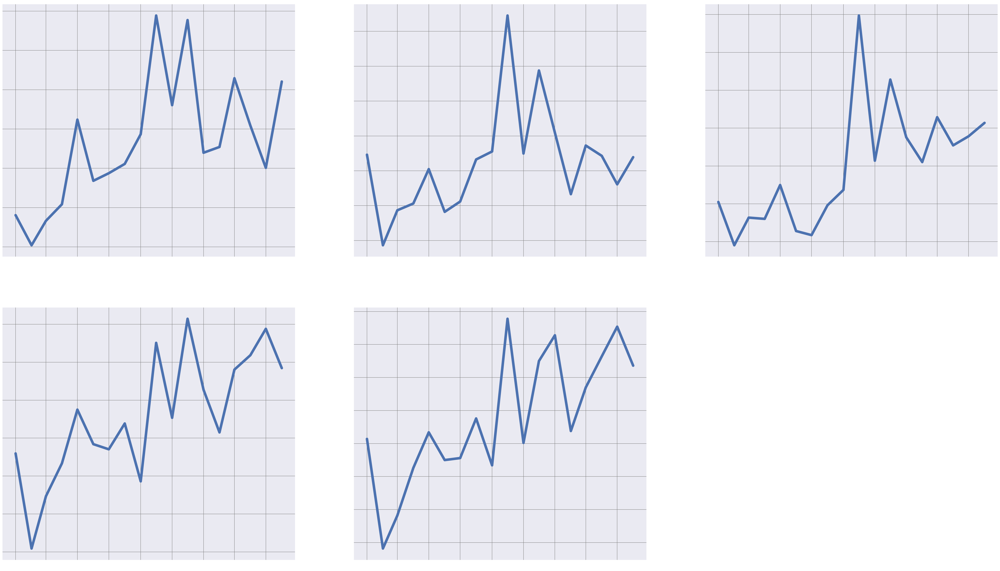

[헤어/바디케어]


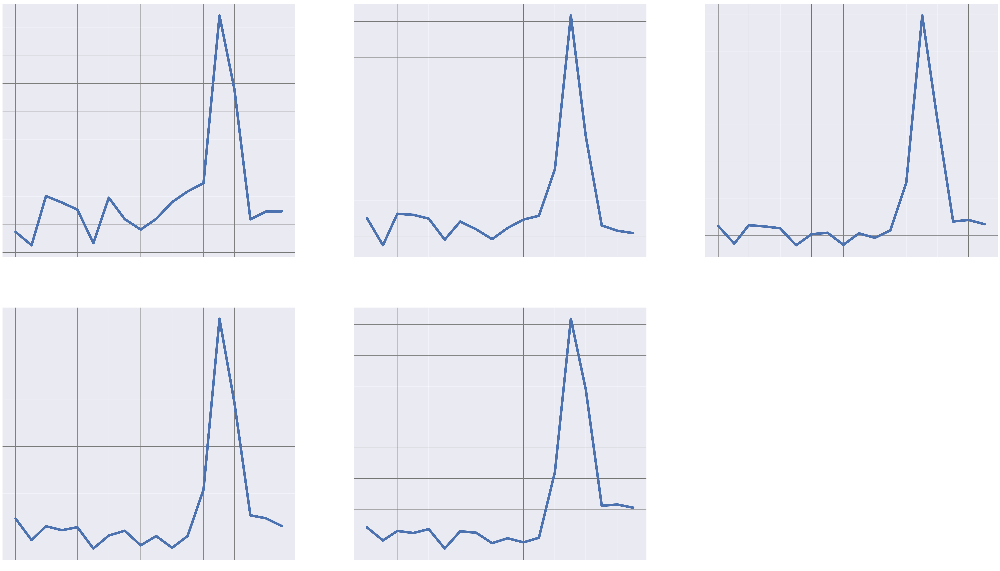

[헬스기구용품]


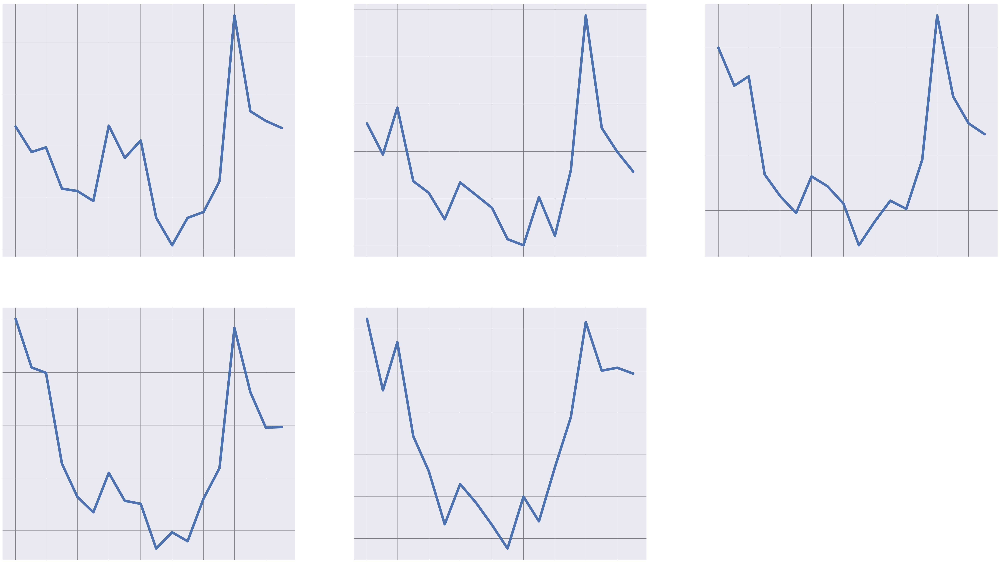

[휴대폰/악세서리]


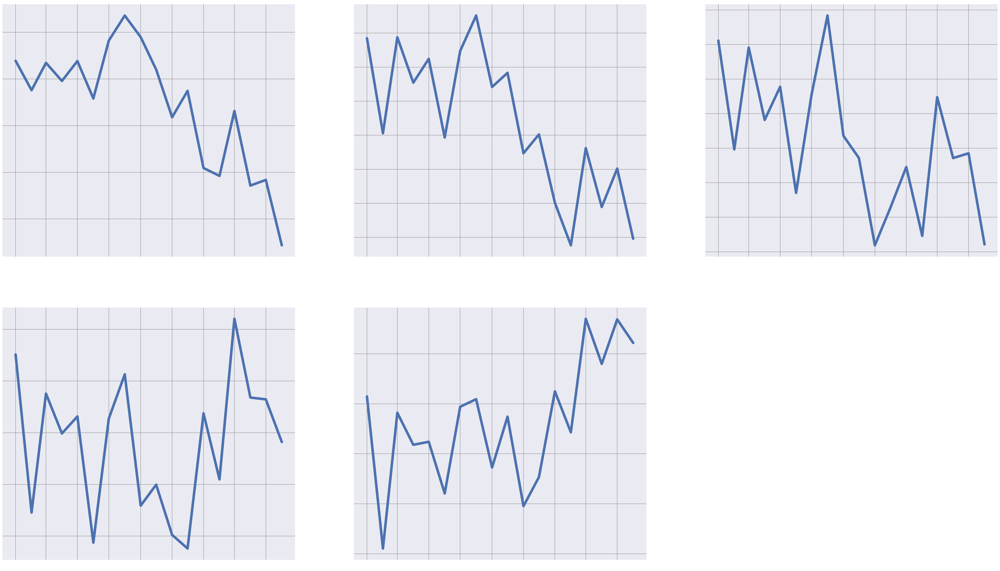

In [27]:
AgeM_Corp=M_Corp.groupby(["구매월", "카테고리명", "고객나이"]).sum().reset_index() 
for i in range(len(Category)):
    print("["+Category[i]+"]")
    plt.figure(figsize=(50,30))
    for j in range(2, 7):      
        Cate_data=AgeM_Corp[(AgeM_Corp["카테고리명"]==Category[i])&(AgeM_Corp["고객나이"]==(j*10))]
        date=Cate_data["구매월"].apply(lambda x: str(x)+'01')
        date=pd.to_datetime(date)
        count=Cate_data["구매수"].tolist()
        plt.subplot(2,3,(j-1))
        plt.title(str(j*10)+"대 ", size=60)
        plt.yticks(size=30)
        plt.xticks(rotation=20, size=30)
        plt.grid(True, color='gray', alpha=1)
        plt.plot(date, count, linewidth=8)
    if not os.path.exists('./Agefigures') : os.makedirs('./Agefigures/')
    plt.savefig('./Agefigures/' + Category[i].replace("/", "")+'.jpg')
    plt.show()

# 주기별 오프라인 컬럼별 상관관계

## 월별 상관관계 분석
* 변수설정
* 함수설정
* 그래프 그리기

### 변수설정

In [28]:
card=ori_card.copy()
# card data 쓰기 좋게 정리
card['소비건수']=card['소비건수(삼성)']+card['소비건수(신한)']
# card['소비일자']=pd.to_datetime(card['소비일자'].astype(str))
card=card[['소비일자','소비업종','성별','연령대','소비건수']].copy()
card.columns=['일자','업종','성별','연령','건수']

card['일자']=card['일자'].apply(lambda x: int(str(x)[:6]))
card_gp=card.groupby(['일자','업종','성별','연령']).sum().reset_index().copy()

card_gp['성별'] = card_gp['성별'].apply(lambda x: 'M' if x==1 else 'F').copy()
# card_gp['연령'] = card_gp['연령'].apply(lambda x: str(x)+'대').copy()

card_gp=card_gp.groupby(['일자','업종','연령']).sum().reset_index()

spe_list=card_gp['업종'].unique().tolist()
age_list=card_gp['연령'].unique().tolist()

card_gp['건수']=np.round(card_gp['건수']).astype(int)
card_all=card_gp.groupby(['일자','업종']).sum().reset_index()

### 함수설정

In [29]:
def corr_per_month(spe):
    all_select=card_all[card_all['업종']==spe]
    all_select['건수_정규화']=score_normalize(np.array(card_all[card_all['업종']==spe]['건수']).reshape(-1,1))
    for i in age_list:
        all_select[str(i)+'_정규화']=score_normalize(np.array(card_gp[(card_gp['연령']==i)&(card_gp['업종']==spe)]['건수']).reshape(-1,1))
    set_all_select=all_select[['건수_정규화','20_정규화','30_정규화','40_정규화','50_정규화','60_정규화']]
    corr=set_all_select.corr()
    mask = np.triu(np.ones_like(corr, dtype=np.bool))

    sns.heatmap(corr, annot=True, cmap="Blues", mask=mask)
    plt.show()
    
def corr_per_month_before_corona(spe):
    select_card_all=card_all[(card_all['일자']<=201912)]
    select_card_gp=card_gp[(card_gp['일자']<=201912)]
    all_select=select_card_all[select_card_all['업종']==spe]
    all_select['건수_정규화']=score_normalize(np.array(select_card_all[select_card_all['업종']==spe]['건수']).reshape(-1,1))
    for i in age_list:
        all_select[str(i)+'_정규화']=score_normalize(np.array(select_card_gp[(select_card_gp['연령']==i)&(select_card_gp['업종']==spe)]['건수']).reshape(-1,1))
    set_all_select=all_select[['건수_정규화','20_정규화','30_정규화','40_정규화','50_정규화','60_정규화']]
    corr=set_all_select.corr()
    mask = np.triu(np.ones_like(corr, dtype=np.bool))

    sns.heatmap(corr, annot=True, cmap="Blues", mask=mask)
    plt.show()
    
def corr_per_month_after_corona(spe):
    select_card_all=card_all[(card_all['일자']>201912)]
    select_card_gp=card_gp[(card_gp['일자']>201912)]
    all_select=select_card_all[select_card_all['업종']==spe]
    all_select['건수_정규화']=score_normalize(np.array(select_card_all[select_card_all['업종']==spe]['건수']).reshape(-1,1))
    for i in age_list:
        all_select[str(i)+'_정규화']=score_normalize(np.array(select_card_gp[(select_card_gp['연령']==i)&(select_card_gp['업종']==spe)]['건수']).reshape(-1,1))
    set_all_select=all_select[['건수_정규화','20_정규화','30_정규화','40_정규화','50_정규화','60_정규화']]
    corr=set_all_select.corr()
    mask = np.triu(np.ones_like(corr, dtype=np.bool))

    sns.heatmap(corr, annot=True, cmap="Blues", mask=mask)
    plt.show()

### 그래프 그리기

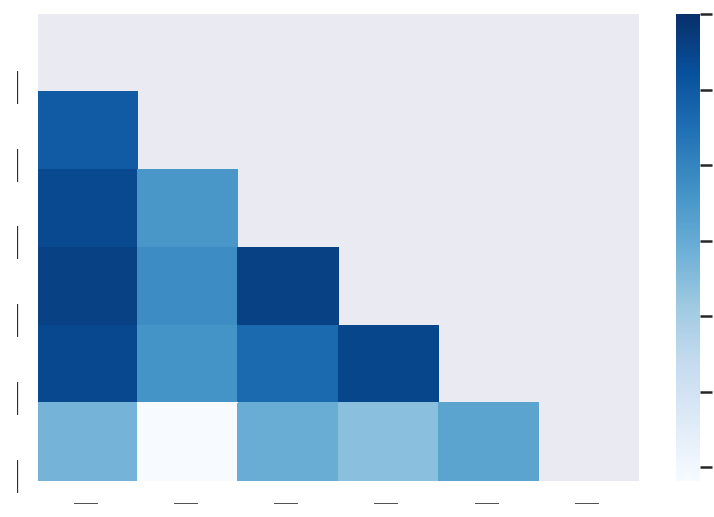

In [30]:
all_select=card_all[card_all['업종']=='가전/가구']
all_select['건수_정규화']=score_normalize(np.array(card_all[card_all['업종']=='가전/가구']['건수']).reshape(-1,1))
for i in age_list:
    all_select[str(i)+'_정규화']=score_normalize(np.array(card_gp[(card_gp['연령']==i)&(card_gp['업종']=='가전/가구')]['건수']).reshape(-1,1))
set_all_select=all_select[['건수_정규화','20_정규화','30_정규화','40_정규화','50_정규화','60_정규화']]
corr=set_all_select.corr()
mask = np.triu(np.ones_like(corr, dtype=np.bool))

sns.heatmap(corr, annot=True, cmap="Blues", mask=mask)
plt.show()

가전/가구
<전체>


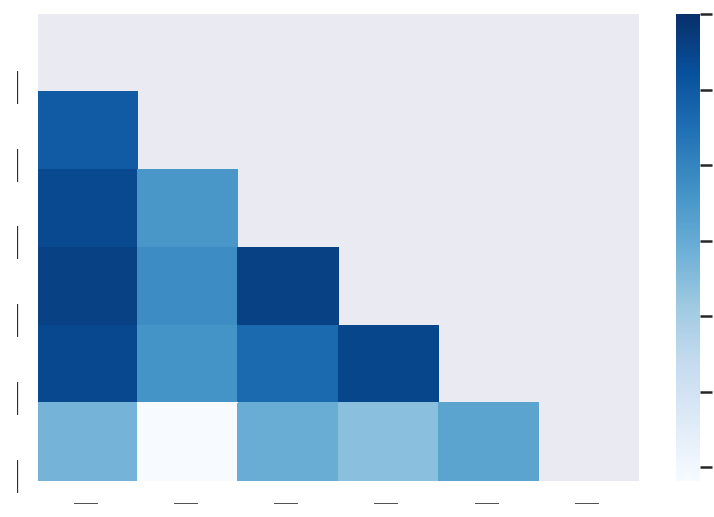

<코로나 전>


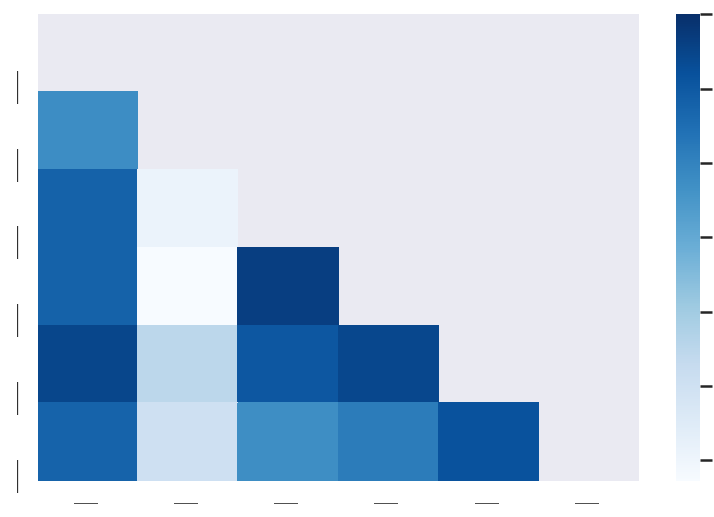

<코로나 후>


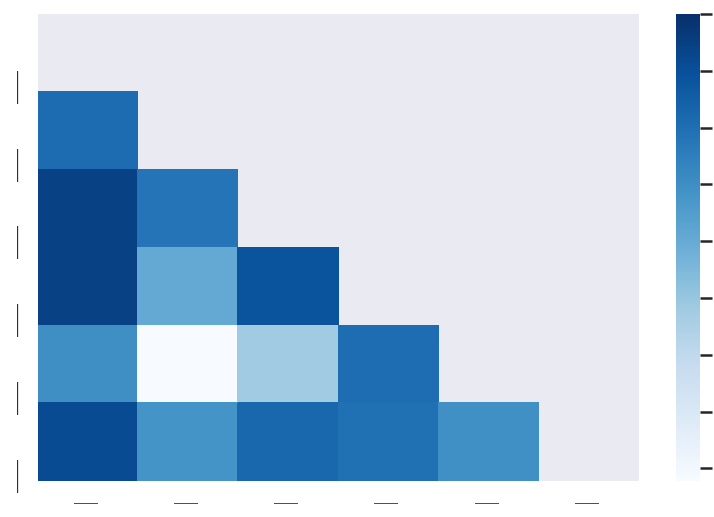

가정생활/서비스
<전체>


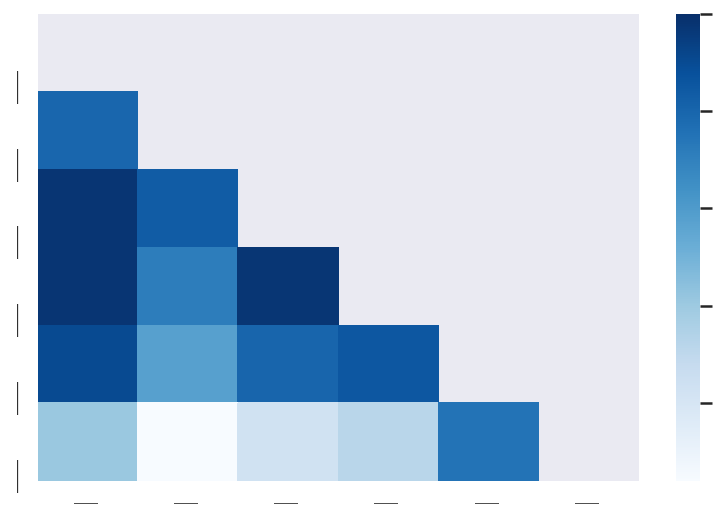

<코로나 전>


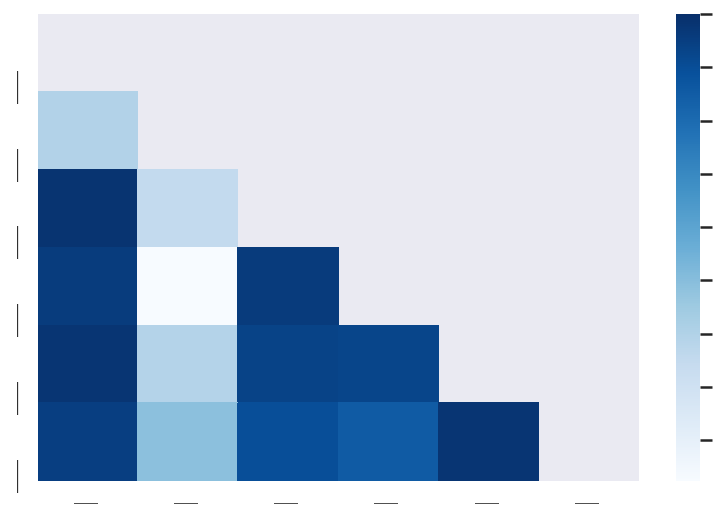

<코로나 후>


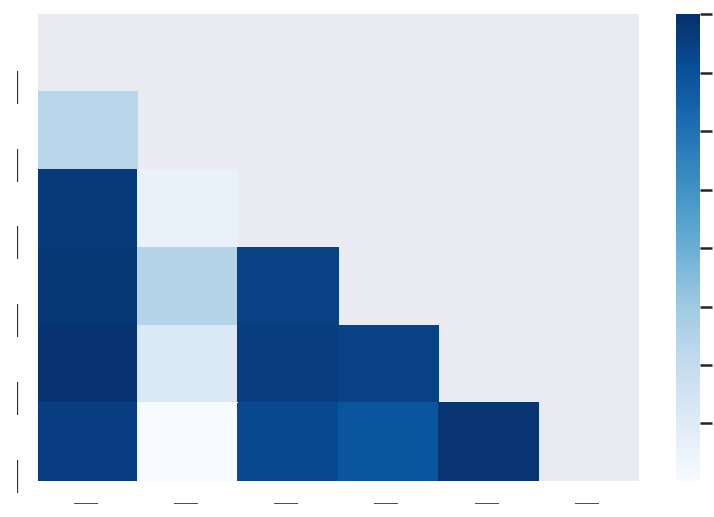

교육/학원
<전체>


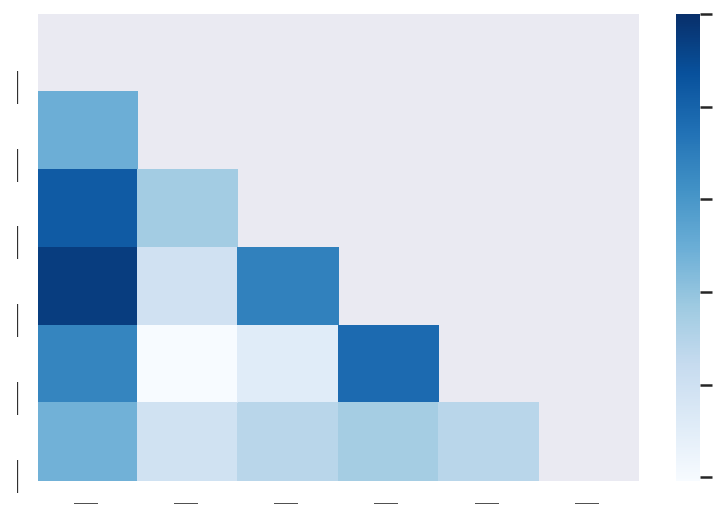

<코로나 전>


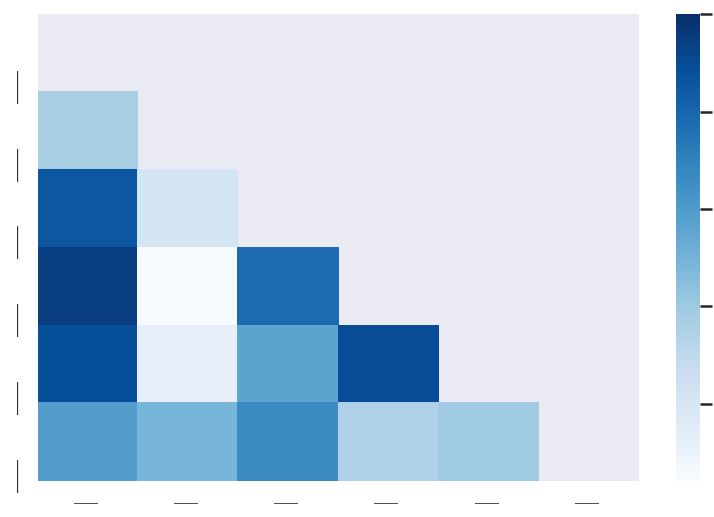

<코로나 후>


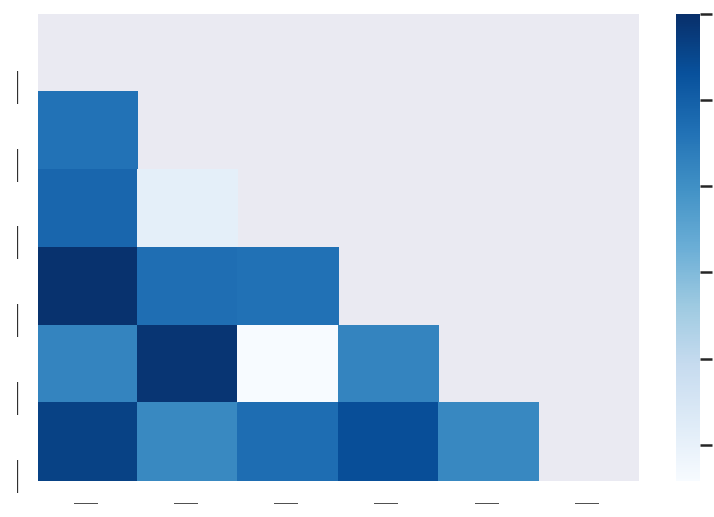

미용
<전체>


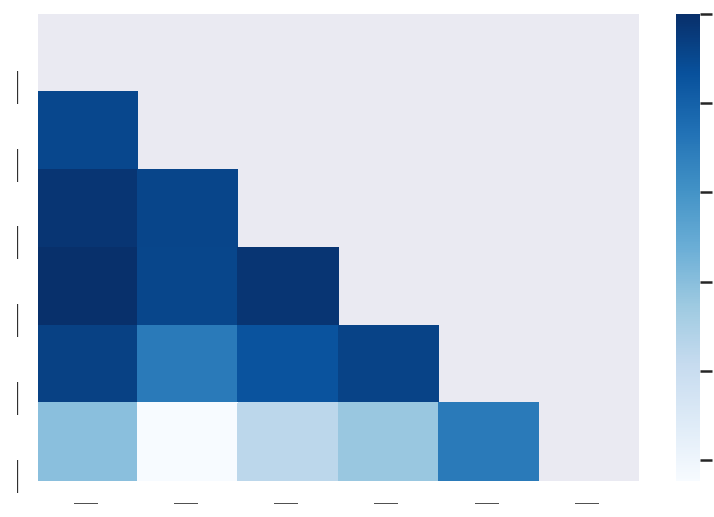

<코로나 전>


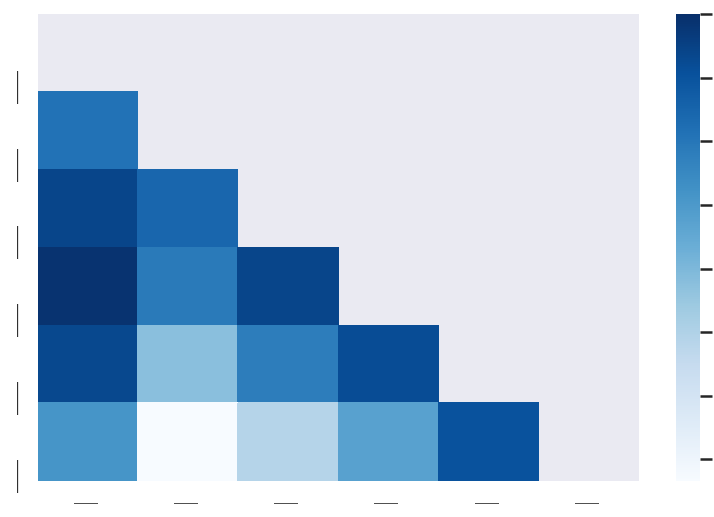

<코로나 후>


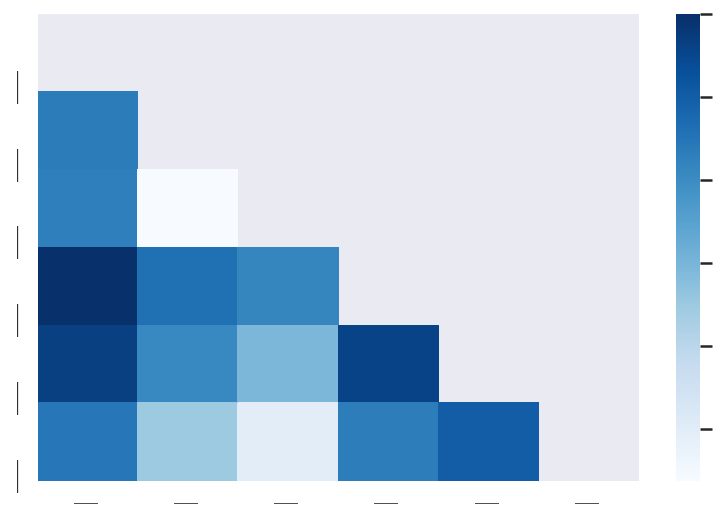

백화점/상품권/아울렛
<전체>


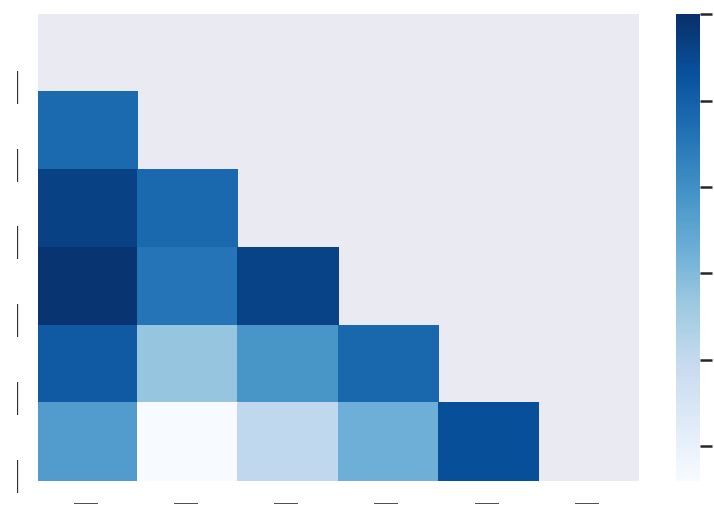

<코로나 전>


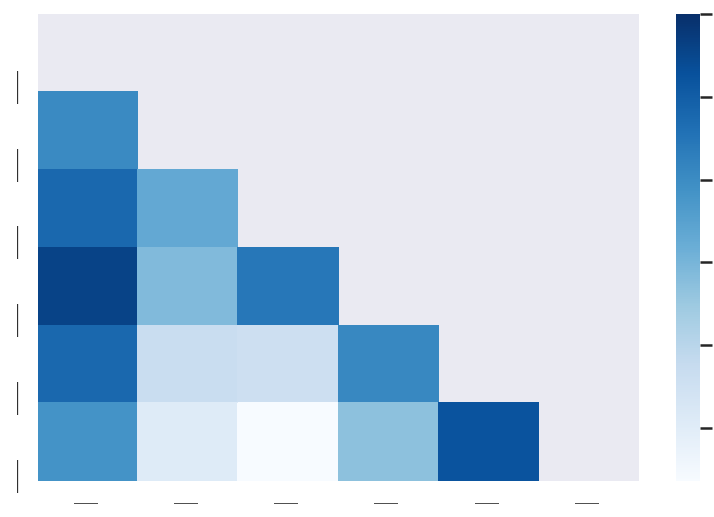

<코로나 후>


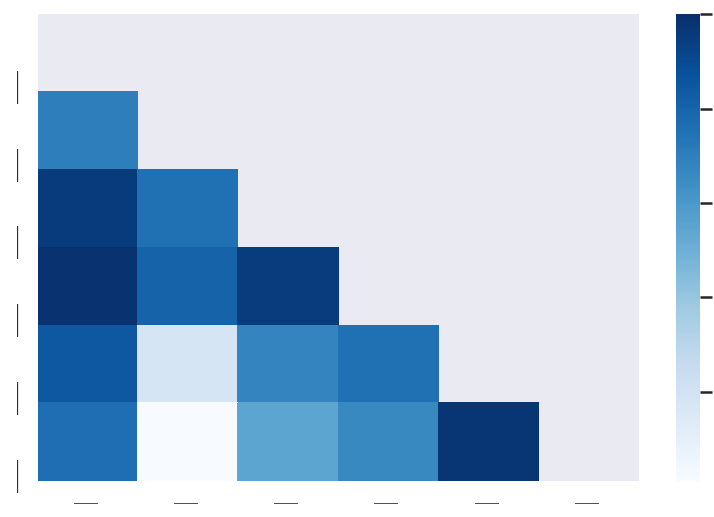

스포츠/문화/레저
<전체>


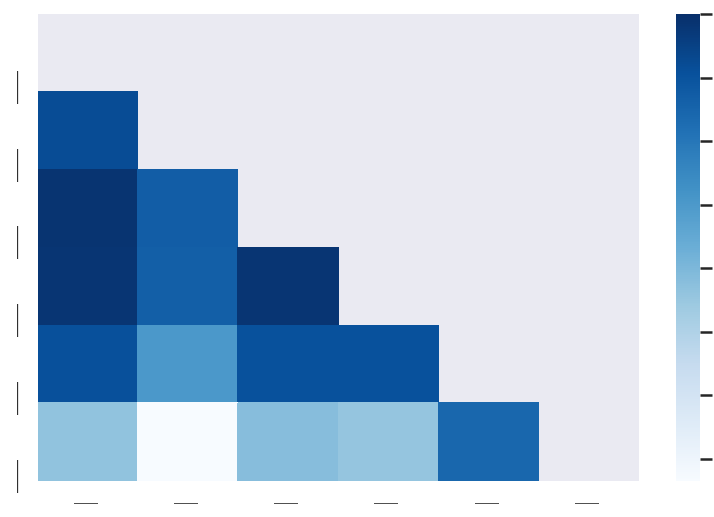

<코로나 전>


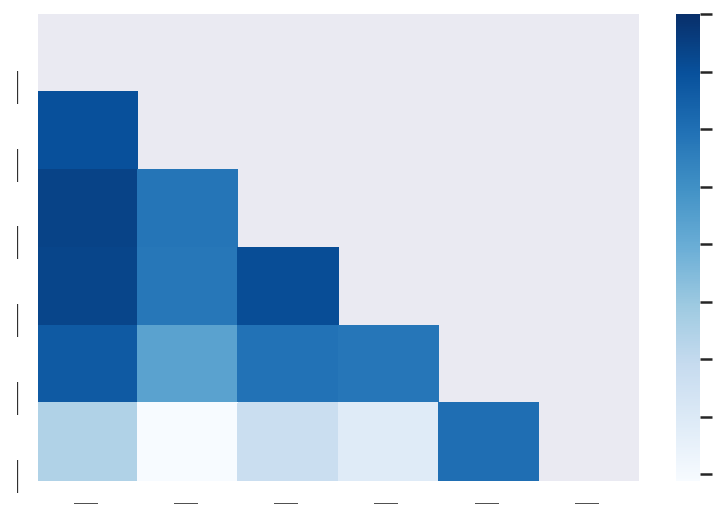

<코로나 후>


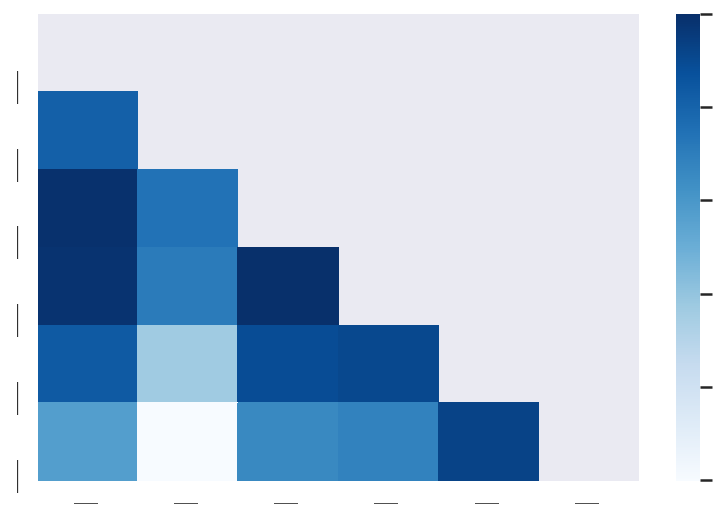

여행/교통
<전체>


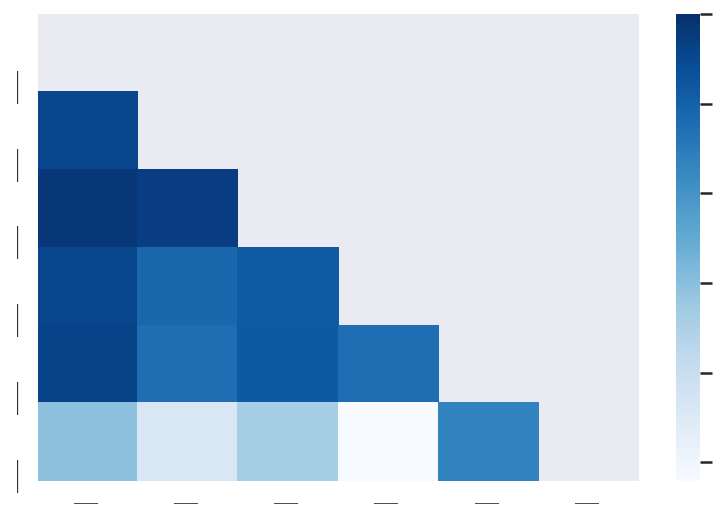

<코로나 전>


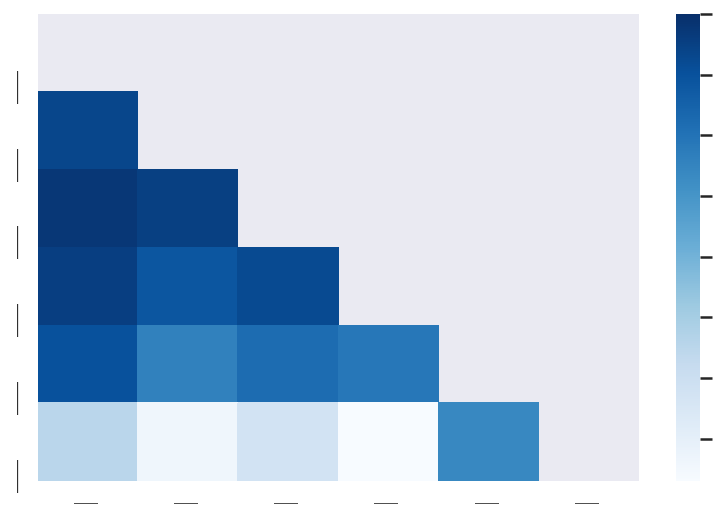

<코로나 후>


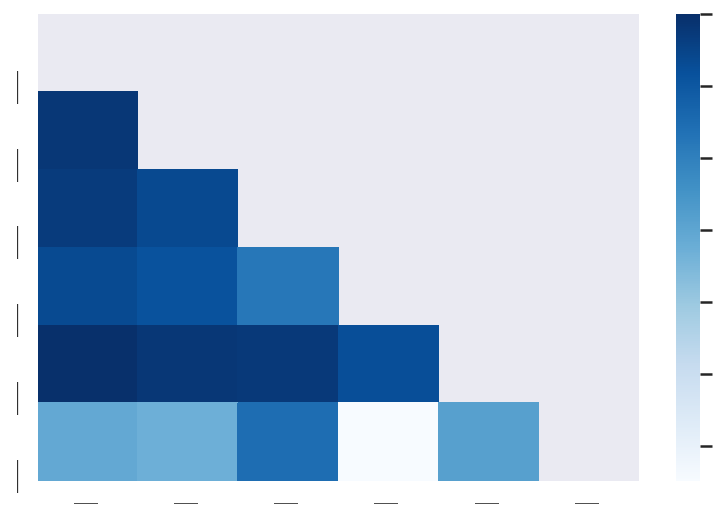

요식/유흥
<전체>


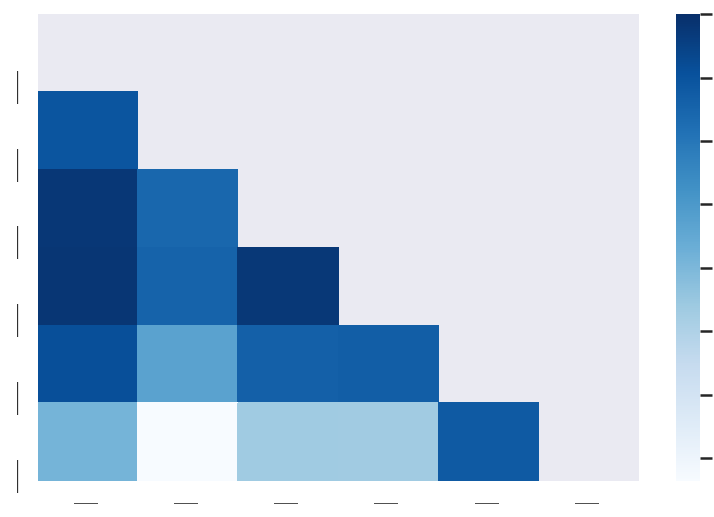

<코로나 전>


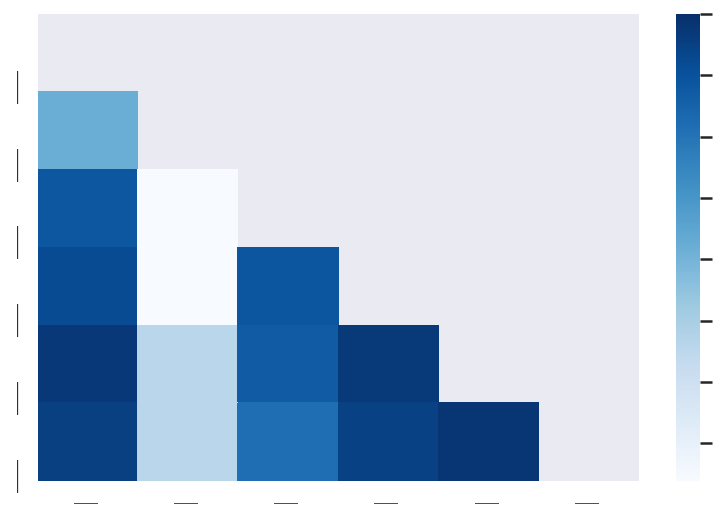

<코로나 후>


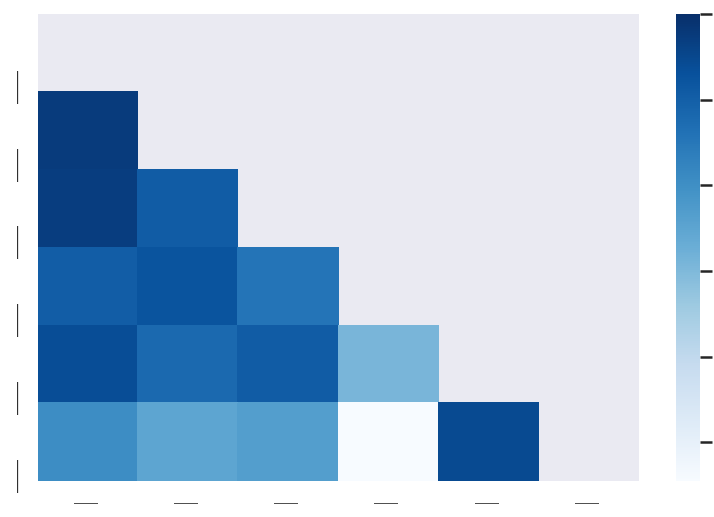

의료
<전체>


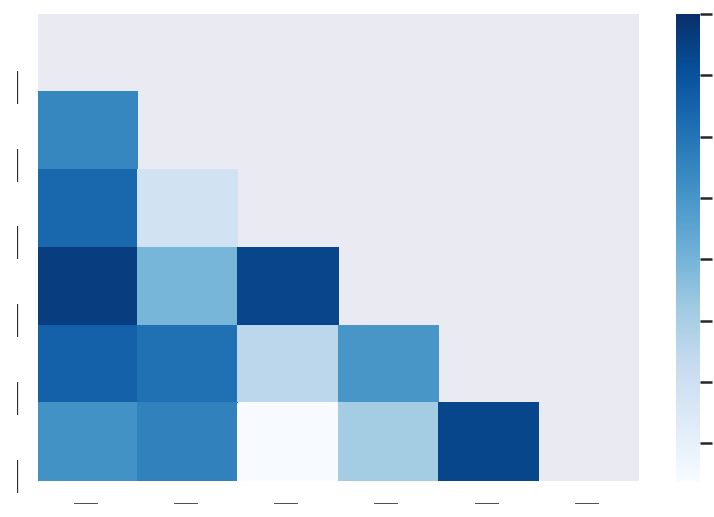

<코로나 전>


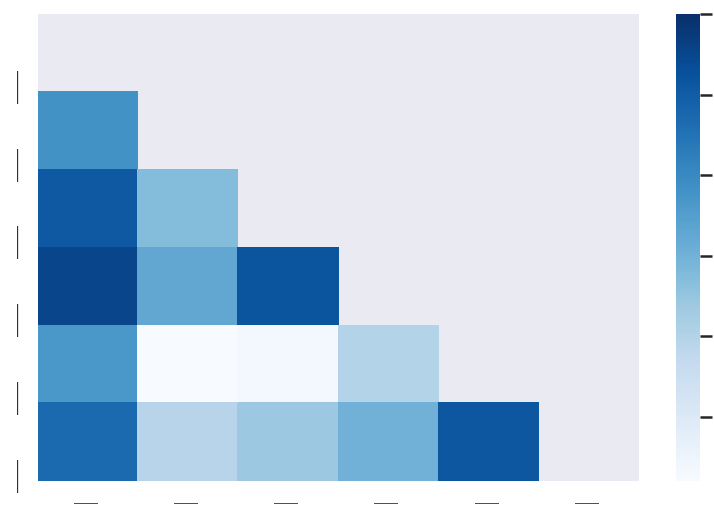

<코로나 후>


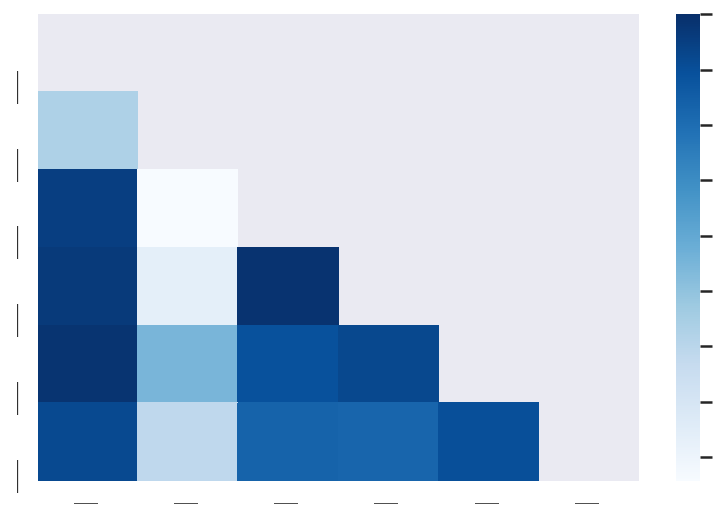

자동차
<전체>


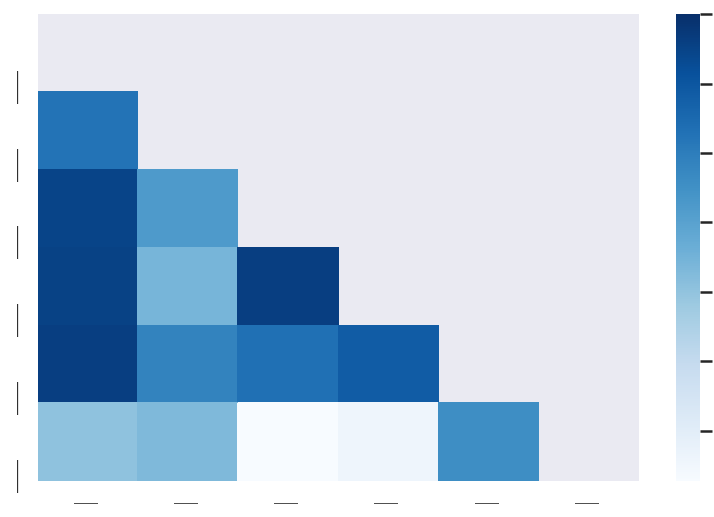

<코로나 전>


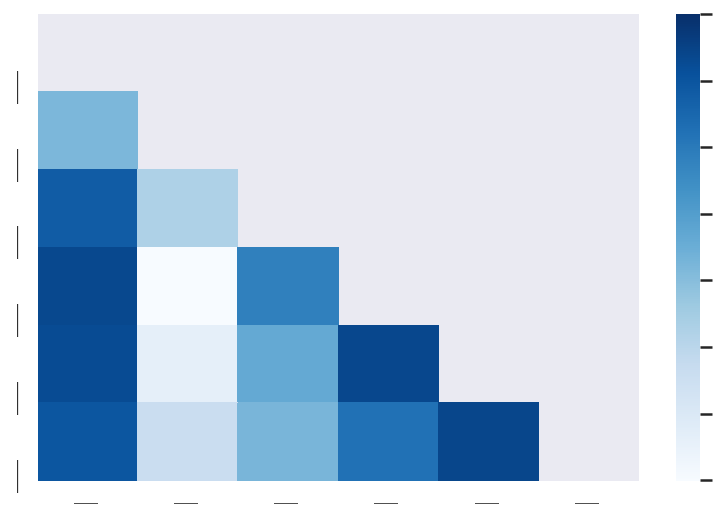

<코로나 후>


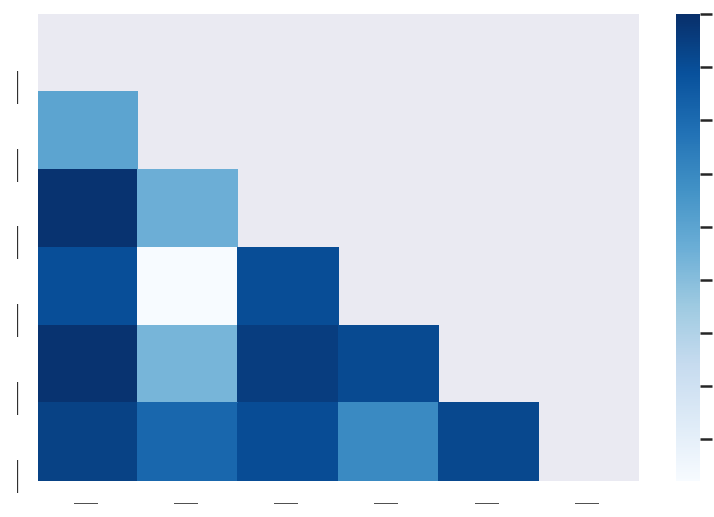

주유
<전체>


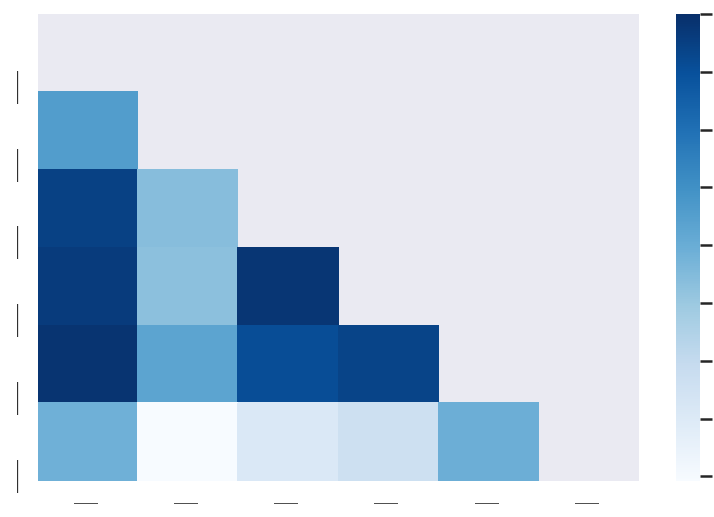

<코로나 전>


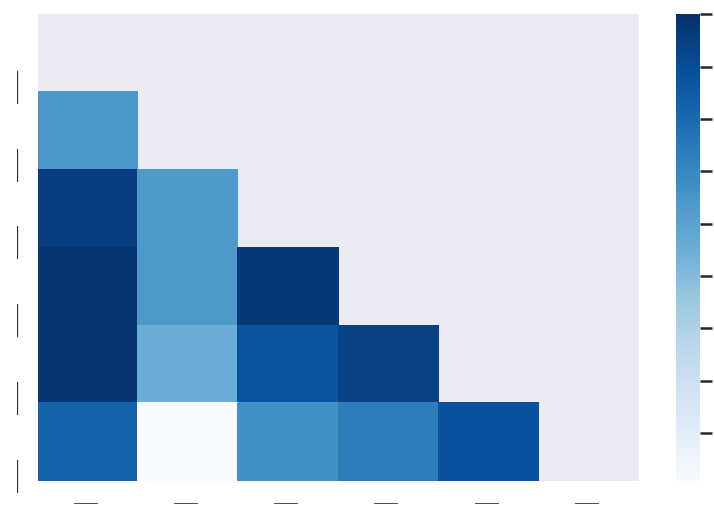

<코로나 후>


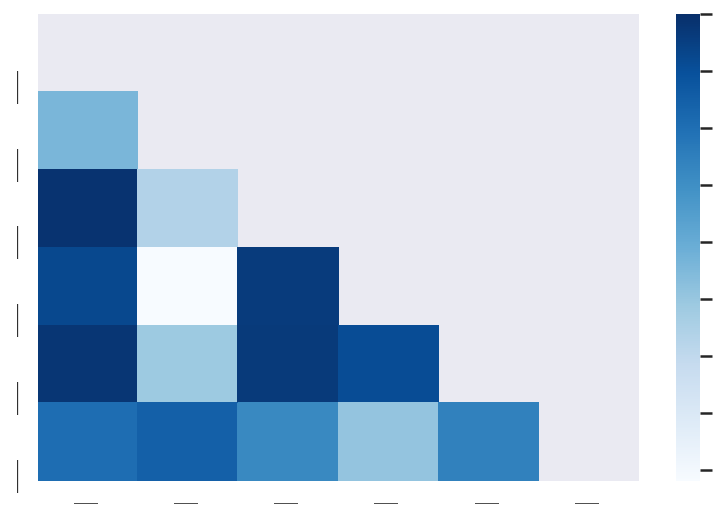

패션/잡화
<전체>


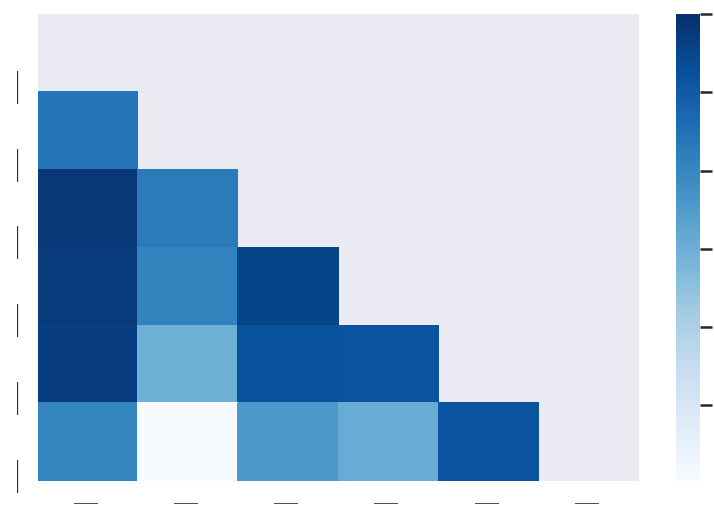

<코로나 전>


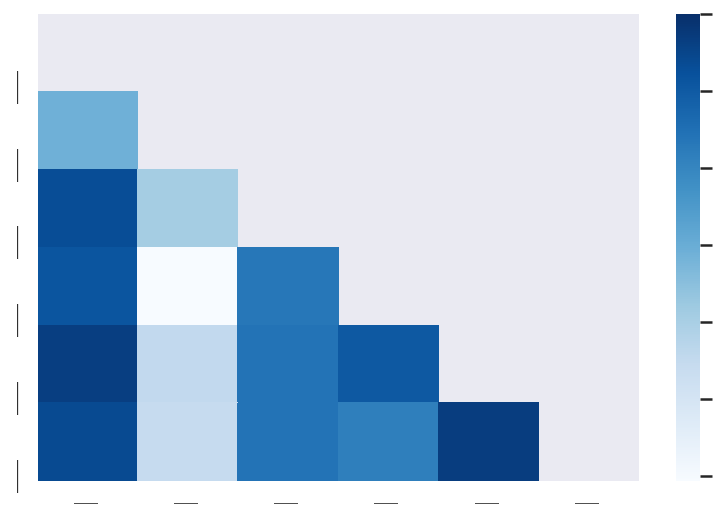

<코로나 후>


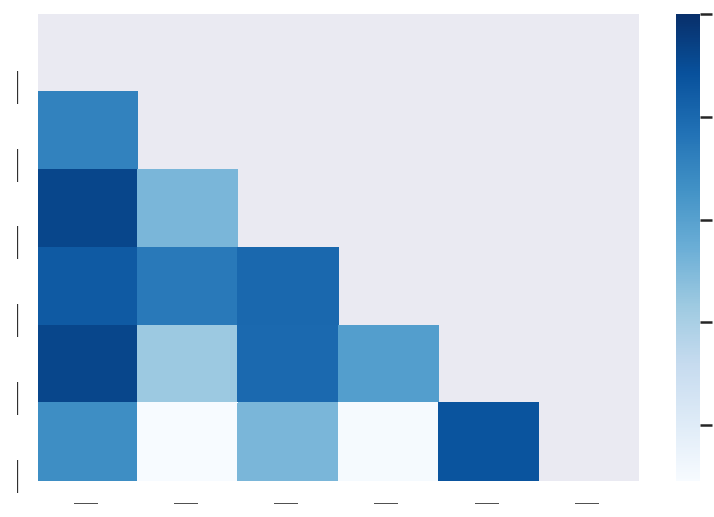

편의점
<전체>


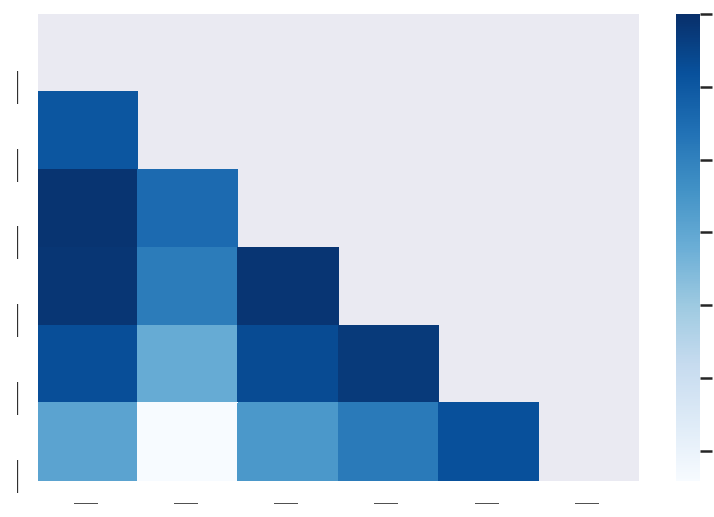

<코로나 전>


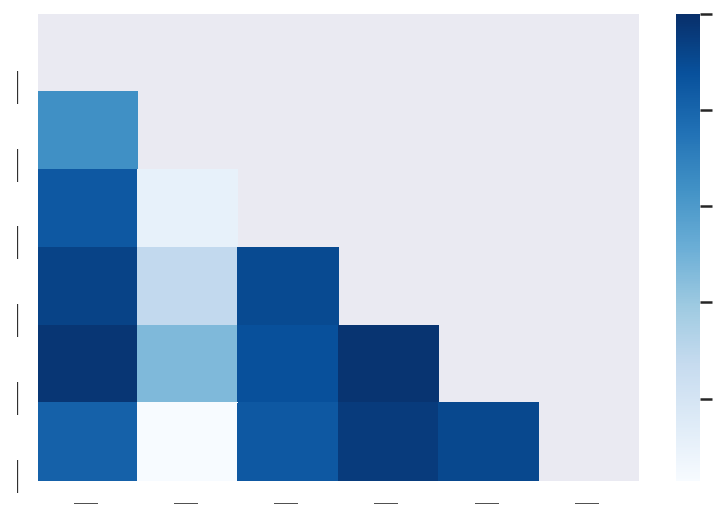

<코로나 후>


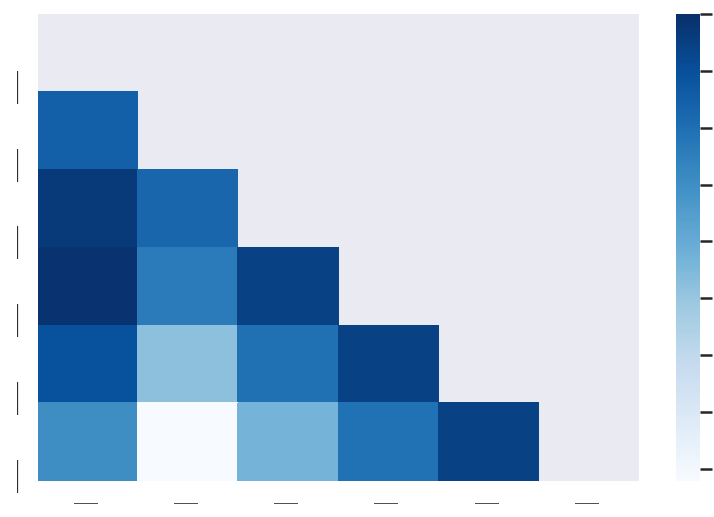

할인점/마트
<전체>


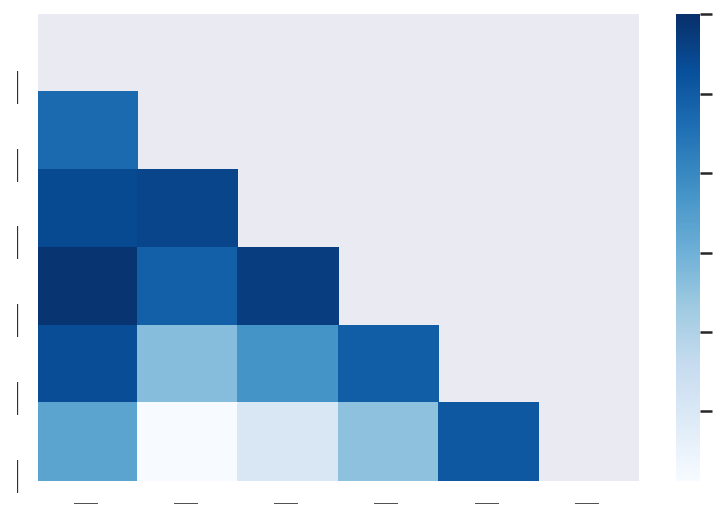

<코로나 전>


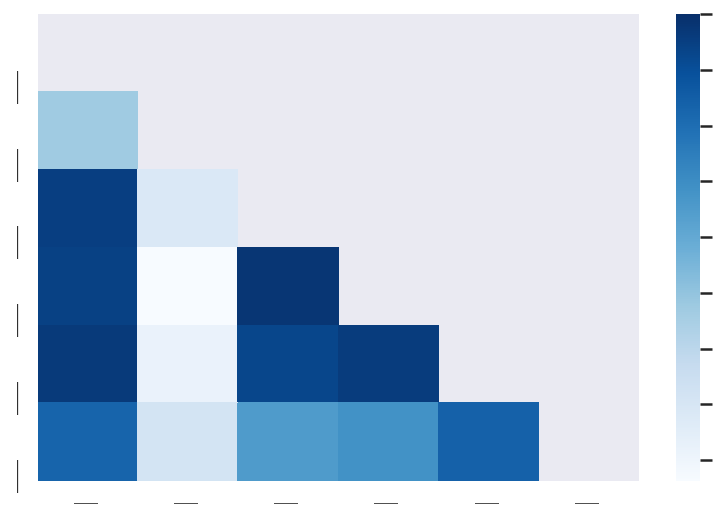

<코로나 후>


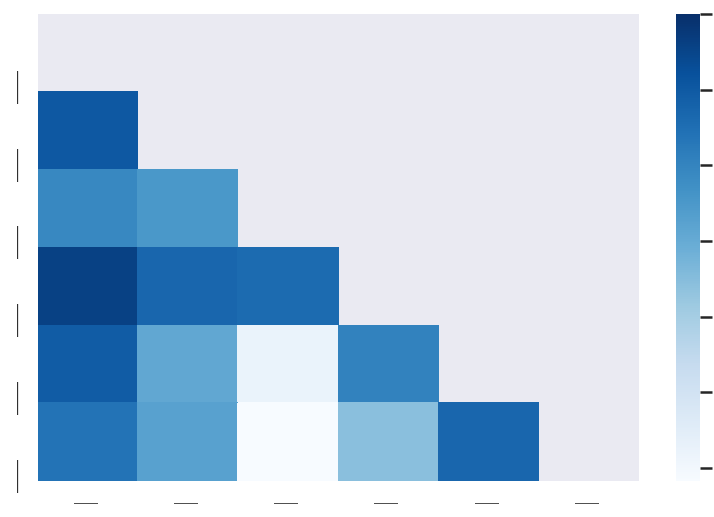

In [31]:
for i in spe_list:
    print(i)
    print('<전체>')
    corr_per_month(i)
    print('<코로나 전>')
    corr_per_month_before_corona(i)
    print('<코로나 후>')
    corr_per_month_after_corona(i)

## 주별 상관관계 분석
* 변수설정
* 함수설정
* 그래프 그리기

### 변수설정

In [32]:
card=ori_card.copy()
# card data 쓰기 좋게 정리
card['소비건수']=card['소비건수(삼성)']+card['소비건수(신한)']
# card['소비일자']=pd.to_datetime(card['소비일자'].astype(str))
card=card[['소비일자','소비업종','성별','연령대','소비건수']].copy()
card.columns=['일자','업종','성별','연령','건수']

card['일자']=card['일자'].apply(lambda x: int(str(x)[:7]))
card_gp=card.groupby(['일자','업종','성별','연령']).sum().reset_index().copy()

card_gp['성별'] = card_gp['성별'].apply(lambda x: 'M' if x==1 else 'F').copy()
# card_gp['연령'] = card_gp['연령'].apply(lambda x: str(x)+'대').copy()

card_gp=card_gp.groupby(['일자','업종','연령']).sum().reset_index()

spe_list=card_gp['업종'].unique().tolist()
age_list=card_gp['연령'].unique().tolist()

card_gp['건수']=np.round(card_gp['건수']).astype(int)
card_all=card_gp.groupby(['일자','업종']).sum().reset_index()

for i in range(len(card_all)):
    if str(card_all['일자'][i])[-1]=='3':
        card_all.drop(i, inplace=True)
        
for i in range(len(card_gp)):
    if str(card_gp['일자'][i])[-1]=='3':
        card_gp.drop(i, inplace=True)
        
card_all=card_all.reset_index()
card_gp=card_gp.reset_index()

### 함수설정

In [33]:
def corr_per_week(spe):
    all_select=card_all[card_all['업종']=='가전/가구']
    all_select['건수_정규화']=score_normalize(np.array(card_all[card_all['업종']=='가전/가구']['건수']).reshape(-1,1))
    for i in age_list:
        all_select[str(i)+'_정규화']=score_normalize(np.array(card_gp[(card_gp['연령']==i)&(card_gp['업종']=='가전/가구')]['건수']).reshape(-1,1))

    set_all_select=all_select[['건수_정규화','20_정규화','30_정규화','40_정규화','50_정규화','60_정규화']]
    corr=set_all_select.corr()
    mask = np.triu(np.ones_like(corr, dtype=np.bool))

    sns.heatmap(corr, annot=True, cmap="Blues", mask=mask)
    plt.show()
    
def corr_per_week_before_corona(spe):
    select_card_all=card_all[(card_all['일자']<2020012)]
    select_card_gp=card_gp[(card_gp['일자']<2020012)]
    all_select=select_card_all[select_card_all['업종']==spe]
    all_select['건수_정규화']=score_normalize(np.array(select_card_all[select_card_all['업종']==spe]['건수']).reshape(-1,1))
    for i in age_list:
        all_select[str(i)+'_정규화']=score_normalize(np.array(select_card_gp[(select_card_gp['연령']==i)&(select_card_gp['업종']==spe)]['건수']).reshape(-1,1))
    set_all_select=all_select[['건수_정규화','20_정규화','30_정규화','40_정규화','50_정규화','60_정규화']]
    corr=set_all_select.corr()
    mask = np.triu(np.ones_like(corr, dtype=np.bool))

    sns.heatmap(corr, annot=True, cmap="Blues", mask=mask)
    plt.show()
    
def corr_per_week_with_corona(spe):
    select_card_all=card_all[(card_all['일자']>=2020012)]
    select_card_gp=card_gp[(card_gp['일자']>=2020012)]
    all_select=select_card_all[select_card_all['업종']==spe]
    all_select['건수_정규화']=score_normalize(np.array(select_card_all[select_card_all['업종']==spe]['건수']).reshape(-1,1))
    for i in age_list:
        all_select[str(i)+'_정규화']=score_normalize(np.array(select_card_gp[(select_card_gp['연령']==i)&(select_card_gp['업종']==spe)]['건수']).reshape(-1,1))
    set_all_select=all_select[['건수_정규화','20_정규화','30_정규화','40_정규화','50_정규화','60_정규화']]
    corr=set_all_select.corr()
    mask = np.triu(np.ones_like(corr, dtype=np.bool))

    sns.heatmap(corr, annot=True, cmap="Blues", mask=mask)
    plt.show()

### 그래프 그리기

가전/가구
<전체>


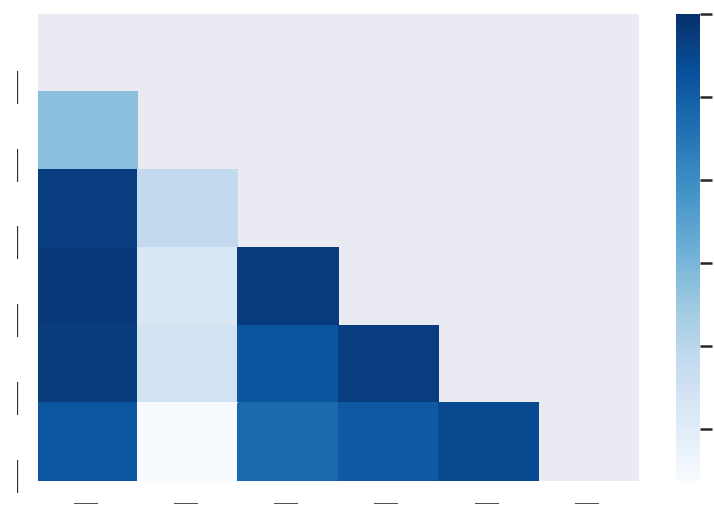

<코로나 전>


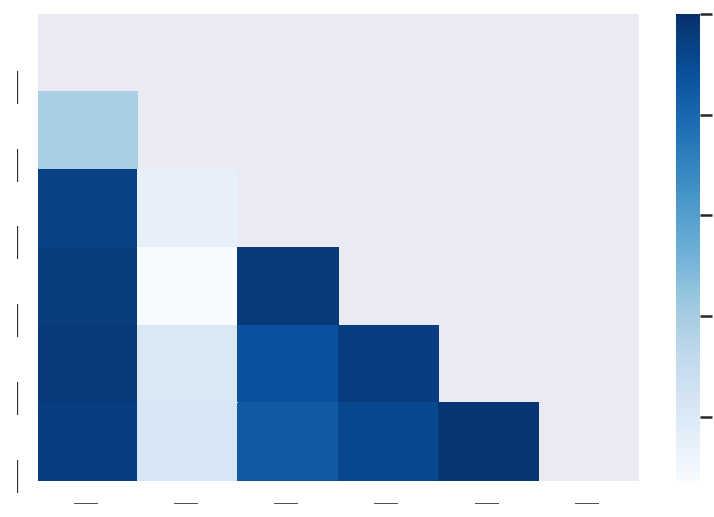

<코로나 후>


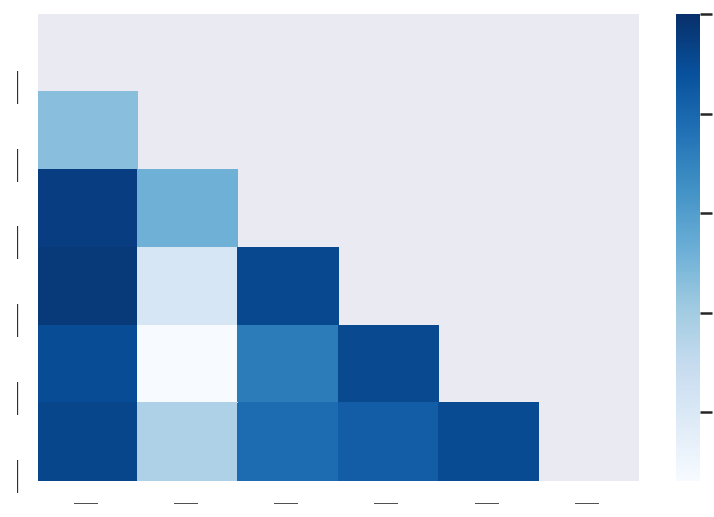

가정생활/서비스
<전체>


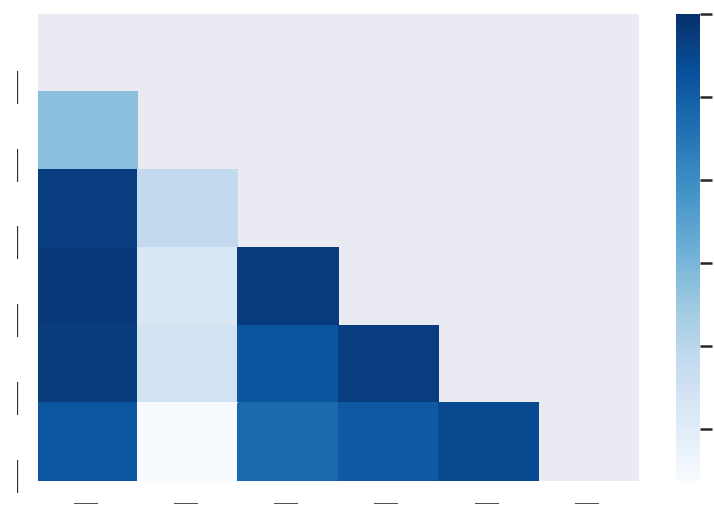

<코로나 전>


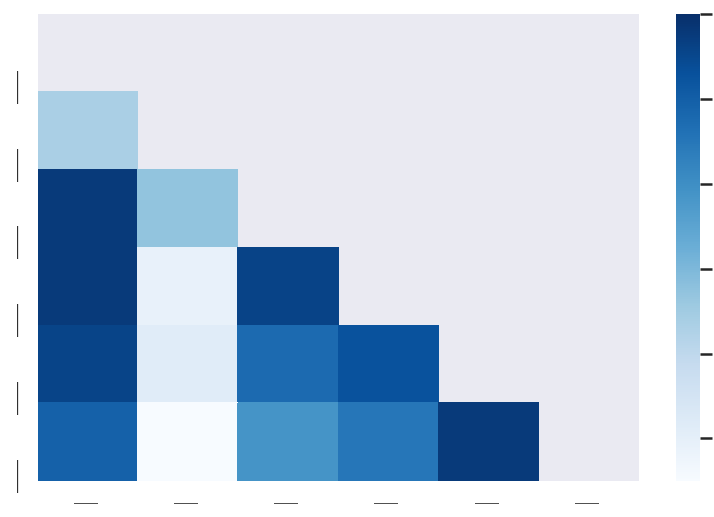

<코로나 후>


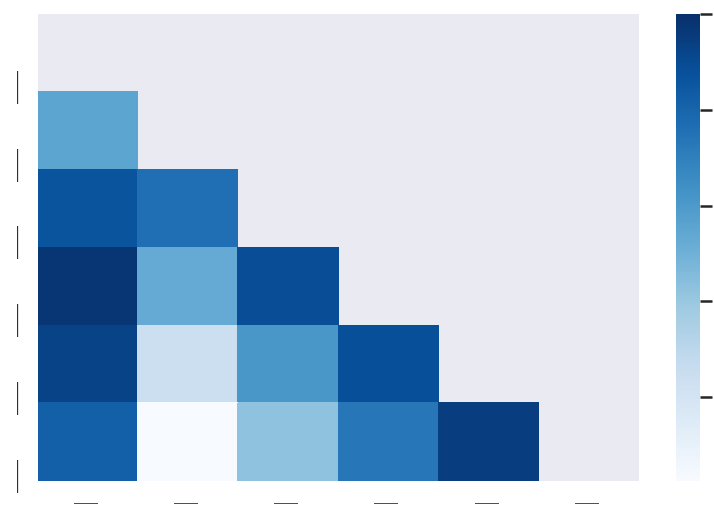

교육/학원
<전체>


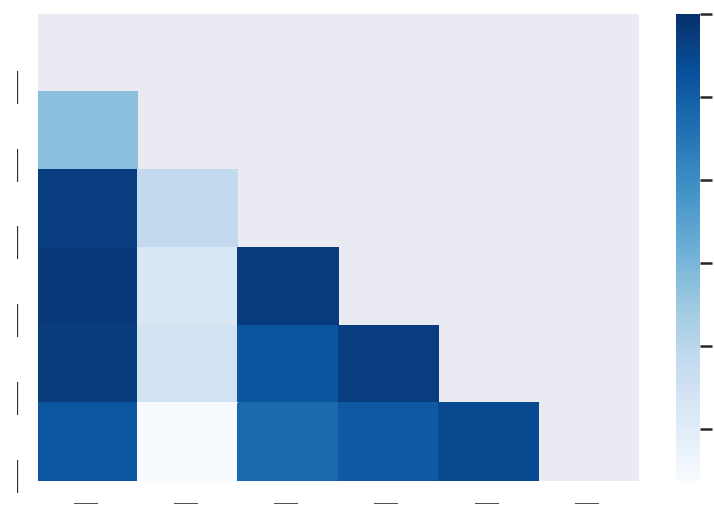

<코로나 전>


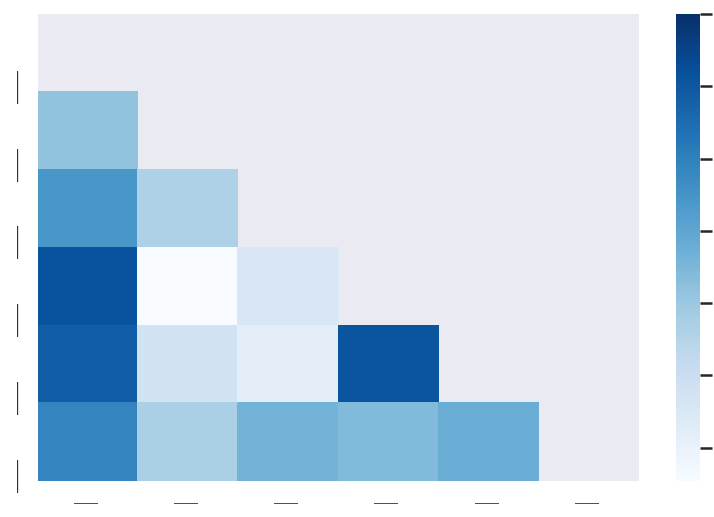

<코로나 후>


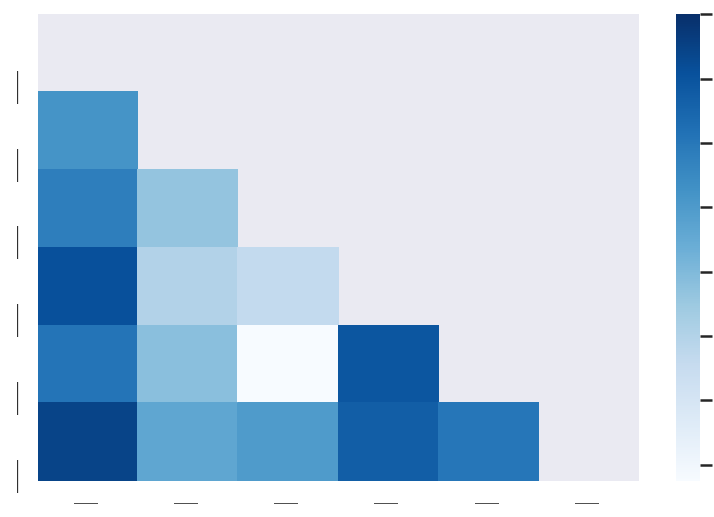

미용
<전체>


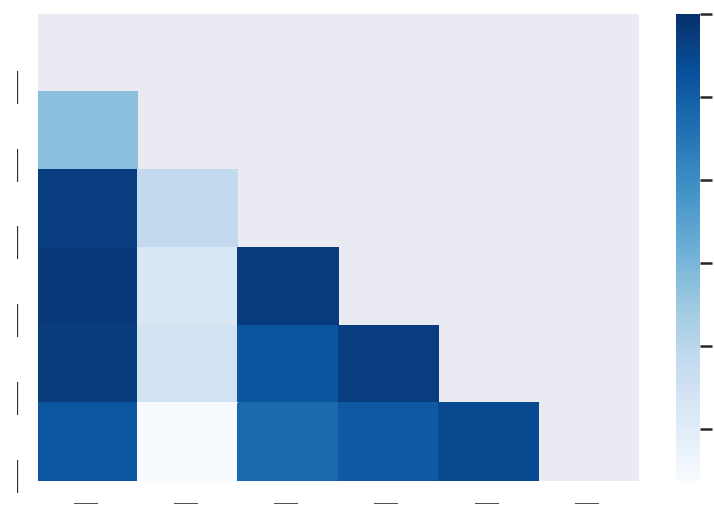

<코로나 전>


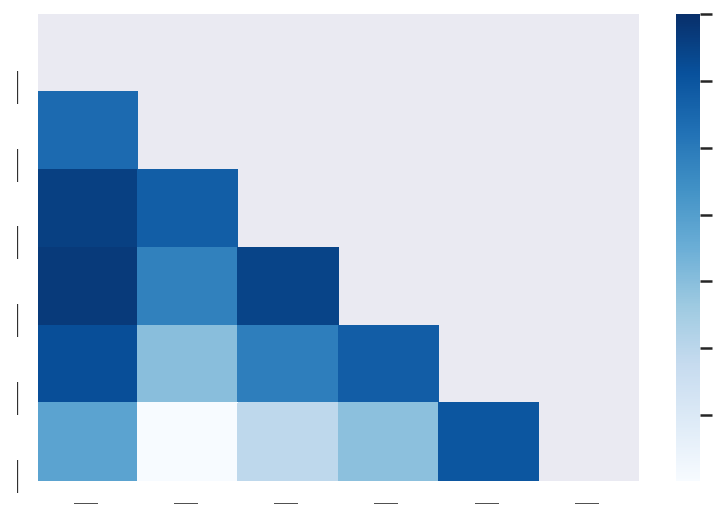

<코로나 후>


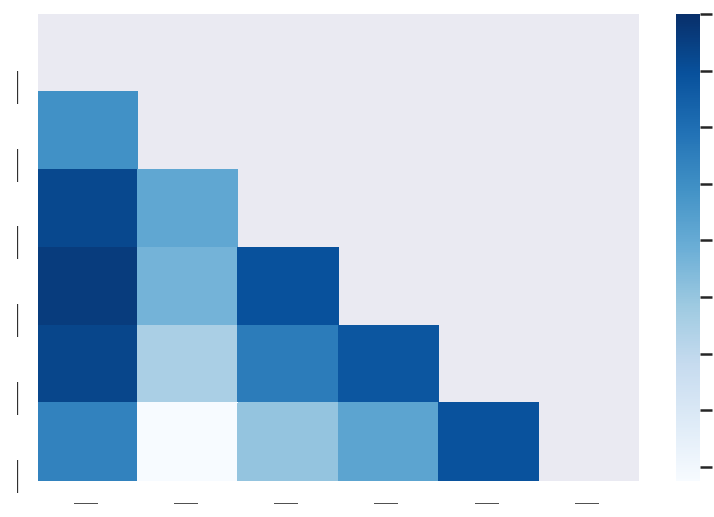

백화점/상품권/아울렛
<전체>


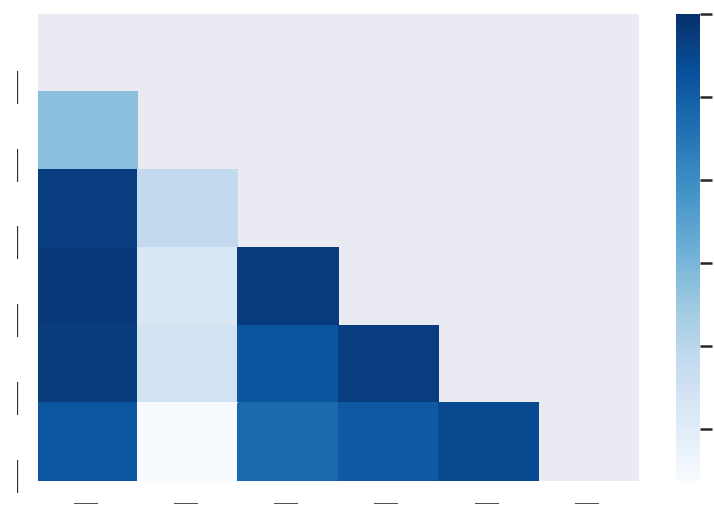

<코로나 전>


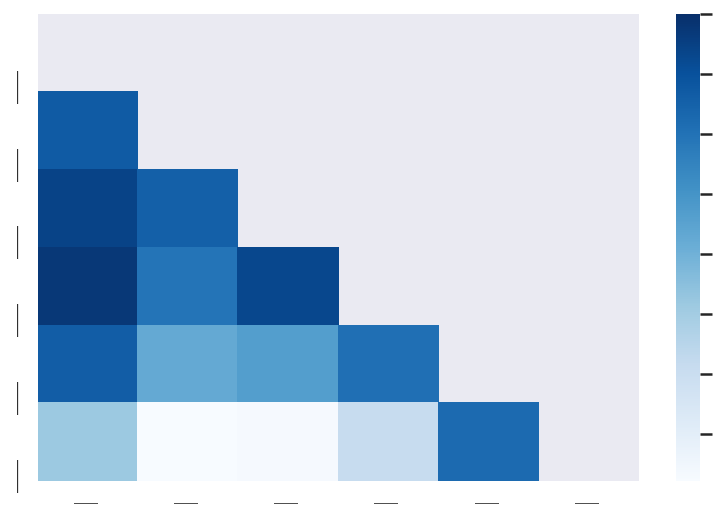

<코로나 후>


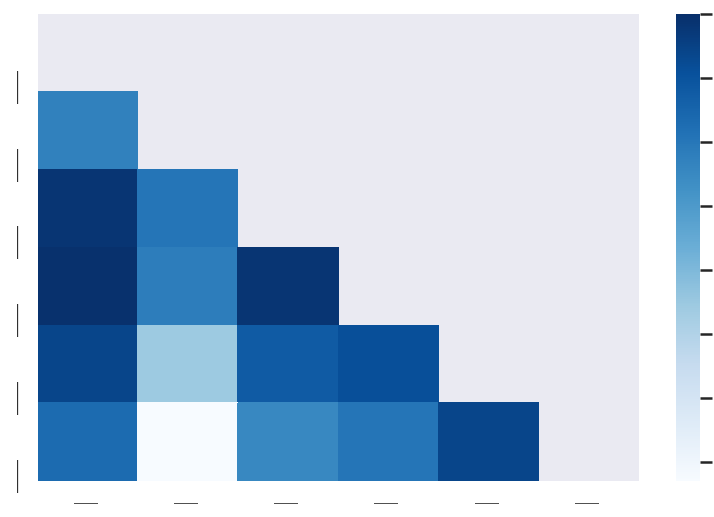

스포츠/문화/레저
<전체>


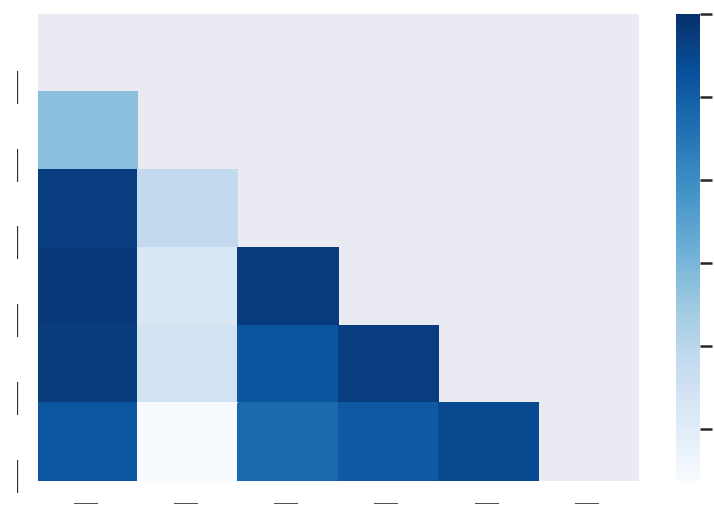

<코로나 전>


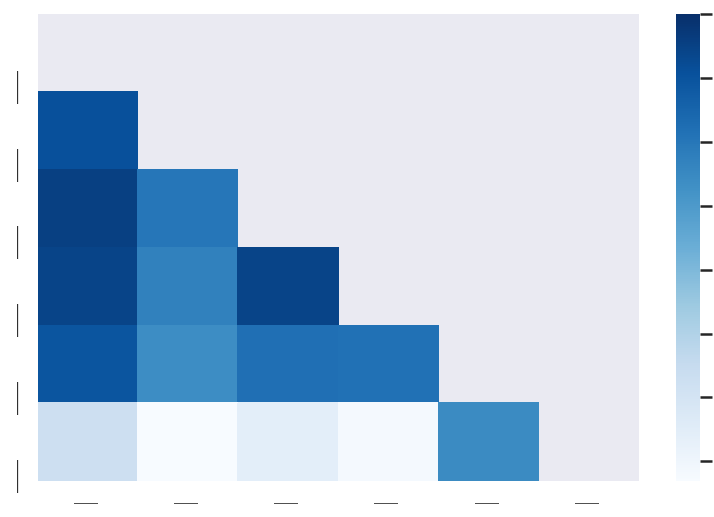

<코로나 후>


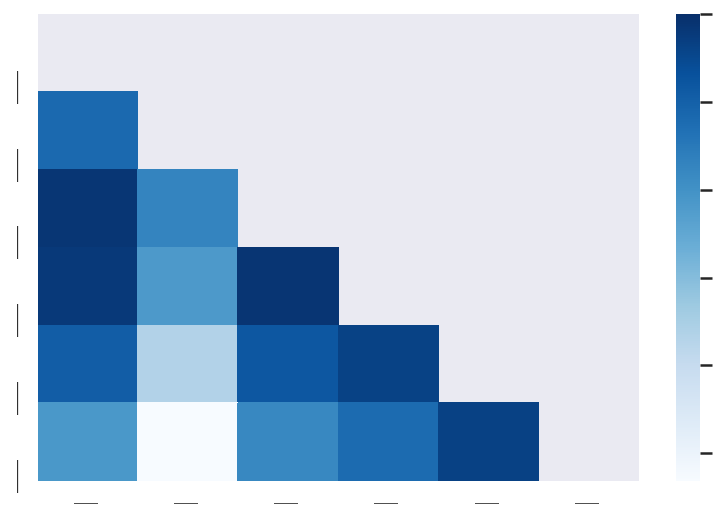

여행/교통
<전체>


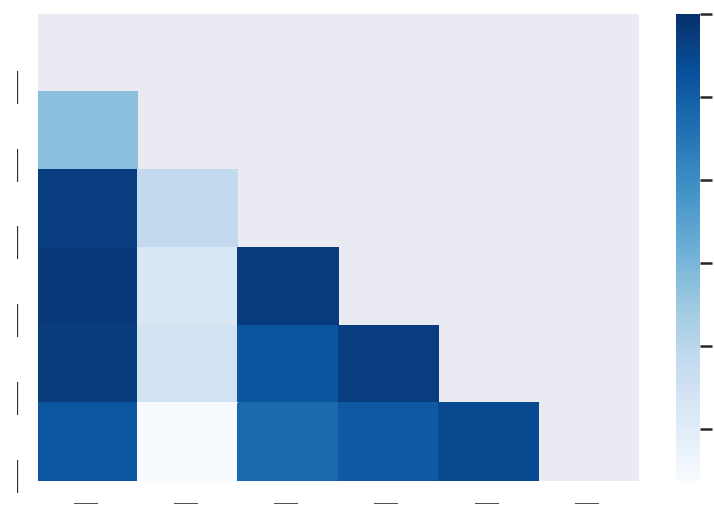

<코로나 전>


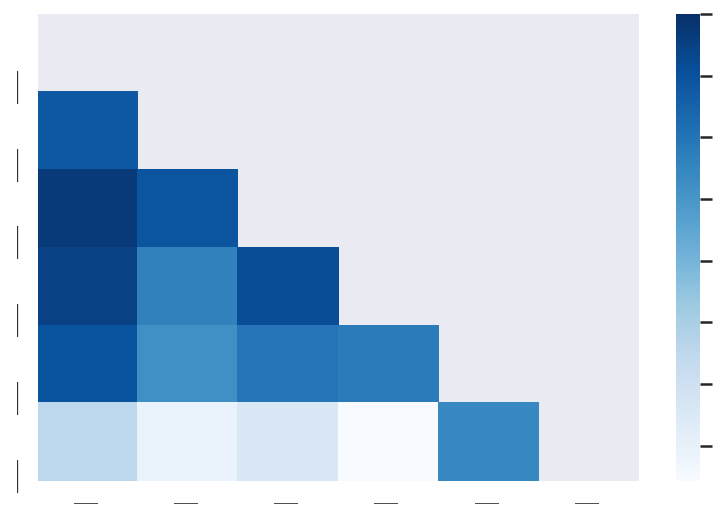

<코로나 후>


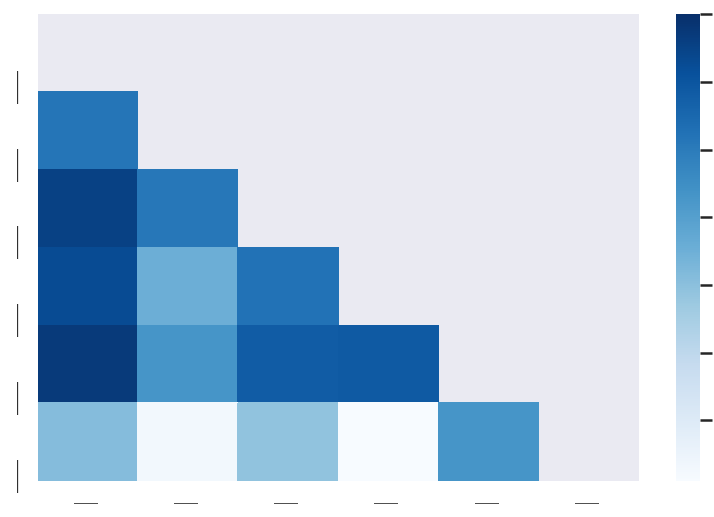

요식/유흥
<전체>


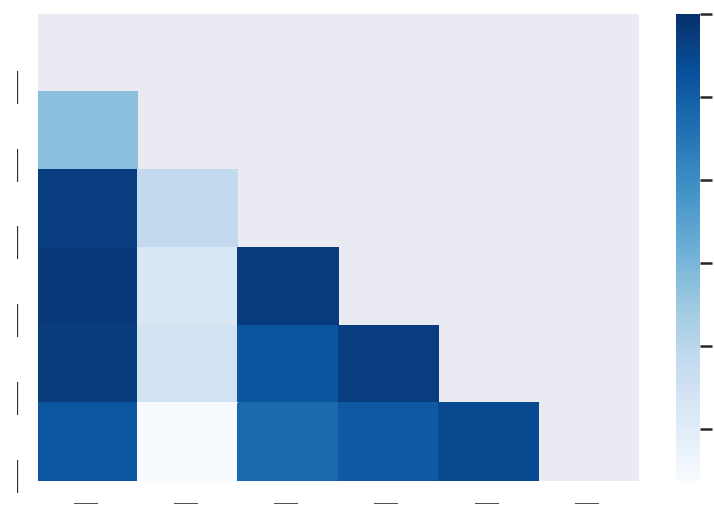

<코로나 전>


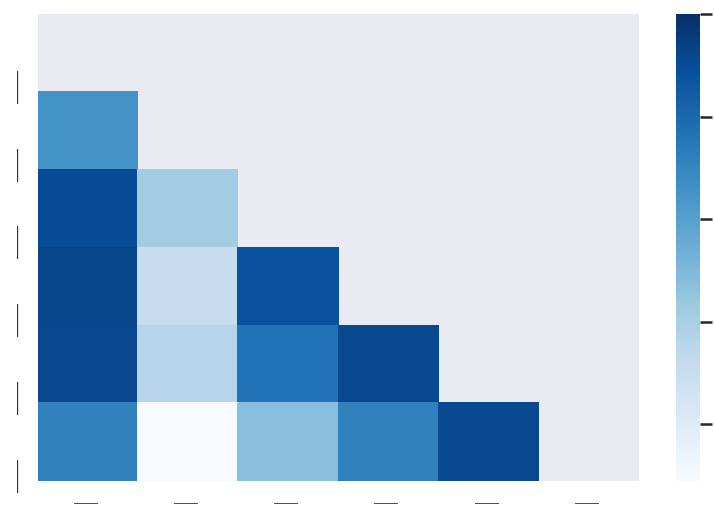

<코로나 후>


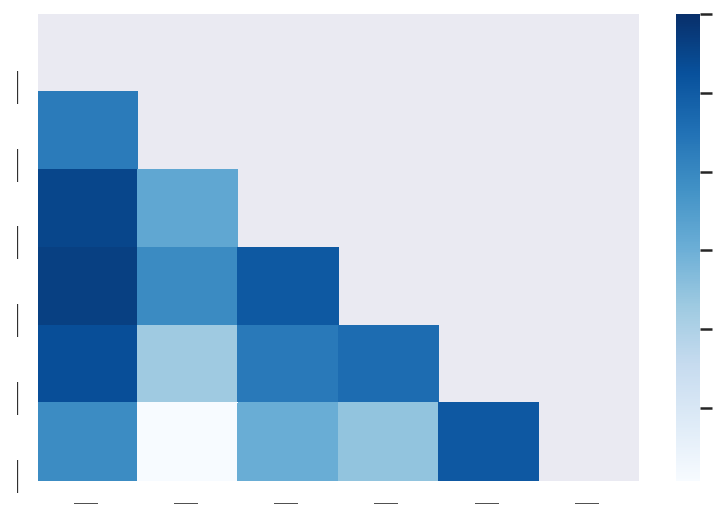

의료
<전체>


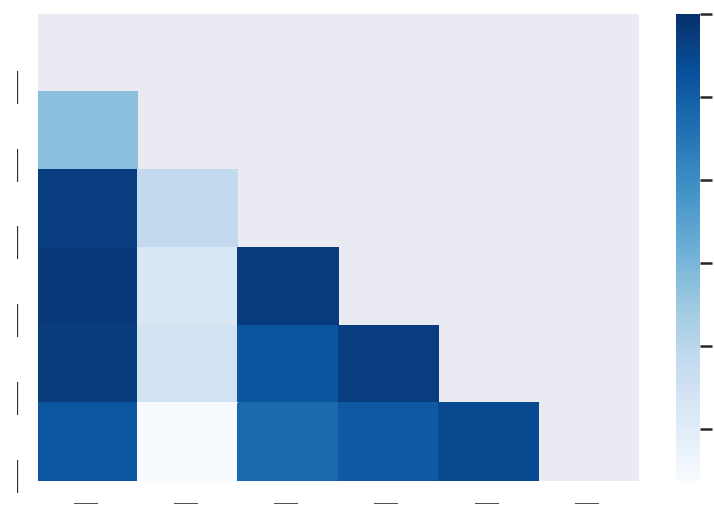

<코로나 전>


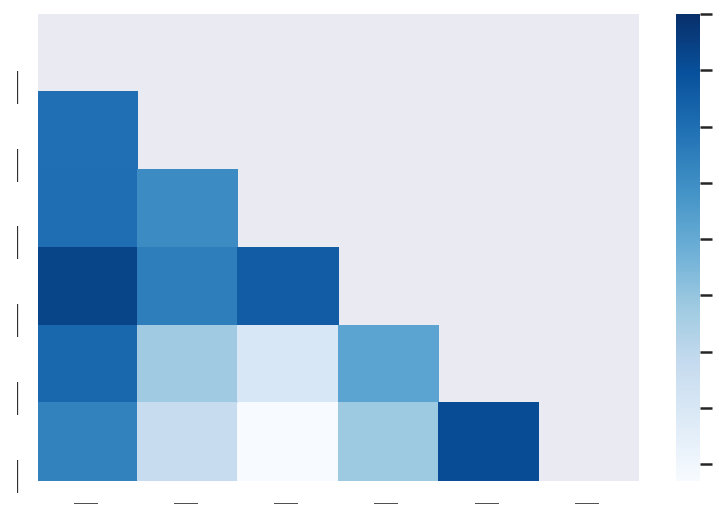

<코로나 후>


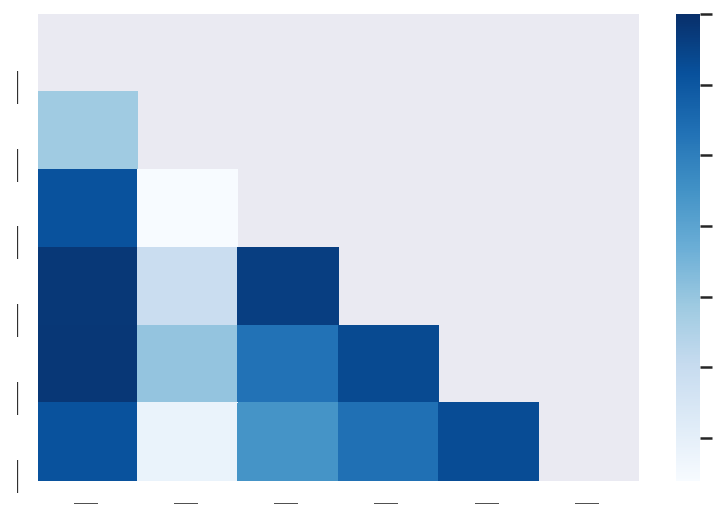

자동차
<전체>


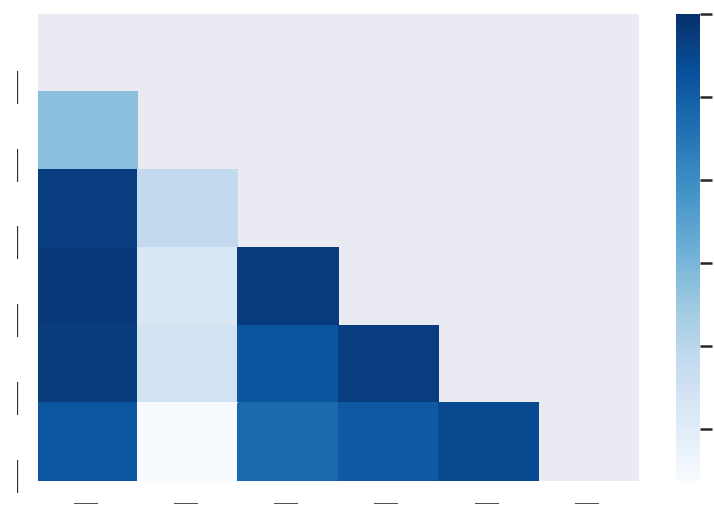

<코로나 전>


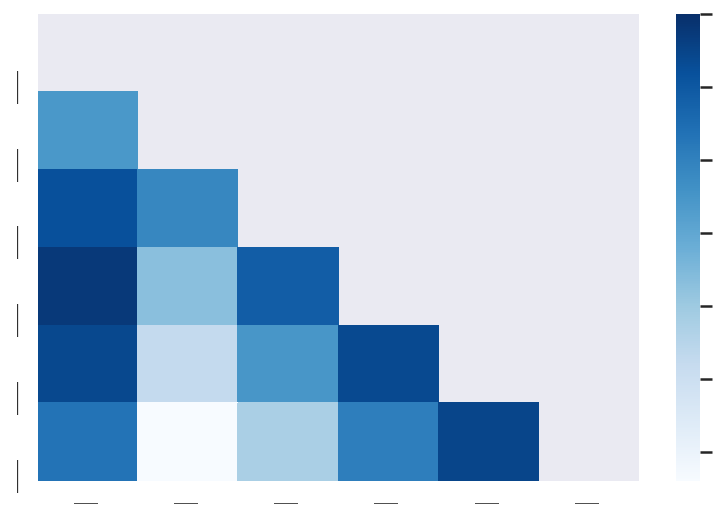

<코로나 후>


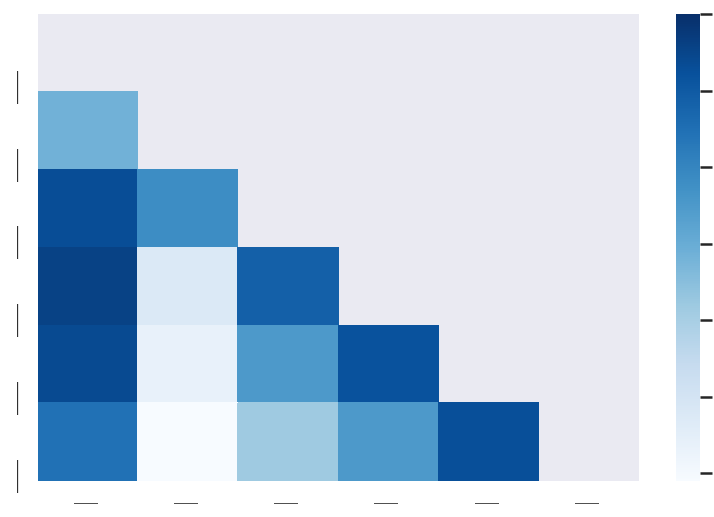

주유
<전체>


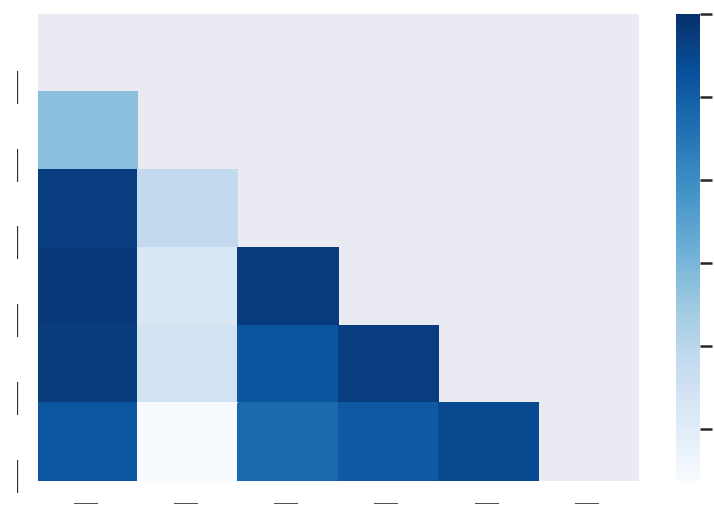

<코로나 전>


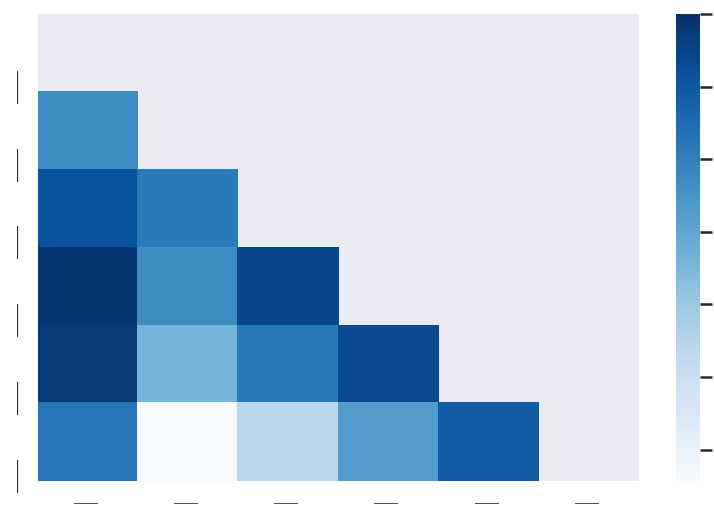

<코로나 후>


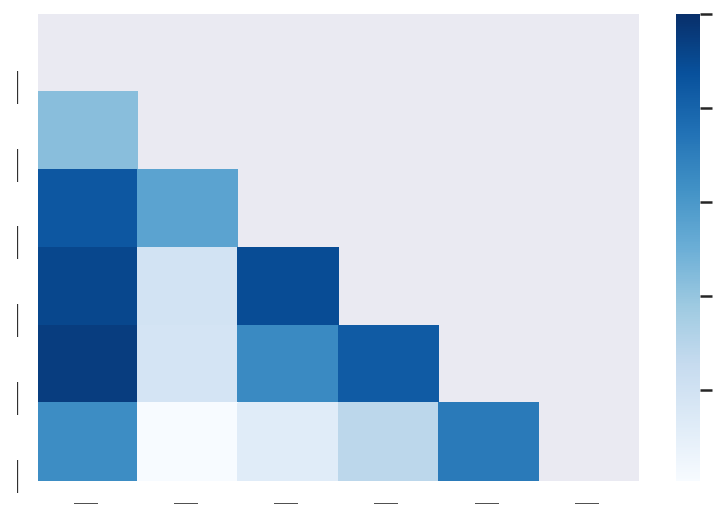

패션/잡화
<전체>


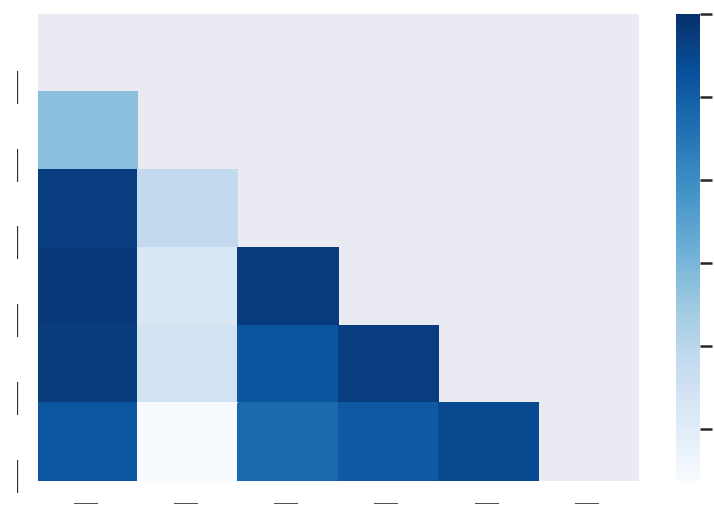

<코로나 전>


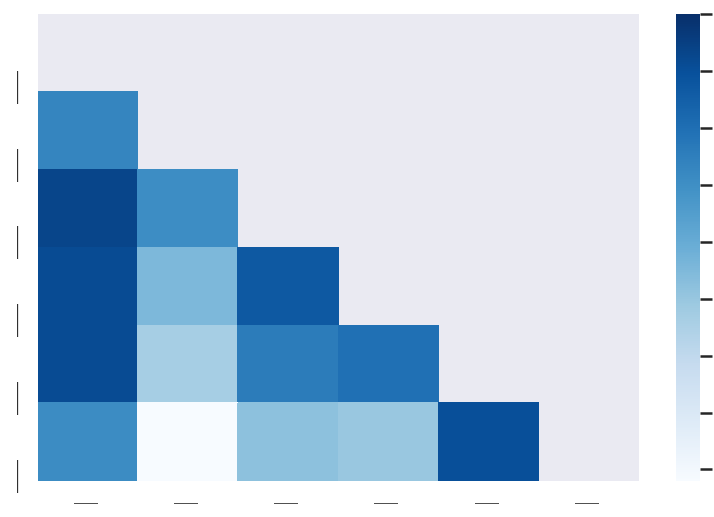

<코로나 후>


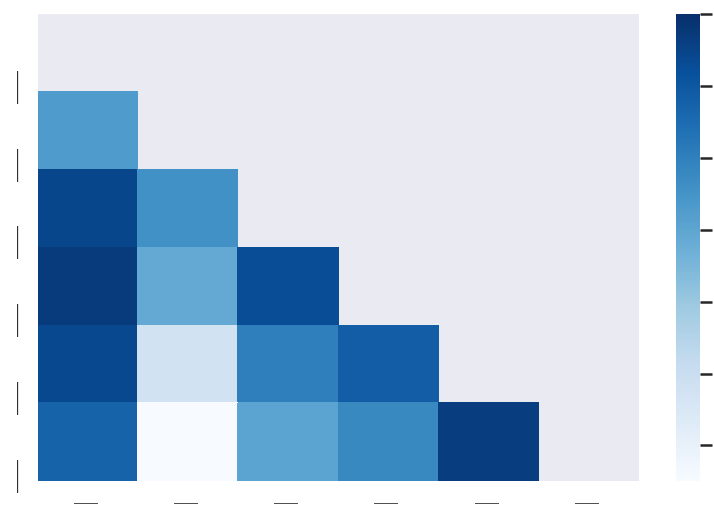

편의점
<전체>


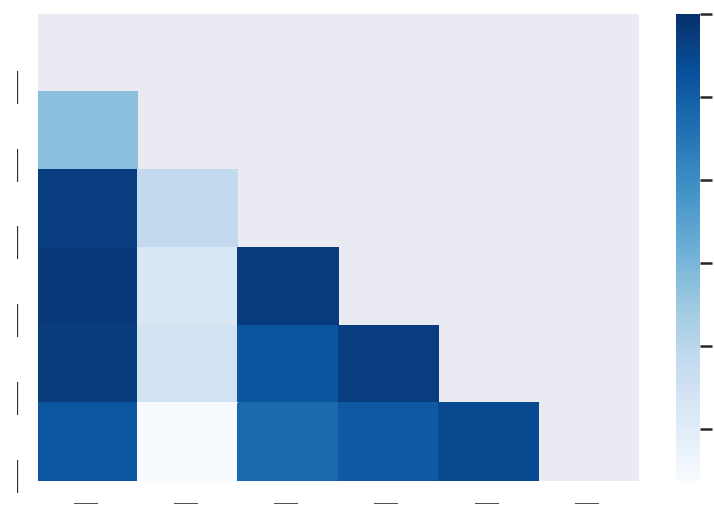

<코로나 전>


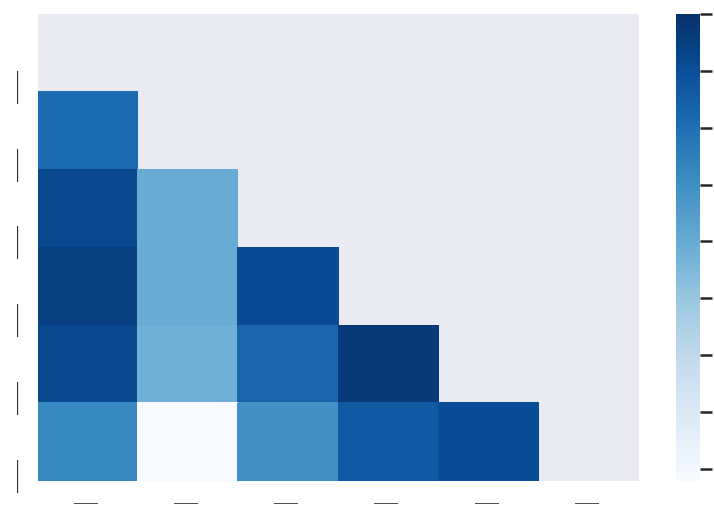

<코로나 후>


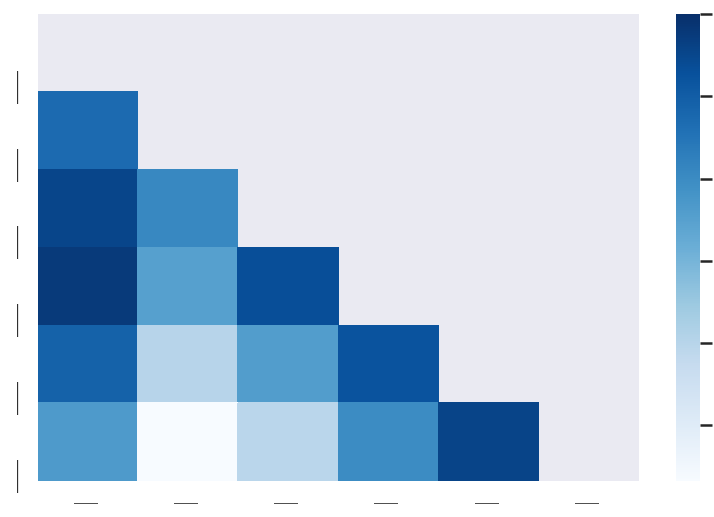

할인점/마트
<전체>


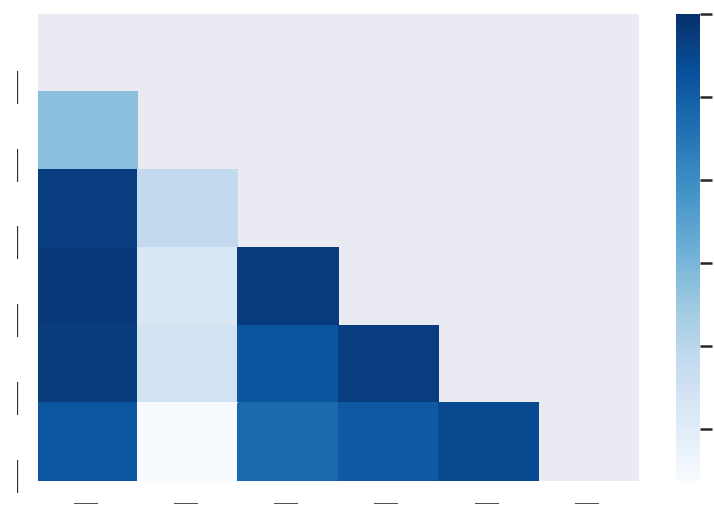

<코로나 전>


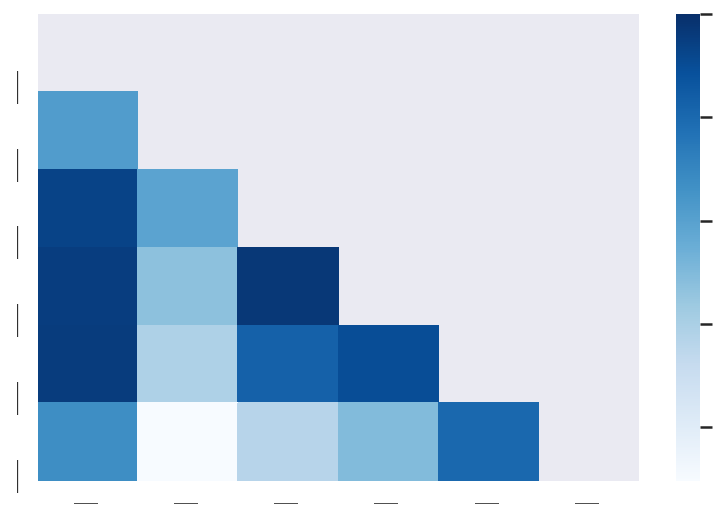

<코로나 후>


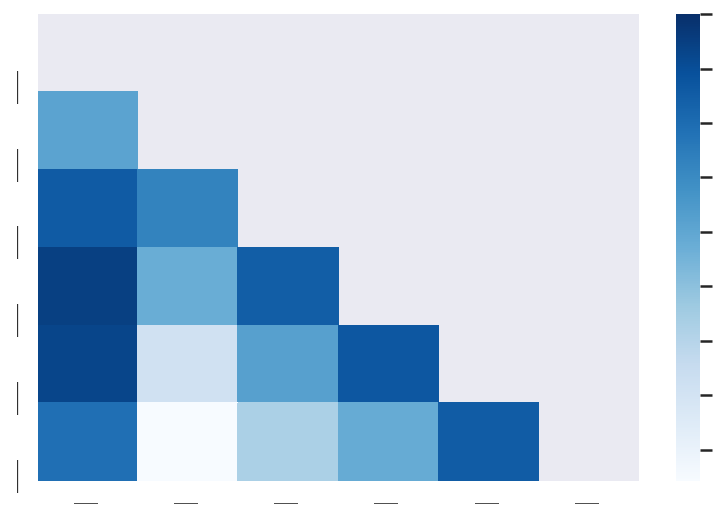

In [34]:
for i in spe_list:
    print(i)
    print('<전체>')
    corr_per_week(i)
    print('<코로나 전>')
    corr_per_week_before_corona(i)
    print('<코로나 후>')
    corr_per_week_with_corona(i)

## 전체 산업 경향

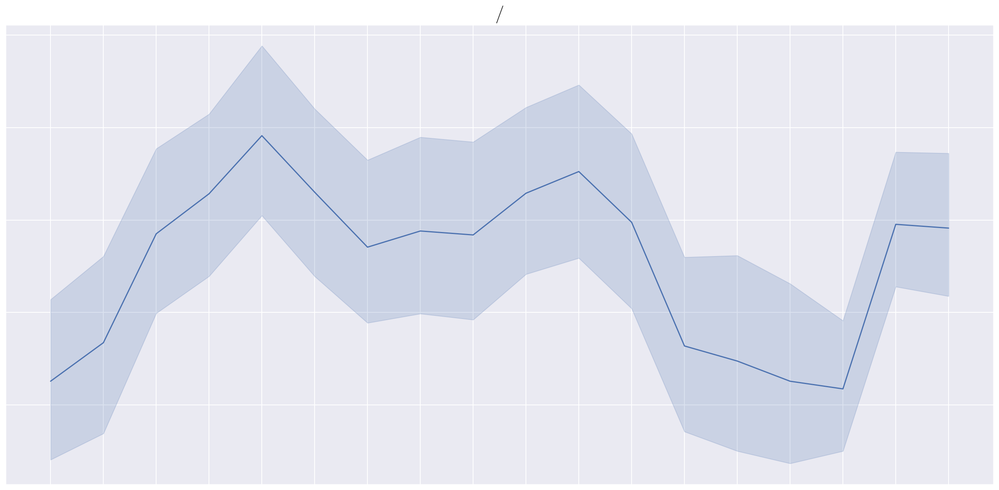

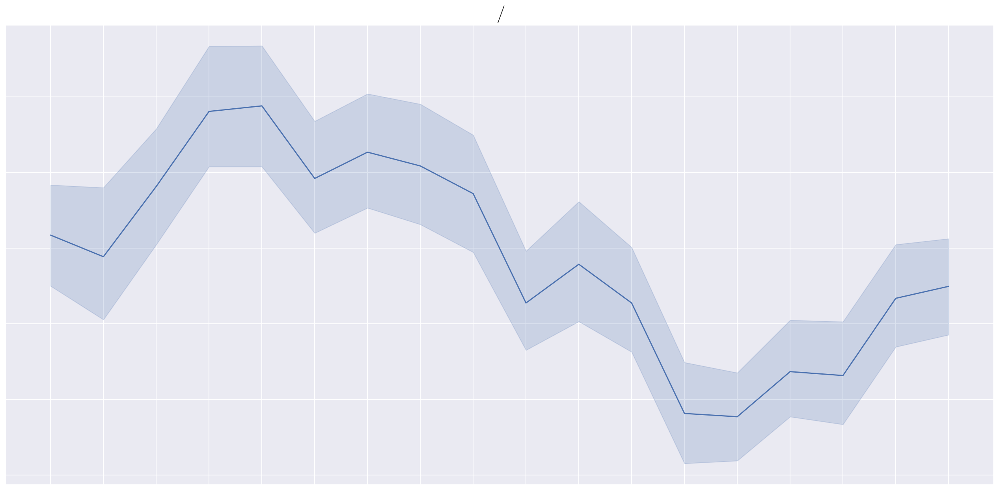

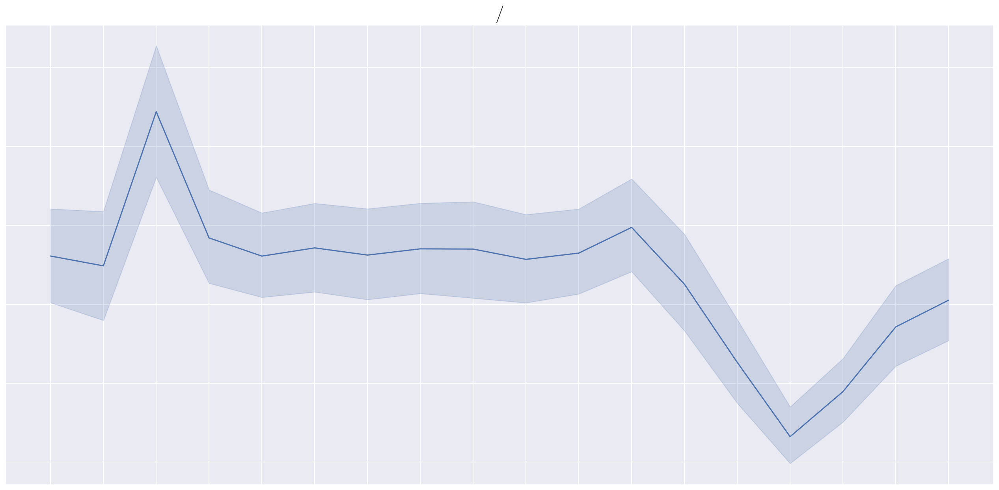

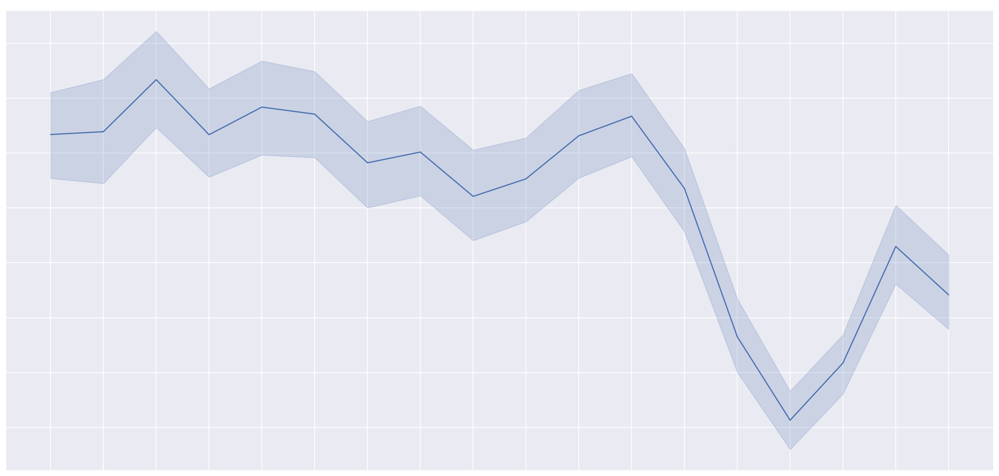

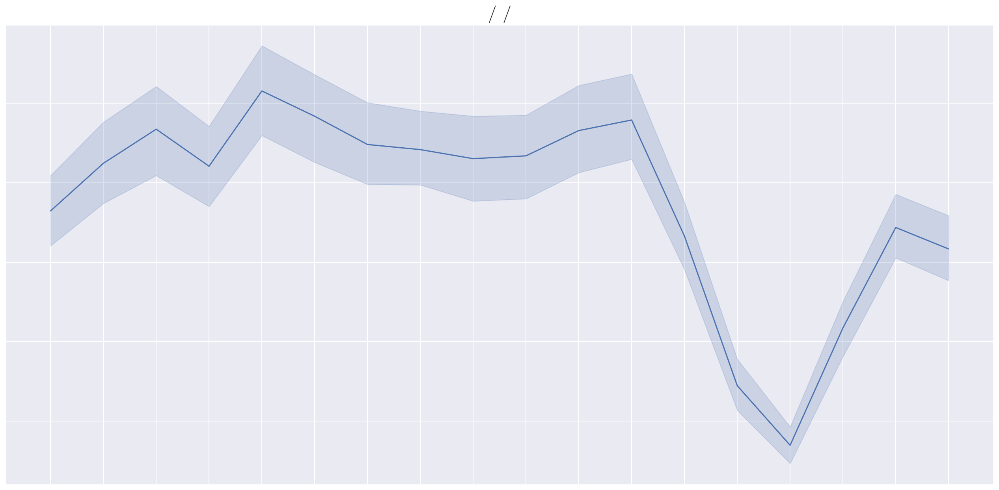

...

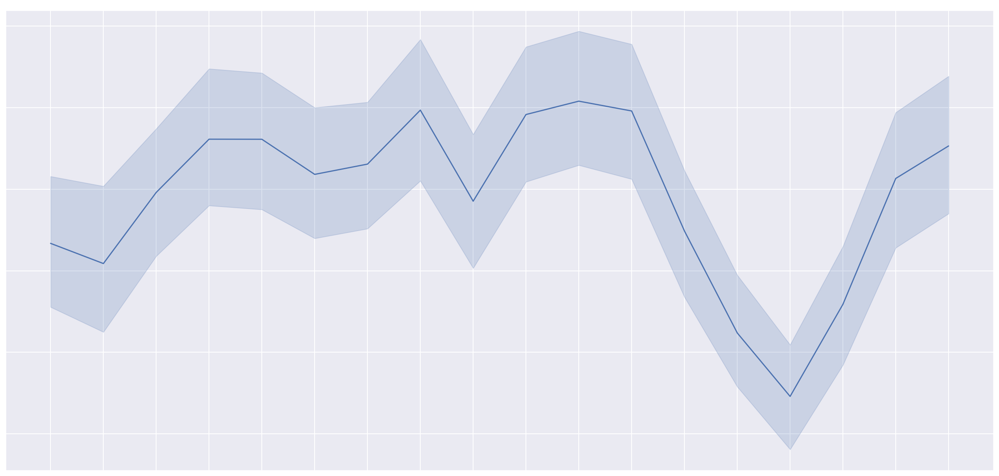

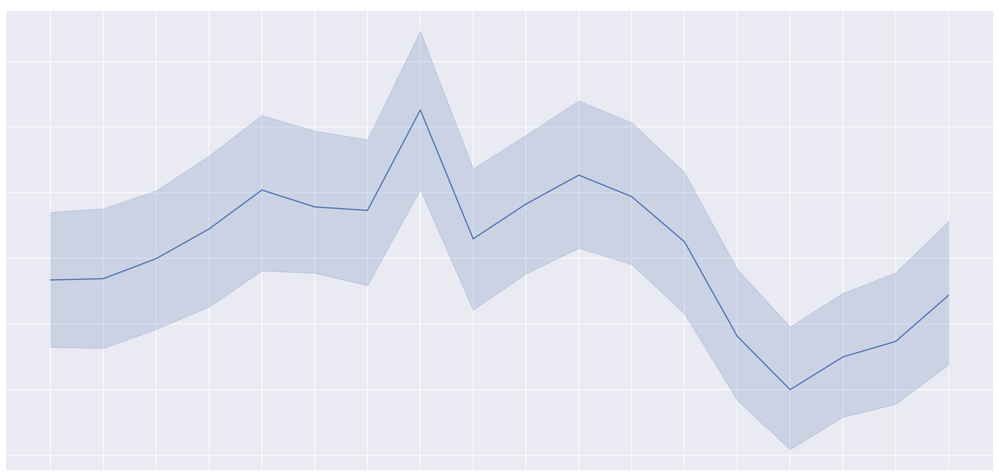

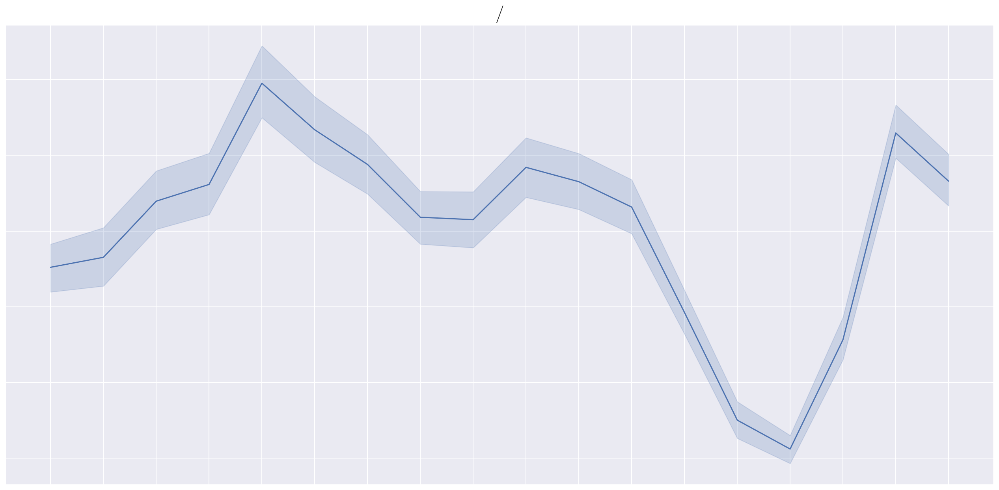

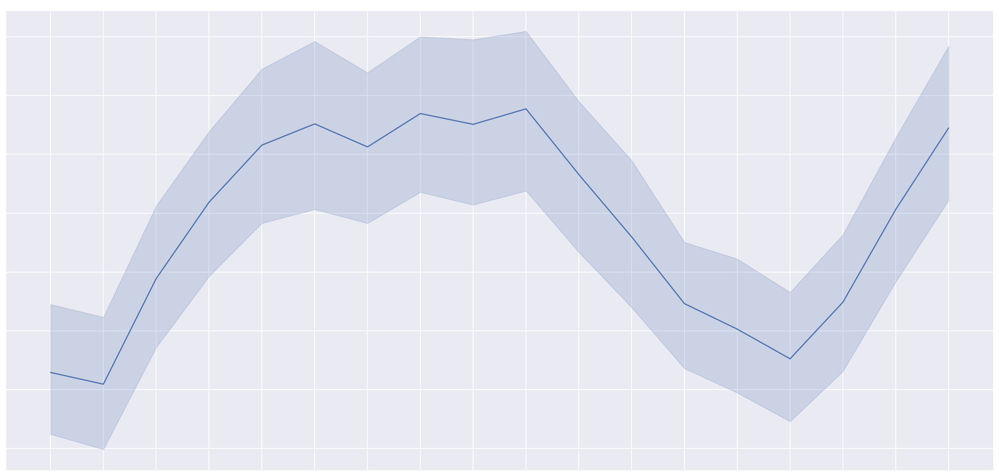

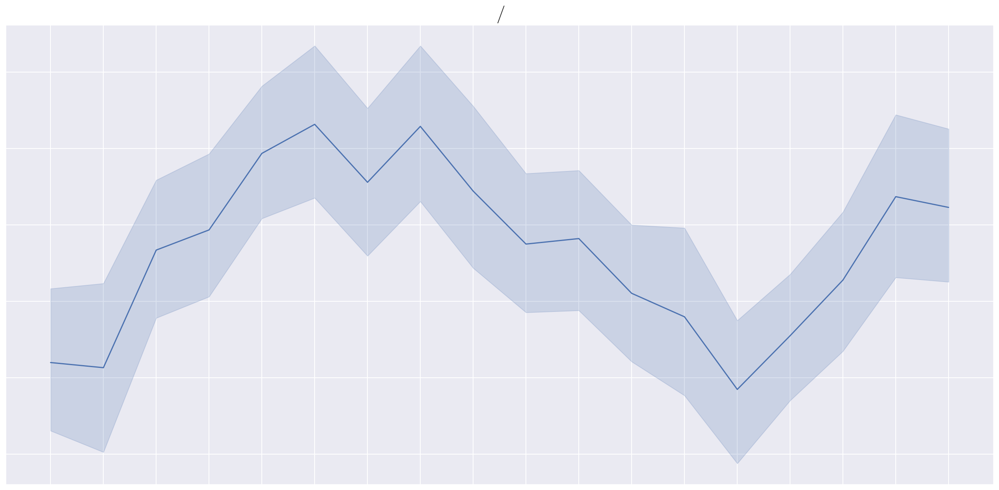

In [35]:
card=ori_card.copy()
# card data 쓰기 좋게 정리
card['소비건수']=card['소비건수(삼성)']+card['소비건수(신한)']
# card['소비일자']=pd.to_datetime(card['소비일자'].astype(str))
card=card[['소비일자','소비업종','성별','연령대','소비건수']].copy()
card.columns=['일자','업종','성별','연령','건수']

card_copy=card.copy()
n=0
for i in spe_list: 
    card_copy=card_copy[card_copy['업종']==i]
    card_copy['일자']=pd.to_datetime(card_copy['일자'].astype(str))
    card_copy['일자']= card_copy['일자'].apply(lambda x: str(x)[:7])

    plt.figure(figsize=(20,10))
    plt.title(i)
    sns.lineplot(x='일자',y='건수',data=card_copy)
    #plt.savefig('spe'+str(n)+'.png')
    plt.show()
    card_copy=card.copy()
    n+=1

# 온라인 데이터 군집화

In [36]:
for i in range(len(spe_list)):
    card['업종_'+spe_list[i]]= card['업종'].apply(lambda x: 1 if x==spe_list[i] else 0 )
    
card=card.drop(columns=['업종'])
card['일자']=card['일자'].apply(lambda x : pd.to_datetime(str(x)))
card['일자']=card['일자'].astype(np.int64)

km = KMeans(n_clusters=3, n_jobs=-1, random_state=seed)
km.fit(card)
res= km.predict(card)

 8 / 8

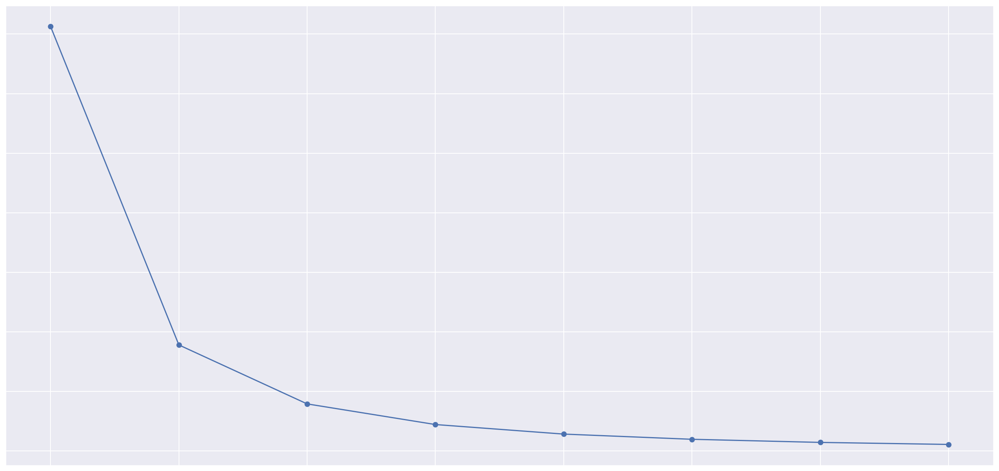

In [37]:
# 최적화 군집 갯수
seed=607
elbow(card, 8, seed=seed)

In [38]:
card_cl = [0,0,0]
for i in range(3) :
    card_cl[i]=card[res==i].copy()
    card_cl[i]['일자']=pd.to_datetime(card_cl[i]['일자'])
    card_cl[i]

# 신한카드 분석
* 소비업종이 세분화되어 있음

In [39]:
ori_Shinhancard=pd.read_excel('./sample/Shinhancard.xlsx')
ori_Shinhancard=ori_Shinhancard.drop(columns=['Unnamed: 5', 'Unnamed: 6', 'Unnamed: 7']).copy()

In [40]:
Shinhancard = ori_Shinhancard.copy()

shinhan_temp=Shinhancard[(Shinhancard['연령대별']=='60대')|(Shinhancard['연령대별']=='70대')].groupby(['일별','성별','업종']).sum().reset_index()
shinhan_temp['연령대별']='60대'
shinhan_temp=shinhan_temp[['일별','성별','연령대별','업종','카드이용건수(천건)']]

ref_Shinhancard=pd.concat([Shinhancard[Shinhancard['연령대별']<='50대'],shinhan_temp])
sh_card=ref_Shinhancard.copy()
sh_list=sh_card['업종'].unique().tolist()

sh_card.columns=['일자','성별','연령','업종','건수']
sh_card=sh_card[['일자','업종','성별','연령','건수']]

sh_card['연령']=sh_card['연령'].apply(lambda x: x[:2])
sh_card['일자']=sh_card['일자'].apply(lambda x: int(str(x)[:7]))
sh_card_gp=sh_card.groupby(['일자','업종','성별','연령']).sum().reset_index().copy()

# sh_card_gp['성별'] = sh_card_gp['성별'].apply(lambda x: 'M' if x==1 else 'F').copy()
# sh_card_gp['연령'] = sh_card_gp['연령'].apply(lambda x: str(x)+'대').copy()

sh_card_gp=sh_card_gp.groupby(['일자','업종','연령']).sum().reset_index()

sh_card_gp['건수']=np.round(sh_card_gp['건수']).astype(int)
sh_card_all=sh_card_gp.groupby(['일자','연령']).sum().reset_index()

In [41]:
for i in range(len(sh_card_all)):
    if str(sh_card_all['일자'][i])[-1]=='3':
        sh_card_all.drop(i, inplace=True)
        
for i in range(len(sh_card_gp)):
    if str(sh_card_gp['일자'][i])[-1]=='3':
        sh_card_gp.drop(i, inplace=True)
        
sh_card_all=sh_card_all.reset_index()
sh_card_gp=sh_card_gp.reset_index()

def save_corr_sh(k):
    for i in range(len(k)):
        plt.figure(figsize=(20,10))
        print(sh_list[i])
        before_sh_card_all=sh_card_all[(sh_card_all['일자']<2020010)&(sh_card_all['일자']>=2019070)]
        before_sh_card_gp=sh_card_gp[(sh_card_gp['일자']<2020010)&(sh_card_gp['일자']>=2019070)]
        all_before=before_sh_card_all[before_sh_card_all['업종']==sh_list[i]]
        all_before['건수_정규화']=score_normalize(np.array(before_sh_card_all[before_sh_card_all['업종']==sh_list[i]]['건수']).reshape(-1,1))
        for j in age_list:
            all_before[str(j)+'_정규화']=score_normalize(np.array(before_sh_card_gp[(before_sh_card_gp['연령']==j)&(before_sh_card_gp['업종']==sh_list[i])]['건수']).reshape(-1,1))
        set_all_before=all_before[['건수_정규화','20_정규화','30_정규화','40_정규화','50_정규화','60_정규화']]
        mask = np.triu(np.ones_like(set_all_before.corr(), dtype=np.bool))

        plt.subplot(1,2,1)
        plt.title(sh_list[i]+' 코로나 전')
        sns.heatmap(set_all_before.corr(), annot=True, cmap="Blues", mask=mask)

        after_sh_card_all=sh_card_all[(sh_card_all['일자']>=2020010)]
        after_sh_card_gp=sh_card_gp[(sh_card_gp['일자']>=2020010)]
        all_after=after_sh_card_all[after_sh_card_all['업종']==sh_list[i]]
        all_after['건수_정규화']=score_normalize(np.array(after_sh_card_all[after_sh_card_all['업종']==sh_list[i]]['건수']).reshape(-1,1))
        for k in age_list:
            all_after[str(k)+'_정규화']=score_normalize(np.array(after_sh_card_gp[(after_sh_card_gp['연령']==k)&(after_sh_card_gp['업종']==sh_list[i])]['건수']).reshape(-1,1))
        select_all_after=all_after[['건수_정규화','20_정규화','30_정규화','40_정규화','50_정규화','60_정규화']]
        mask = np.triu(np.ones_like(select_all_after.corr(), dtype=np.bool))

        plt.subplot(1,2,2)
        plt.title('코로나 후')
        sns.heatmap(select_all_after.corr(), annot=True, cmap="Blues", mask=mask)
        if not os.path.exists('./cor_figures/') : os.makedirs('./cor_figures/')
        plt.savefig('./cor_figures/sh_save'+sh_list[i].replace('/', '')+'.png')
        plt.show()

In [42]:
Shinhancard = ori_Shinhancard.copy()

shinhan_temp=Shinhancard[(Shinhancard['연령대별']=='60대')|(Shinhancard['연령대별']=='70대')].groupby(['일별','성별','업종']).sum().reset_index()
shinhan_temp['연령대별']='60대'
shinhan_temp=shinhan_temp[['일별','성별','연령대별','업종','카드이용건수(천건)']]

ref_Shinhancard=pd.concat([Shinhancard[Shinhancard['연령대별']<='50대'],shinhan_temp])
sh_card=ref_Shinhancard.copy()
sh_list=sh_card['업종'].unique().tolist()

sh_card.columns=['일자','성별','연령','업종','건수']
sh_card=sh_card[['일자','업종','성별','연령','건수']]

sh_card['연령']=sh_card['연령'].apply(lambda x: x[:2])
sh_card['일자']=sh_card['일자'].apply(lambda x: int(str(x)[:7]))
sh_card_gp=sh_card.groupby(['일자','업종','성별','연령']).sum().reset_index().copy()

# sh_card_gp['성별'] = sh_card_gp['성별'].apply(lambda x: 'M' if x==1 else 'F').copy()
# sh_card_gp['연령'] = sh_card_gp['연령'].apply(lambda x: str(x)+'대').copy()

sh_card_gp=sh_card_gp.groupby(['일자','업종','연령']).sum().reset_index()

sh_card_gp['건수']=np.round(sh_card_gp['건수']).astype(int)
sh_card_all=sh_card_gp.groupby(['일자','연령']).sum().reset_index()

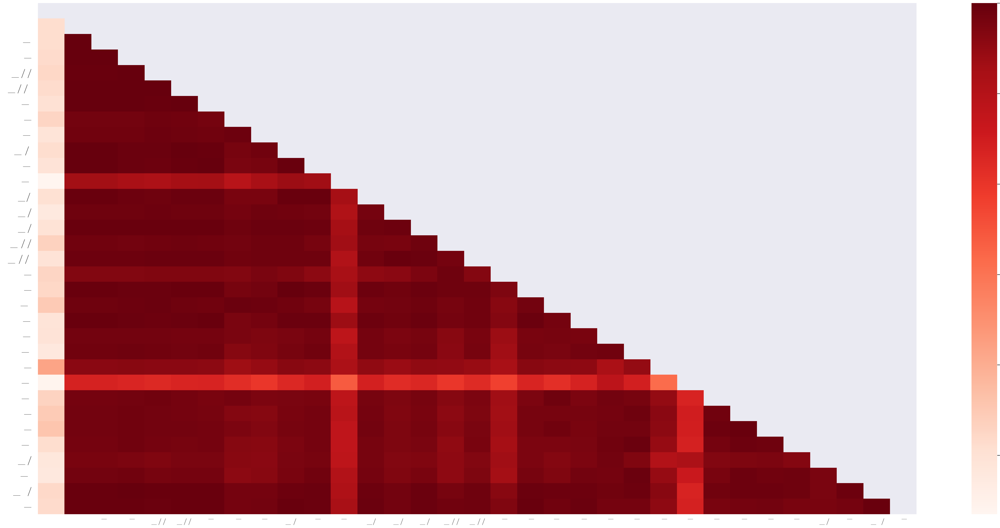

In [43]:
sh_card_all=sh_card_all.groupby(['일자']).sum().reset_index()
sh_card_all=sh_card_all[(sh_card_all['일자']>=2019070)&(sh_card_all['일자']<=2020010)]
sh_card_all['건수_정규화']=score_normalize(np.array(sh_card_all['건수']).reshape(-1,1))

sh_card=sh_card[(sh_card['일자']>=2019070)&(sh_card['일자']<=2020010)]
sh_per_spe=sh_card.groupby(['일자','업종']).sum().reset_index()

plt.figure(figsize=(40,20))
for i in sh_list:
    sh_card_all[i]=score_normalize(np.array(sh_per_spe[sh_per_spe['업종']==i]['건수']).reshape(-1,1))

mask = np.triu(np.ones_like(sh_card_all.corr(), dtype=np.bool))
sns.heatmap(sh_card_all.corr(), annot=True, cmap="Reds", mask=mask)
plt.show()

# 부동산 거래 시각화
* 데이터 전처리
* 애니메이션 생성

## 데이터 전처리

In [44]:
Gin = Gin[Gin['lgdng_cd'].apply(lambda x : False if x in [2826010400, 2826010600, 4511313900] else True)]
Gin_loc.columns = list(map(str.lower, Gin_loc.columns))
gin_origin = pd.merge(Gin.loc[:, ['lgdng_cd', 'ym', 'trd_prc', 'ldpb_prc', 'trd_cont', 'mtrnt_cont']],
                      Gin_loc.iloc[:, [1,5,6,7]],
                      how = 'left', on = 'lgdng_cd').copy()
gin_origin = gin_origin.fillna({'trd_prc' : 0,
                               'ldpb_prc' : 0,
                               'pyn_cn' : ''})
Gin_origin = gin_origin

## 애니메이션 생성
* 모듈 설치 및 함수 설정
* gif생성

In [45]:
!pip install folium
!pip install imageio
!pip install selenium
!pip install pillow

In [45]:
import folium
from folium.plugins import HeatMap
import imageio
from selenium import webdriver
from PIL import Image
from PIL import ImageDraw
from PIL import ImageFont

def folium_map_to_png(filename, dest_folder_name):
    delay = 5
    input_dir = 'file://{path}/{dirname}/{mapfile}'.format(path=os.getcwd(),dirname="maps",mapfile=filename)
    browser = webdriver.Chrome(executable_path=os.path.abspath("chromedriver"))
    browser.get(input_dir)
    time.sleep(delay)
    curr_dir = os.getcwd()
    src_folder = curr_dir + dest_folder_name
    if not os.path.exists(src_folder):
        os.mkdir(src_folder)
    pic = src_folder + filename.split(".")[0] + ".png"
    browser.save_screenshot(pic)
    browser.quit()
    
def create_gif(filenames, duration):
    filenames = list(map(lambda x : os.getcwd() + '/new_pngs/' + str(x) + '.png', filenames))
    images = []
    for filename in filenames:
        images.append(imageio.imread(filename))
    output_file = 'Maps.gif'
    imageio.mimsave(output_file, images, duration=duration)

In [49]:
center = [36,127.5]
ymlist = sorted(Gin_origin['ym'].unique().tolist())
ymlist = [i for i in ymlist if i > 201900]
selectedFont = ImageFont.truetype(font_path, 80)

for y in ymlist :
    m = folium.Map(location=center, zoom_start=8, tiles = 'Cartodb Positron')

    temp = Gin_origin[Gin_origin['ym'] == y].copy()

    la = temp['la'].tolist()
    lngt = temp['lngt'].tolist()
    cnt = list(map(lambda x : int(x/1000), temp['trd_cont'].tolist()))
    temp_list = []

    for i in range(len(temp)) : 
        temp_list += cnt[i] * [[la[i], lngt[i]]]
    HeatMap(temp_list).add_to(m)
    if not os.path.exists('./maps') : os.makedirs('./maps')
    m.save('maps/' + str(y) + '.html')
    
#png 변환의 경우 드라이버 권한이 부족한 관계로 실행 실패    
    
    
    folium_map_to_png(str(y) + '.html', '/pngs/')
    
    target_image=Image.open("./pngs/" + str(y) + ".png")
    draw = ImageDraw.Draw(target_image)
    draw.text((0, 0), str(y), fill="black", font=selectedFont, align='center')
    if not os.path.exists('./new_pngs/') : os.makedirs('./new_pngs/')
    target_image.convert('RGB').save('./new_pngs/' + str(y) + '.png')
    
create_gif(ymlist, 0.75)